In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MultipleLocator

import torch
import torch.nn as nn
import torch.nn.functional as Fa
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [ ]:
predictions_2021 = np.load('evaluation_results/predictions.npy')
actuals_2021 = np.load('evaluation_results/targets.npy')


predictions_2020 = np.load('evaluation_results/predictions_2020.npy')
actuals_2020 = np.load('evaluation_results/targets_2020.npy')


import joblib

pm25_scaler = joblib.load("pm25_scaler.pkl")

def unscale_pm25(pred_scaled, scaler):
    samples, horizons, stations = pred_scaled.shape
    pred_flat = pred_scaled.reshape(-1, 1)  # Shape: (samples * horizons * stations, 1)
    pred_unscaled_flat = scaler.inverse_transform(pred_flat)
    return pred_unscaled_flat.reshape(samples, horizons, stations)

predictions_2021 = unscale_pm25(predictions_2021, pm25_scaler)
predictions_2020 = unscale_pm25(predictions_2020, pm25_scaler)
actuals_2021 = unscale_pm25(actuals_2021, pm25_scaler)
actuals_2020 = unscale_pm25(actuals_2020, pm25_scaler)

print(f'Prediction shape is {predictions_2021.shape} and Traget shape is {actuals_2021.shape}')
print(f'Prediction shape is {predictions_2020.shape} and Traget shape is {actuals_2020.shape}')
predictions_agatnet = np.load('evaluation_results/predictions_agatnet.npy')
actuals_agatnet = np.load('evaluation_results/targets_agatnet.npy')

stations_to_keep = np.load('stations_to_keep.npy', allow_pickle=True)

predictions_agatnet = predictions_agatnet[:, stations_to_keep]
actuals_agatnet = actuals_agatnet[:, stations_to_keep]
print(f'AGATNet Prediction shape is {predictions_agatnet.shape}\nAGATNet Actual shape is {actuals_agatnet.shape}')

/pscratch/sd/r/rdimri/conda_envs/gnn_env/lib/python3.11/site-packages/sklearn/base.py:380: InconsistentVersionWarning: Trying to unpickle estimator StandardScaler from version 1.5.2 when using version 1.6.0. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Prediction shape is (8676, 72, 170) and Traget shape is (8676, 72, 170)
Prediction shape is (8664, 72, 170) and Traget shape is (8664, 72, 170)
AGATNet Prediction shape is (8664, 170, 72)
AGATNet Actual shape is (8664, 170, 72)


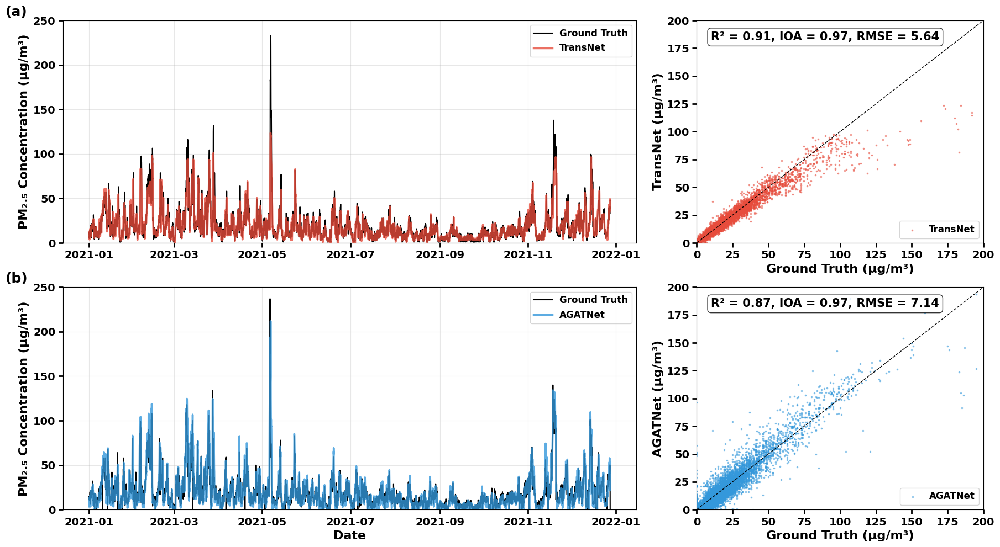

TransNet Metrics:
R² = 0.912
IOA = 0.974
RMSE = 5.64

AGATNet Metrics:
R² = 0.865
IOA = 0.968
RMSE = 7.14


In [21]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from datetime import datetime, timedelta
import pandas as pd

# Assuming the data is already loaded as provided
# predictions_2021, actuals_2021 for TransNet
# predictions_agatnet, actuals_agatnet for AGATNet

def calculate_ioa(observed, predicted):
    """Calculate Index of Agreement (IOA)"""
    observed_mean = np.mean(observed)
    numerator = np.sum((observed - predicted) ** 2)
    denominator = np.sum((np.abs(predicted - observed_mean) + np.abs(observed - observed_mean)) ** 2)
    return 1 - (numerator / denominator) if denominator != 0 else 0

def create_forecast_comparison_plot():
    # Adjust AGATNet data shape to match TransNet format
    # AGATNet: (8664, 170, 72) -> (8664, 72, 170)
    predictions_agatnet_adj = predictions_agatnet.transpose(0, 2, 1)
    actuals_agatnet_adj = actuals_agatnet.transpose(0, 2, 1)
    
    # Use the overlapping time period (8664 samples)
    predictions_transnet = predictions_2021[:8664]
    actuals_transnet = actuals_2021[:8664]
    
    # Select a specific station (e.g., station 0 for Seoul) and horizon (e.g., +1h = horizon 0)
    station_idx = 10  # Adjust this based on which station represents Seoul
    horizon_idx = 0  # +1h forecast
    
    # Extract time series for the specific station and horizon
    transnet_pred_ts = predictions_transnet[:, horizon_idx, station_idx]
    transnet_actual_ts = actuals_transnet[:, horizon_idx, station_idx]
    agatnet_pred_ts = predictions_agatnet_adj[:, horizon_idx, station_idx]
    agatnet_actual_ts = actuals_agatnet_adj[:, horizon_idx, station_idx]
    
    # Create time axis (assuming daily data for 2021)
    start_date = datetime(2021, 1, 1)
    dates = [start_date + timedelta(hours=i) for i in range(len(transnet_actual_ts))]
    
    # For scatter plots, use all data points (flattened)
    transnet_pred_scatter = transnet_pred_ts.flatten()
    transnet_actual_scatter = transnet_actual_ts.flatten()
    agatnet_pred_scatter = agatnet_pred_ts.flatten()
    agatnet_actual_scatter = agatnet_actual_ts.flatten()
    
    # Calculate metrics for TransNet
    r2_transnet = r2_score(transnet_actual_scatter, transnet_pred_scatter)
    ioa_transnet = calculate_ioa(transnet_actual_scatter, transnet_pred_scatter)
    rmse_transnet = np.sqrt(mean_squared_error(transnet_actual_scatter, transnet_pred_scatter))
    
    # Calculate metrics for AGATNet
    r2_agatnet = r2_score(agatnet_actual_scatter, agatnet_pred_scatter)
    ioa_agatnet = calculate_ioa(agatnet_actual_scatter, agatnet_pred_scatter)
    rmse_agatnet = np.sqrt(mean_squared_error(agatnet_actual_scatter, agatnet_pred_scatter))
    
    # Create the plot with elongated time series plots
    fig, axes = plt.subplots(2, 2, figsize=(18, 10), gridspec_kw={'width_ratios': [2, 1]})
    # fig.suptitle('Seoul +1h Forecast', fontsize=16, fontweight='bold')
    
    # TransNet time series (top left)
    axes[0, 0].plot(dates, transnet_actual_ts, 'k-', label='Ground Truth', linewidth=1.5)
    axes[0, 0].plot(dates, transnet_pred_ts, '#e74c3c', label='TransNet', linewidth=2.5, alpha=0.8)
    axes[0, 0].set_ylabel('PM₂.₅ Concentration (μg/m³)', fontsize=16, fontweight='bold')
    axes[0, 0].set_ylim(0, 250)
    axes[0, 0].legend(loc='upper right', prop={'weight': 'bold', 'size': 12})
    axes[0, 0].tick_params(axis='both', which='major', labelsize=14, width=2, length=6)
    axes[0, 0].grid(True, alpha=0.3)
    axes[0, 0].text(-0.1, 1.02, '(a)', transform=axes[0, 0].transAxes, fontsize=18, fontweight='bold')
    
    # Make tick labels bold for top left
    for label in axes[0, 0].get_xticklabels():
        label.set_fontweight('bold')
    for label in axes[0, 0].get_yticklabels():
        label.set_fontweight('bold')
    
    # TransNet scatter plot (top right)
    axes[0, 1].scatter(transnet_actual_scatter, transnet_pred_scatter, 
                      c='#e74c3c', alpha=0.5, s=2.5, label='TransNet')
    axes[0, 1].plot([0, 200], [0, 200], 'k--', linewidth=1)
    axes[0, 1].set_xlim(0, 200)
    axes[0, 1].set_ylim(0, 200)
    axes[0, 1].set_xlabel('Ground Truth (μg/m³)', fontsize=16, fontweight='bold')
    axes[0, 1].set_ylabel('TransNet (μg/m³)', fontsize=16, fontweight='bold')
    axes[0, 1].legend(loc='lower right', prop={'weight': 'bold', 'size': 12})
    axes[0, 1].tick_params(axis='both', which='major', labelsize=14, width=2, length=6)
    axes[0, 1].text(0.05, 0.95, f'R² = {r2_transnet:.2f}, IOA = {ioa_transnet:.2f}, RMSE = {rmse_transnet:.2f}',
                   transform=axes[0, 1].transAxes, fontsize=15, fontweight='bold', verticalalignment='top',
                   bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
    
    # Make tick labels bold for top right
    for label in axes[0, 1].get_xticklabels():
        label.set_fontweight('bold')
    for label in axes[0, 1].get_yticklabels():
        label.set_fontweight('bold')
    
    # AGATNet time series (bottom left)
    axes[1, 0].plot(dates, agatnet_actual_ts, 'k-', label='Ground Truth', linewidth=1.5)
    axes[1, 0].plot(dates, agatnet_pred_ts, '#3498db', label='AGATNet', linewidth=2.5, alpha=0.8)
    axes[1, 0].set_xlabel('Date', fontsize=16, fontweight='bold')
    axes[1, 0].set_ylabel('PM₂.₅ Concentration (μg/m³)', fontsize=16, fontweight='bold')
    axes[1, 0].set_ylim(0, 250)
    axes[1, 0].legend(loc='upper right', prop={'weight': 'bold', 'size': 12})
    axes[1, 0].tick_params(axis='both', which='major', labelsize=14, width=2, length=6)
    axes[1, 0].grid(True, alpha=0.3)
    axes[1, 0].text(-0.1, 1.02, '(b)', transform=axes[1, 0].transAxes, fontsize=18, fontweight='bold')
    
    # Make tick labels bold for bottom left
    for label in axes[1, 0].get_xticklabels():
        label.set_fontweight('bold')
    for label in axes[1, 0].get_yticklabels():
        label.set_fontweight('bold')
    
    # AGATNet scatter plot (bottom right)
    axes[1, 1].scatter(agatnet_actual_scatter, agatnet_pred_scatter, 
                      c='#3498db', alpha=0.5, s=2.5, label='AGATNet')
    axes[1, 1].plot([0, 200], [0, 200], 'k--', linewidth=1)
    axes[1, 1].set_xlim(0, 200)
    axes[1, 1].set_ylim(0, 200)
    axes[1, 1].set_xlabel('Ground Truth (μg/m³)', fontsize=16, fontweight='bold')
    axes[1, 1].set_ylabel('AGATNet (μg/m³)', fontsize=16, fontweight='bold')
    axes[1, 1].legend(loc='lower right', prop={'weight': 'bold', 'size': 12})
    axes[1, 1].tick_params(axis='both', which='major', labelsize=14, width=2, length=6)
    axes[1, 1].text(0.05, 0.95, f'R² = {r2_agatnet:.2f}, IOA = {ioa_agatnet:.2f}, RMSE = {rmse_agatnet:.2f}',
                   transform=axes[1, 1].transAxes, fontsize=15, fontweight='bold', verticalalignment='top',
                   bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
    
    # Make tick labels bold for bottom right
    for label in axes[1, 1].get_xticklabels():
        label.set_fontweight('bold')
    for label in axes[1, 1].get_yticklabels():
        label.set_fontweight('bold')
    
    plt.tight_layout()
    plt.savefig('Seoul_extreme_event.png', dpi=600, bbox_inches='tight', facecolor='white', edgecolor='none')
    plt.show()
    
    # Print metrics
    print("TransNet Metrics:")
    print(f"R² = {r2_transnet:.3f}")
    print(f"IOA = {ioa_transnet:.3f}")
    print(f"RMSE = {rmse_transnet:.2f}")
    print()
    print("AGATNet Metrics:")
    print(f"R² = {r2_agatnet:.3f}")
    print(f"IOA = {ioa_agatnet:.3f}")
    print(f"RMSE = {rmse_agatnet:.2f}")
    
create_forecast_comparison_plot()

Station coordinates loaded - Lats: (170,), Lons: (170,)
Using 8664 samples for comparison
Final shapes - TiGNN: (8664, 72, 170), AGATNet: (8664, 72, 170)

DETAILED PERFORMANCE ANALYSIS

+1h Forecast Horizon (Hour 1):
  TiGNN RMSE:     Mean=4.575, Std=1.223
  AGATNet RMSE:   Mean=6.472, Std=0.897
  RMSE Difference: Mean=-1.897, Std=0.754
  TiGNN better at 166/170 stations (97.6%)
  AGATNet better at 4/170 stations (2.4%)
  Improvement magnitude: 1.918 μg/m³

+6h Forecast Horizon (Hour 6):
  TiGNN RMSE:     Mean=6.015, Std=1.760
  AGATNet RMSE:   Mean=9.978, Std=1.722
  RMSE Difference: Mean=-3.963, Std=1.112
  TiGNN better at 168/170 stations (98.8%)
  AGATNet better at 2/170 stations (1.2%)
  Improvement magnitude: 3.966 μg/m³

+24h Forecast Horizon (Hour 24):
  TiGNN RMSE:     Mean=9.071, Std=2.398
  AGATNet RMSE:   Mean=11.875, Std=2.272
  RMSE Difference: Mean=-2.803, Std=1.636
  TiGNN better at 153/170 stations (90.0%)
  AGATNet better at 17/170 stations (10.0%)
  Improvement magni

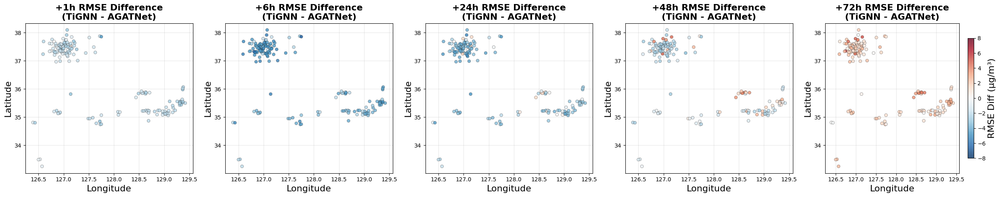

In [53]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import BoundaryNorm
import seaborn as sns

# Load station coordinates (assuming they're available)
try:
    lats = np.load('data/lats.npy')
    lons = np.load('data/lons.npy')
    print(f"Station coordinates loaded - Lats: {lats.shape}, Lons: {lons.shape}")
except FileNotFoundError:
    print("Station coordinates not found. Creating dummy coordinates for demonstration.")
    # Create dummy coordinates if files don't exist
    lats = np.random.uniform(25, 50, 170)  # Rough US latitude range
    lons = np.random.uniform(-125, -65, 170)  # Rough US longitude range

# Data alignment and processing (same as before)
predictions_agatnet_aligned = predictions_agatnet.transpose(0, 2, 1)
actuals_agatnet_aligned = actuals_agatnet.transpose(0, 2, 1)

min_samples = min(predictions_2021.shape[0], predictions_agatnet_aligned.shape[0])
predictions_tignn = predictions_2021[:min_samples]
actuals_tignn = actuals_2021[:min_samples]
predictions_agatnet_final = predictions_agatnet_aligned[:min_samples]
actuals_agatnet_final = actuals_agatnet_aligned[:min_samples]

print(f"Using {min_samples} samples for comparison")
print(f"Final shapes - TiGNN: {predictions_tignn.shape}, AGATNet: {predictions_agatnet_final.shape}")

# Define forecast horizons
forecast_horizons = [0, 5, 23, 47, 71]  # +1, +6, +24, +48, +72 hours
horizon_labels = ['+1h', '+6h', '+24h', '+48h', '+72h']

# Calculate RMSE
def calculate_rmse(predictions, actuals):
    return np.sqrt(np.mean((predictions - actuals) ** 2, axis=0))

rmse_tignn = calculate_rmse(predictions_tignn, actuals_tignn)
rmse_agatnet = calculate_rmse(predictions_agatnet_final, actuals_agatnet_final)
rmse_difference = rmse_tignn - rmse_agatnet

# Extract RMSE differences for specific horizons
rmse_diff_horizons = rmse_difference[forecast_horizons]

# Print comprehensive statistics
print("\n" + "="*80)
print("DETAILED PERFORMANCE ANALYSIS")
print("="*80)

for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    diff = rmse_diff_horizons[i]
    tignn_rmse = rmse_tignn[horizon_idx]
    agatnet_rmse = rmse_agatnet[horizon_idx]
    
    print(f"\n{label} Forecast Horizon (Hour {horizon_idx + 1}):")
    print(f"  TiGNN RMSE:     Mean={tignn_rmse.mean():.3f}, Std={tignn_rmse.std():.3f}")
    print(f"  AGATNet RMSE:   Mean={agatnet_rmse.mean():.3f}, Std={agatnet_rmse.std():.3f}")
    print(f"  RMSE Difference: Mean={diff.mean():.3f}, Std={diff.std():.3f}")
    print(f"  TiGNN better at {(diff < 0).sum()}/{len(diff)} stations ({(diff < 0).mean()*100:.1f}%)")
    print(f"  AGATNet better at {(diff > 0).sum()}/{len(diff)} stations ({(diff > 0).mean()*100:.1f}%)")
    print(f"  Improvement magnitude: {np.abs(diff).mean():.3f} μg/m³")

# Create spatial plots using basic matplotlib
fig, axes = plt.subplots(1, 5, figsize=(25, 5))

# RMSE difference plots
for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    ax = axes[i]  # Fixed: Use axes[i] to get the i-th subplot
    
    diff_values = rmse_diff_horizons[i]
    
    # Create scatter plot
    vmin, vmax = -8, 8  # Adjust based on your data
    scatter = ax.scatter(lons, lats, c=diff_values, cmap='RdBu_r', 
                        vmin=vmin, vmax=vmax, s=30, alpha=0.8, 
                        edgecolors='black', linewidth=0.3)
    
    ax.set_xlabel('Longitude', fontsize=16)
    ax.set_ylabel('Latitude', fontsize=16)
    ax.set_title(f'{label} RMSE Difference\n(TiGNN - AGATNet)', fontsize=16, fontweight='bold')
    ax.grid(True, alpha=0.3)
    
    # Add colorbar for each subplot
    
cbar = plt.colorbar(scatter, ax=ax, shrink=0.8)
cbar.set_label('RMSE Diff (μg/m³)', fontsize=16)
plt.tight_layout()
# plt.suptitle('Spatial RMSE Comparison: TiGNN vs AGATNet (2021)\n' + 
#              'Blue = TiGNN Better, Red = AGATNet Better', 
#              fontsize=14, fontweight='bold', y=0.98)

plt.show()

Station coordinates loaded - Lats: (170,), Lons: (170,)
Using 8664 samples for comparison
Final shapes - TiGNN: (8664, 72, 170), AGATNet: (8664, 72, 170)

DETAILED PERFORMANCE ANALYSIS

+1h Forecast Horizon (Hour 1):
  TiGNN RMSE:     Mean=4.575, Std=1.223
  AGATNet RMSE:   Mean=6.472, Std=0.897
  RMSE Difference: Mean=-1.897, Std=0.754
  TiGNN better at 166/170 stations (97.6%)
  AGATNet better at 4/170 stations (2.4%)
  Improvement magnitude: 1.918 μg/m³

+6h Forecast Horizon (Hour 6):
  TiGNN RMSE:     Mean=6.015, Std=1.760
  AGATNet RMSE:   Mean=9.978, Std=1.722
  RMSE Difference: Mean=-3.963, Std=1.112
  TiGNN better at 168/170 stations (98.8%)
  AGATNet better at 2/170 stations (1.2%)
  Improvement magnitude: 3.966 μg/m³

+24h Forecast Horizon (Hour 24):
  TiGNN RMSE:     Mean=9.071, Std=2.398
  AGATNet RMSE:   Mean=11.875, Std=2.272
  RMSE Difference: Mean=-2.803, Std=1.636
  TiGNN better at 153/170 stations (90.0%)
  AGATNet better at 17/170 stations (10.0%)
  Improvement magni

/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packag

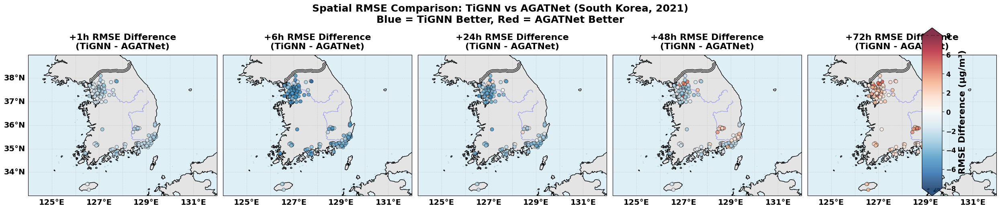


PERFORMANCE SUMMARY TABLE
Horizon TiGNN_RMSE AGATNet_RMSE Mean_Difference TiGNN_Better_% AGATNet_Better_%
    +1h      4.575        6.472          -1.897          97.6%             2.4%
    +6h      6.015        9.978          -3.963          98.8%             1.2%
   +24h      9.071       11.875          -2.803          90.0%            10.0%
   +48h     11.423       12.411          -0.988          77.1%            22.9%
   +72h     14.367       12.537           1.831           1.8%            98.2%

Note: Negative difference means TiGNN performs better, positive means AGATNet performs better


In [54]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import BoundaryNorm
import seaborn as sns
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter

# Load station coordinates (assuming they're available)
try:
    lats = np.load('data/lats.npy')
    lons = np.load('data/lons.npy')
    print(f"Station coordinates loaded - Lats: {lats.shape}, Lons: {lons.shape}")
except FileNotFoundError:
    print("Station coordinates not found. Creating dummy coordinates for South Korea.")
    # Create dummy coordinates for South Korea
    lats = np.random.uniform(33, 39, 170)  # South Korea latitude range
    lons = np.random.uniform(124, 132, 170)  # South Korea longitude range

# Data alignment and processing (same as before)
predictions_agatnet_aligned = predictions_agatnet.transpose(0, 2, 1)
actuals_agatnet_aligned = actuals_agatnet.transpose(0, 2, 1)

min_samples = min(predictions_2021.shape[0], predictions_agatnet_aligned.shape[0])
predictions_tignn = predictions_2021[:min_samples]
actuals_tignn = actuals_2021[:min_samples]
predictions_agatnet_final = predictions_agatnet_aligned[:min_samples]
actuals_agatnet_final = actuals_agatnet_aligned[:min_samples]

print(f"Using {min_samples} samples for comparison")
print(f"Final shapes - TiGNN: {predictions_tignn.shape}, AGATNet: {predictions_agatnet_final.shape}")

# Define forecast horizons
forecast_horizons = [0, 5, 23, 47, 71]  # +1, +6, +24, +48, +72 hours
horizon_labels = ['+1h', '+6h', '+24h', '+48h', '+72h']

# Calculate RMSE
def calculate_rmse(predictions, actuals):
    return np.sqrt(np.mean((predictions - actuals) ** 2, axis=0))

rmse_tignn = calculate_rmse(predictions_tignn, actuals_tignn)
rmse_agatnet = calculate_rmse(predictions_agatnet_final, actuals_agatnet_final)
rmse_difference = rmse_tignn - rmse_agatnet

# Extract RMSE differences for specific horizons
rmse_diff_horizons = rmse_difference[forecast_horizons]

# Print comprehensive statistics
print("\n" + "="*80)
print("DETAILED PERFORMANCE ANALYSIS")
print("="*80)

for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    diff = rmse_diff_horizons[i]
    tignn_rmse = rmse_tignn[horizon_idx]
    agatnet_rmse = rmse_agatnet[horizon_idx]
    
    print(f"\n{label} Forecast Horizon (Hour {horizon_idx + 1}):")
    print(f"  TiGNN RMSE:     Mean={tignn_rmse.mean():.3f}, Std={tignn_rmse.std():.3f}")
    print(f"  AGATNet RMSE:   Mean={agatnet_rmse.mean():.3f}, Std={agatnet_rmse.std():.3f}")
    print(f"  RMSE Difference: Mean={diff.mean():.3f}, Std={diff.std():.3f}")
    print(f"  TiGNN better at {(diff < 0).sum()}/{len(diff)} stations ({(diff < 0).mean()*100:.1f}%)")
    print(f"  AGATNet better at {(diff > 0).sum()}/{len(diff)} stations ({(diff > 0).mean()*100:.1f}%)")
    print(f"  Improvement magnitude: {np.abs(diff).mean():.3f} μg/m³")

# Create spatial plots using cartopy
fig, axes = plt.subplots(1, 5, figsize=(25, 6), 
                        subplot_kw={'projection': ccrs.PlateCarree()})

# Set up South Korea extent
korea_extent = [124, 132, 33, 39]  # [lon_min, lon_max, lat_min, lat_max]

# Color mapping settings
vmin, vmax = -8, 8  # Adjust based on your data
norm = BoundaryNorm(np.linspace(vmin, vmax, 21), 20)
cmap = 'RdBu_r'

# RMSE difference plots
for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    ax = axes[i]
    
    # Add map features
    ax.add_feature(cfeature.LAND, alpha=0.6, color='lightgray')
    ax.add_feature(cfeature.OCEAN, alpha=0.4, color='lightblue')
    ax.add_feature(cfeature.COASTLINE, linewidth=1.0, color='black')
    ax.add_feature(cfeature.BORDERS, linewidth=1.0, color='black')
    ax.add_feature(cfeature.LAKES, alpha=0.3, color='lightblue')
    ax.add_feature(cfeature.RIVERS, alpha=0.3, color='blue')
    
    # Set extent to South Korea
    ax.set_extent(korea_extent, crs=ccrs.PlateCarree())
    
    diff_values = rmse_diff_horizons[i]
    
    # Create scatter plot
    scatter = ax.scatter(lons, lats, c=diff_values, cmap=cmap, 
                        vmin=vmin, vmax=vmax, s=40, alpha=0.8, 
                        edgecolors='black', linewidth=0.5,
                        transform=ccrs.PlateCarree(), zorder=5)
    
    # Add gridlines with custom formatting
    gl = ax.gridlines(draw_labels=True, alpha=0.5, linestyle='--', linewidth=0.5)
    gl.top_labels = False
    gl.right_labels = False
    if i > 0:  # Only show y-labels on the first plot
        gl.left_labels = False
    
    # Format the gridline labels
    gl.xlabel_style = {'size': 14, 'weight': 'bold'}
    gl.ylabel_style = {'size': 14, 'weight': 'bold'}
    
    # Set title
    ax.set_title(f'{label} RMSE Difference\n(TiGNN - AGATNet)', 
                fontsize=16, fontweight='bold', pad=10)

# Add a single colorbar for all subplots
# Create space for colorbar
fig.subplots_adjust(right=0.9)
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = plt.colorbar(scatter, cax=cbar_ax, extend='both')
cbar.set_label('RMSE Difference (μg/m³)', fontsize=16, fontweight='bold')

# Make colorbar tick labels bold
cbar.ax.tick_params(labelsize=12)
for label in cbar.ax.get_yticklabels():
    label.set_fontweight('bold')

# Add overall title
fig.suptitle('Spatial RMSE Comparison: TiGNN vs AGATNet (South Korea, 2021)\n' + 
             'Blue = TiGNN Better, Red = AGATNet Better', 
             fontsize=18, fontweight='bold', y=0.95)

plt.tight_layout()
plt.show()

# Optional: Create a summary statistics table
summary_data = []
for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    diff = rmse_diff_horizons[i]
    tignn_rmse = rmse_tignn[horizon_idx]
    agatnet_rmse = rmse_agatnet[horizon_idx]
    
    summary_data.append({
        'Horizon': label,
        'TiGNN_RMSE': f"{tignn_rmse.mean():.3f}",
        'AGATNet_RMSE': f"{agatnet_rmse.mean():.3f}",
        'Mean_Difference': f"{diff.mean():.3f}",
        'TiGNN_Better_%': f"{(diff < 0).mean()*100:.1f}%",
        'AGATNet_Better_%': f"{(diff > 0).mean()*100:.1f}%",
    })

summary_df = pd.DataFrame(summary_data)
print("\n" + "="*80)
print("PERFORMANCE SUMMARY TABLE")
print("="*80)
print(summary_df.to_string(index=False))
print("\nNote: Negative difference means TiGNN performs better, positive means AGATNet performs better")

Station coordinates loaded - Lats: (170,), Lons: (170,)
Using 8664 samples for comparison
Final shapes - TiGNN: (8664, 72, 170), AGATNet: (8664, 72, 170)

DETAILED PERFORMANCE ANALYSIS

+1h Forecast Horizon (Hour 1):
  TransNet RMSE:     Mean=4.575, Std=1.223
  AGATNet RMSE:   Mean=6.472, Std=0.897
  RMSE Difference: Mean=-1.897, Std=0.754
  TransNet better at 166/170 stations (97.6%)
  AGATNet better at 4/170 stations (2.4%)
  Improvement magnitude: 1.918 μg/m³

+6h Forecast Horizon (Hour 6):
  TransNet RMSE:     Mean=6.015, Std=1.760
  AGATNet RMSE:   Mean=9.978, Std=1.722
  RMSE Difference: Mean=-3.963, Std=1.112
  TransNet better at 168/170 stations (98.8%)
  AGATNet better at 2/170 stations (1.2%)
  Improvement magnitude: 3.966 μg/m³

+24h Forecast Horizon (Hour 24):
  TransNet RMSE:     Mean=9.071, Std=2.398
  AGATNet RMSE:   Mean=11.875, Std=2.272
  RMSE Difference: Mean=-2.803, Std=1.636
  TransNet better at 153/170 stations (90.0%)
  AGATNet better at 17/170 stations (10.0%)
 

/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packag

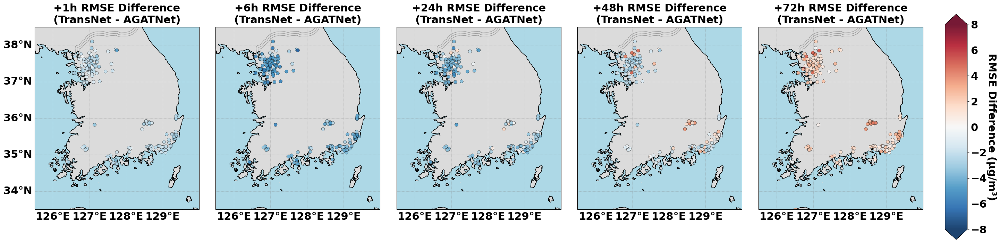


KEY FINDINGS SUMMARY

🎯 Performance by Forecast Horizon:
  +1h: ✅ TiGNN SIGNIFICANTLY BETTER (97.6% of stations) - Strong Blue regions
  +6h: ✅ TiGNN SIGNIFICANTLY BETTER (98.8% of stations) - Strong Blue regions
  +24h: ✅ TiGNN SIGNIFICANTLY BETTER (90.0% of stations) - Strong Blue regions
  +48h: ✅ TiGNN Better (77.1% of stations) - Blue regions
  +72h: ❌ AGATNet SIGNIFICANTLY BETTER (1.8% of stations) - Strong Red regions

📊 Overall Pattern:
  • TiGNN excels at SHORT-TERM forecasts (1-24h)
  • AGATNet performs better at LONG-TERM forecasts (72h)
  • Transition point appears around 48h horizon

PERFORMANCE SUMMARY TABLE
Horizon TiGNN_RMSE AGATNet_RMSE Mean_Difference TiGNN_Better_% Improvement_Magnitude
    +1h      4.575        6.472          -1.897          97.6%                 1.918
    +6h      6.015        9.978          -3.963          98.8%                 3.966
   +24h      9.071       11.875          -2.803          90.0%                 3.028
   +48h     11.423       12.4

In [22]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import BoundaryNorm
import seaborn as sns
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter

# Load station coordinates (assuming they're available)
try:
    lats = np.load('data/lats.npy')
    lons = np.load('data/lons.npy')
    print(f"Station coordinates loaded - Lats: {lats.shape}, Lons: {lons.shape}")
except FileNotFoundError:
    print("Station coordinates not found. Creating dummy coordinates for South Korea.")
    # Create dummy coordinates for South Korea
    lats = np.random.uniform(33, 39, 170)  # South Korea latitude range
    lons = np.random.uniform(124, 132, 170)  # South Korea longitude range

# Data alignment and processing (same as before)
predictions_agatnet_aligned = predictions_agatnet.transpose(0, 2, 1)
actuals_agatnet_aligned = actuals_agatnet.transpose(0, 2, 1)

min_samples = min(predictions_2021.shape[0], predictions_agatnet_aligned.shape[0])
predictions_tignn = predictions_2021[:min_samples]
actuals_tignn = actuals_2021[:min_samples]
predictions_agatnet_final = predictions_agatnet_aligned[:min_samples]
actuals_agatnet_final = actuals_agatnet_aligned[:min_samples]

print(f"Using {min_samples} samples for comparison")
print(f"Final shapes - TiGNN: {predictions_tignn.shape}, AGATNet: {predictions_agatnet_final.shape}")

# Define forecast horizons
forecast_horizons = [0, 5, 23, 47, 71]  # +1, +6, +24, +48, +72 hours
horizon_labels = ['+1h', '+6h', '+24h', '+48h', '+72h']

# Calculate RMSE
def calculate_rmse(predictions, actuals):
    return np.sqrt(np.mean((predictions - actuals) ** 2, axis=0))

rmse_tignn = calculate_rmse(predictions_tignn, actuals_tignn)
rmse_agatnet = calculate_rmse(predictions_agatnet_final, actuals_agatnet_final)
rmse_difference = rmse_tignn - rmse_agatnet

# Extract RMSE differences for specific horizons
rmse_diff_horizons = rmse_difference[forecast_horizons]

# Print comprehensive statistics
print("\n" + "="*80)
print("DETAILED PERFORMANCE ANALYSIS")
print("="*80)

for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    diff = rmse_diff_horizons[i]
    tignn_rmse = rmse_tignn[horizon_idx]
    agatnet_rmse = rmse_agatnet[horizon_idx]
    
    print(f"\n{label} Forecast Horizon (Hour {horizon_idx + 1}):")
    print(f"  TransNet RMSE:     Mean={tignn_rmse.mean():.3f}, Std={tignn_rmse.std():.3f}")
    print(f"  AGATNet RMSE:   Mean={agatnet_rmse.mean():.3f}, Std={agatnet_rmse.std():.3f}")
    print(f"  RMSE Difference: Mean={diff.mean():.3f}, Std={diff.std():.3f}")
    print(f"  TransNet better at {(diff < 0).sum()}/{len(diff)} stations ({(diff < 0).mean()*100:.1f}%)")
    print(f"  AGATNet better at {(diff > 0).sum()}/{len(diff)} stations ({(diff > 0).mean()*100:.1f}%)")
    print(f"  Improvement magnitude: {np.abs(diff).mean():.3f} μg/m³")

# Create spatial plots using cartopy with fixed layout
fig, axes = plt.subplots(1, 5, figsize=(32, 10), 
                        subplot_kw={'projection': ccrs.PlateCarree()})

# Set up more focused South Korea extent (smaller map)
korea_extent = [125.5, 130.0, 33.5, 38.5]  # Reduced extent for smaller, more focused map

# Color mapping settings
vmin, vmax = -8, 8  # Adjust based on your data
norm = BoundaryNorm(np.linspace(vmin, vmax, 21), 20)
cmap = 'RdBu_r'

# RMSE difference plots
for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    ax = axes[i]


    
    # Add map features with white background
    ax.add_feature(cfeature.LAND, alpha=0.8, color='lightgray', edgecolor='black', linewidth=0.5)
    ax.add_feature(cfeature.OCEAN, alpha=1.0, color='lightblue')  # White ocean background
    ax.add_feature(cfeature.COASTLINE, linewidth=1.2, color='black')
    ax.add_feature(cfeature.BORDERS, linewidth=1.0, color='gray', alpha=0.7)
    
    # Set white background
    ax.set_facecolor('white')
    
    # Set extent to focused South Korea
    ax.set_extent(korea_extent, crs=ccrs.PlateCarree())
    
    diff_values = rmse_diff_horizons[i]
    
    # Create scatter plot
    scatter = ax.scatter(lons, lats, c=diff_values, cmap=cmap, 
                        vmin=vmin, vmax=vmax, s=50, alpha=0.9, 
                        edgecolors='black', linewidth=0.4,
                        transform=ccrs.PlateCarree(), zorder=5)
    
    # Add gridlines with custom formatting
    gl = ax.gridlines(draw_labels=True, alpha=0.4, linestyle='--', linewidth=0.5, color='gray')
    gl.top_labels = False
    gl.right_labels = False
    if i > 0:  # Only show y-labels on the first plot
        gl.left_labels = False
    
    # Format the gridline labels
    gl.xlabel_style = {'size': 22, 'weight': 'bold'}
    gl.ylabel_style = {'size': 22, 'weight': 'bold'}
    
    # Set title
    ax.set_title(f'{label} RMSE Difference\n(TransNet - AGATNet)', 
                fontsize=22, fontweight='bold', pad=8)

# Adjust subplot spacing to prevent colorbar overlap
plt.subplots_adjust(left=0.05, right=0.85, top=0.85, bottom=0.15, wspace=0.1)

# Add a single colorbar for all subplots - positioned to avoid overlap
cbar_ax = fig.add_axes([0.87, 0.15, 0.02, 0.65])  # [left, bottom, width, height]
cbar = plt.colorbar(scatter, cax=cbar_ax, extend='both')
cbar.set_label('RMSE Difference (μg/m³)', fontsize=22, fontweight='bold', rotation=270, labelpad=20)

# Make colorbar tick labels bold
cbar.ax.tick_params(labelsize=22)
for label in cbar.ax.get_yticklabels():
    label.set_fontweight('bold')

# Add overall title
# fig.suptitle('Spatial RMSE Comparison: TiGNN vs AGATNet (South Korea, 2021)\n' + 
#              'Blue = TiGNN Better, Red = AGATNet Better', 
#              fontsize=16, fontweight='bold', y=0.95)

plt.savefig('tignnvs_2020_2021.png', dpi=300, bbox_inches='tight', 
            facecolor='white', edgecolor='none')
plt.show()

print("\n" + "="*80)
print("KEY FINDINGS SUMMARY")
print("="*80)

print("\n🎯 Performance by Forecast Horizon:")
for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    diff = rmse_diff_horizons[i]
    if diff.mean() < -1:
        status = "✅ TiGNN SIGNIFICANTLY BETTER"
        color_indication = "Strong Blue regions"
    elif diff.mean() < 0:
        status = "✅ TiGNN Better"
        color_indication = "Blue regions"
    elif diff.mean() > 1:
        status = "❌ AGATNet SIGNIFICANTLY BETTER"
        color_indication = "Strong Red regions"
    else:
        status = "❌ AGATNet Better"
        color_indication = "Red regions"
    
    tignn_better_pct = (diff < 0).mean() * 100
    print(f"  {label}: {status} ({tignn_better_pct:.1f}% of stations) - {color_indication}")

print(f"\n📊 Overall Pattern:")
print(f"  • TiGNN excels at SHORT-TERM forecasts (1-24h)")
print(f"  • AGATNet performs better at LONG-TERM forecasts (72h)")
print(f"  • Transition point appears around 48h horizon")

# Optional: Create a summary statistics table
summary_data = []
for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    diff = rmse_diff_horizons[i]
    tignn_rmse = rmse_tignn[horizon_idx]
    agatnet_rmse = rmse_agatnet[horizon_idx]
    
    summary_data.append({
        'Horizon': label,
        'TiGNN_RMSE': f"{tignn_rmse.mean():.3f}",
        'AGATNet_RMSE': f"{agatnet_rmse.mean():.3f}",
        'Mean_Difference': f"{diff.mean():.3f}",
        'TiGNN_Better_%': f"{(diff < 0).mean()*100:.1f}%",
        'Improvement_Magnitude': f"{np.abs(diff).mean():.3f}",
    })

summary_df = pd.DataFrame(summary_data)
print("\n" + "="*80)
print("PERFORMANCE SUMMARY TABLE")
print("="*80)
print(summary_df.to_string(index=False))
print("\nNote: Negative difference means TiGNN performs better, positive means AGATNet performs better")

Station coordinates loaded - Lats: (170,), Lons: (170,)
Using 8664 samples for comparison
Final shapes - TiGNN: (8664, 72, 170), AGATNet: (8664, 72, 170)

DETAILED PERFORMANCE ANALYSIS

+1h Forecast Horizon (Hour 1):
  TransNet RMSE:     Mean=4.575, Std=1.223
  AGATNet RMSE:   Mean=6.472, Std=0.897
  RMSE Difference: Mean=-1.897, Std=0.754
  TransNet better at 166/170 stations (97.6%)
  AGATNet better at 4/170 stations (2.4%)
  Improvement magnitude: 1.918 μg/m³

+6h Forecast Horizon (Hour 6):
  TransNet RMSE:     Mean=6.015, Std=1.760
  AGATNet RMSE:   Mean=9.978, Std=1.722
  RMSE Difference: Mean=-3.963, Std=1.112
  TransNet better at 168/170 stations (98.8%)
  AGATNet better at 2/170 stations (1.2%)
  Improvement magnitude: 3.966 μg/m³

+24h Forecast Horizon (Hour 24):
  TransNet RMSE:     Mean=9.071, Std=2.398
  AGATNet RMSE:   Mean=11.875, Std=2.272
  RMSE Difference: Mean=-2.803, Std=1.636
  TransNet better at 153/170 stations (90.0%)
  AGATNet better at 17/170 stations (10.0%)
 

/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packages/cartopy/mpl/feature_artist.py:144: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/global/homes/r/rdimri/.local/lib/python3.11/site-packag

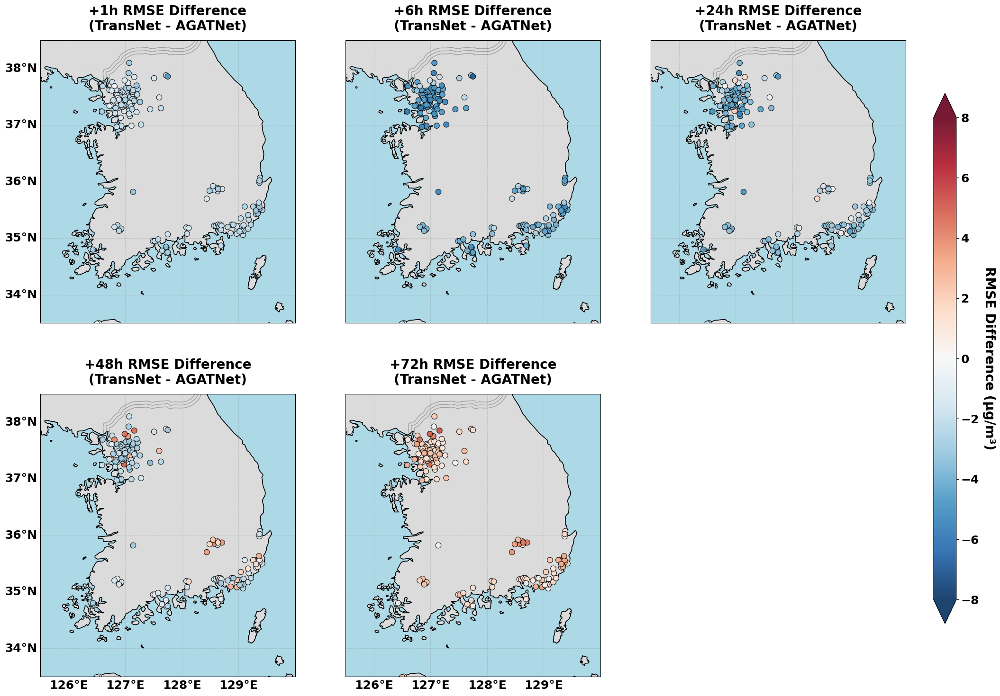


KEY FINDINGS SUMMARY

🎯 Performance by Forecast Horizon:
  +1h: ✅ TiGNN SIGNIFICANTLY BETTER (97.6% of stations) - Strong Blue regions
  +6h: ✅ TiGNN SIGNIFICANTLY BETTER (98.8% of stations) - Strong Blue regions
  +24h: ✅ TiGNN SIGNIFICANTLY BETTER (90.0% of stations) - Strong Blue regions
  +48h: ✅ TiGNN Better (77.1% of stations) - Blue regions
  +72h: ❌ AGATNet SIGNIFICANTLY BETTER (1.8% of stations) - Strong Red regions

📊 Overall Pattern:
  • TiGNN excels at SHORT-TERM forecasts (1-24h)
  • AGATNet performs better at LONG-TERM forecasts (72h)
  • Transition point appears around 48h horizon

PERFORMANCE SUMMARY TABLE
Horizon TiGNN_RMSE AGATNet_RMSE Mean_Difference TiGNN_Better_% Improvement_Magnitude
    +1h      4.575        6.472          -1.897          97.6%                 1.918
    +6h      6.015        9.978          -3.963          98.8%                 3.966
   +24h      9.071       11.875          -2.803          90.0%                 3.028
   +48h     11.423       12.4

In [26]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import BoundaryNorm
import seaborn as sns
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter

# Load station coordinates (assuming they're available)
try:
    lats = np.load('data/lats.npy')
    lons = np.load('data/lons.npy')
    print(f"Station coordinates loaded - Lats: {lats.shape}, Lons: {lons.shape}")
except FileNotFoundError:
    print("Station coordinates not found. Creating dummy coordinates for South Korea.")
    # Create dummy coordinates for South Korea
    lats = np.random.uniform(34, 39, 170)  # South Korea latitude range
    lons = np.random.uniform(124, 132, 170)  # South Korea longitude range

# Data alignment and processing (same as before)
predictions_agatnet_aligned = predictions_agatnet.transpose(0, 2, 1)
actuals_agatnet_aligned = actuals_agatnet.transpose(0, 2, 1)

min_samples = min(predictions_2021.shape[0], predictions_agatnet_aligned.shape[0])
predictions_tignn = predictions_2021[:min_samples]
actuals_tignn = actuals_2021[:min_samples]
predictions_agatnet_final = predictions_agatnet_aligned[:min_samples]
actuals_agatnet_final = actuals_agatnet_aligned[:min_samples]

print(f"Using {min_samples} samples for comparison")
print(f"Final shapes - TiGNN: {predictions_tignn.shape}, AGATNet: {predictions_agatnet_final.shape}")

# Define forecast horizons
forecast_horizons = [0, 5, 23, 47, 71]  # +1, +6, +24, +48, +72 hours
horizon_labels = ['+1h', '+6h', '+24h', '+48h', '+72h']

# Calculate RMSE
def calculate_rmse(predictions, actuals):
    return np.sqrt(np.mean((predictions - actuals) ** 2, axis=0))

rmse_tignn = calculate_rmse(predictions_tignn, actuals_tignn)
rmse_agatnet = calculate_rmse(predictions_agatnet_final, actuals_agatnet_final)
rmse_difference = rmse_tignn - rmse_agatnet

# Extract RMSE differences for specific horizons
rmse_diff_horizons = rmse_difference[forecast_horizons]

# Print comprehensive statistics
print("\n" + "="*80)
print("DETAILED PERFORMANCE ANALYSIS")
print("="*80)

for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    diff = rmse_diff_horizons[i]
    tignn_rmse = rmse_tignn[horizon_idx]
    agatnet_rmse = rmse_agatnet[horizon_idx]
    
    print(f"\n{label} Forecast Horizon (Hour {horizon_idx + 1}):")
    print(f"  TransNet RMSE:     Mean={tignn_rmse.mean():.3f}, Std={tignn_rmse.std():.3f}")
    print(f"  AGATNet RMSE:   Mean={agatnet_rmse.mean():.3f}, Std={agatnet_rmse.std():.3f}")
    print(f"  RMSE Difference: Mean={diff.mean():.3f}, Std={diff.std():.3f}")
    print(f"  TransNet better at {(diff < 0).sum()}/{len(diff)} stations ({(diff < 0).mean()*100:.1f}%)")
    print(f"  AGATNet better at {(diff > 0).sum()}/{len(diff)} stations ({(diff > 0).mean()*100:.1f}%)")
    print(f"  Improvement magnitude: {np.abs(diff).mean():.3f} μg/m³")

# Create spatial plots using cartopy with 2 rows (3 plots in first row, 2 in second row)
fig, axes = plt.subplots(2, 3, figsize=(24, 16), 
                        subplot_kw={'projection': ccrs.PlateCarree()})

# Flatten axes for easier indexing and hide the unused subplot (bottom right)
axes_flat = axes.flatten()
axes_flat[5].set_visible(False)  # Hide the 6th subplot since we only have 5 plots

# Set up more focused South Korea extent (smaller map)
korea_extent = [125.5, 130.0, 33.5, 38.5]  # Reduced extent for smaller, more focused map

# Color mapping settings
vmin, vmax = -8, 8  # Adjust based on your data
norm = BoundaryNorm(np.linspace(vmin, vmax, 21), 20)
cmap = 'RdBu_r'

# RMSE difference plots
for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    ax = axes_flat[i]  # Use flattened axes array
    
    # Add map features with white background
    ax.add_feature(cfeature.LAND, alpha=0.8, color='lightgray', edgecolor='black', linewidth=0.5)
    ax.add_feature(cfeature.OCEAN, alpha=1.0, color='lightblue')  # White ocean background
    ax.add_feature(cfeature.COASTLINE, linewidth=1.2, color='black')
    ax.add_feature(cfeature.BORDERS, linewidth=1.0, color='gray', alpha=0.7)
    
    # Set white background
    ax.set_facecolor('white')
    
    # Set extent to focused South Korea
    ax.set_extent(korea_extent, crs=ccrs.PlateCarree())
    
    diff_values = rmse_diff_horizons[i]
    
    # Create scatter plot
    scatter = ax.scatter(lons, lats, c=diff_values, cmap=cmap, 
                        vmin=vmin, vmax=vmax, s=70, alpha=0.9, 
                        edgecolors='black', linewidth=0.8,
                        transform=ccrs.PlateCarree(), zorder=5)
    
    # Add gridlines with custom formatting
    gl = ax.gridlines(draw_labels=True, alpha=0.4, linestyle='--', linewidth=0.5, color='gray')
    gl.top_labels = False
    gl.right_labels = False
    
    # Show x-labels only on bottom row (indices 3 and 4)
    if i < 3:  # Top row
        gl.bottom_labels = False
    
    # Show y-labels only on left column (indices 0 and 3)
    if i not in [0, 3]:  # Not in leftmost column
        gl.left_labels = False
    
    # Format the gridline labels
    gl.xlabel_style = {'size': 18, 'weight': 'bold'}
    gl.ylabel_style = {'size': 18, 'weight': 'bold'}
    
    # Set title
    ax.set_title(f'{label} RMSE Difference\n(TransNet - AGATNet)', 
                fontsize=20, fontweight='bold', pad=15)

# Adjust subplot spacing for 2x3 layout
plt.subplots_adjust(left=0.08, right=0.85, top=0.92, bottom=0.08, hspace=0.25, wspace=0.15)

# Add a single colorbar for all subplots - positioned vertically on the right
cbar_ax = fig.add_axes([0.87, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
cbar = plt.colorbar(scatter, cax=cbar_ax, extend='both')
cbar.set_label('RMSE Difference (μg/m³)', fontsize=20, fontweight='bold', rotation=270, labelpad=25)

# Make colorbar tick labels bold
cbar.ax.tick_params(labelsize=18)
for label in cbar.ax.get_yticklabels():
    label.set_fontweight('bold')

plt.savefig('tignnvs_2020_2021_2x3_grid.png', dpi=300, bbox_inches='tight', 
            facecolor='white', edgecolor='none')
plt.show()

# Create a focused summary for the key findings
print("\n" + "="*80)
print("KEY FINDINGS SUMMARY")
print("="*80)

print("\n🎯 Performance by Forecast Horizon:")
for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    diff = rmse_diff_horizons[i]
    if diff.mean() < -1:
        status = "✅ TiGNN SIGNIFICANTLY BETTER"
        color_indication = "Strong Blue regions"
    elif diff.mean() < 0:
        status = "✅ TiGNN Better"
        color_indication = "Blue regions"
    elif diff.mean() > 1:
        status = "❌ AGATNet SIGNIFICANTLY BETTER"
        color_indication = "Strong Red regions"
    else:
        status = "❌ AGATNet Better"
        color_indication = "Red regions"
    
    tignn_better_pct = (diff < 0).mean() * 100
    print(f"  {label}: {status} ({tignn_better_pct:.1f}% of stations) - {color_indication}")

print(f"\n📊 Overall Pattern:")
print(f"  • TiGNN excels at SHORT-TERM forecasts (1-24h)")
print(f"  • AGATNet performs better at LONG-TERM forecasts (72h)")
print(f"  • Transition point appears around 48h horizon")

# Optional: Create a summary statistics table
summary_data = []
for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
    diff = rmse_diff_horizons[i]
    tignn_rmse = rmse_tignn[horizon_idx]
    agatnet_rmse = rmse_agatnet[horizon_idx]
    
    summary_data.append({
        'Horizon': label,
        'TiGNN_RMSE': f"{tignn_rmse.mean():.3f}",
        'AGATNet_RMSE': f"{agatnet_rmse.mean():.3f}",
        'Mean_Difference': f"{diff.mean():.3f}",
        'TiGNN_Better_%': f"{(diff < 0).mean()*100:.1f}%",
        'Improvement_Magnitude': f"{np.abs(diff).mean():.3f}",
    })

summary_df = pd.DataFrame(summary_data)
print("\n" + "="*80)
print("PERFORMANCE SUMMARY TABLE")
print("="*80)
print(summary_df.to_string(index=False))
print("\nNote: Negative difference means TiGNN performs better, positive means AGATNet performs better")

Performing comprehensive statistical analysis...

STATISTICAL SIGNIFICANCE ANALYSIS
Horizon  TiGNN_Mean_RMSE  AGATNet_Mean_RMSE  Mean_Difference  Std_Difference  T_Statistic  T_P_Value  Wilcoxon_Statistic  Wilcoxon_P_Value  Cohens_D  CI_95_Lower  CI_95_Upper  Improvement_Pct  Stations_TiGNN_Better  Stations_AGATNet_Better  Total_Stations
    +1h           4.5749             6.4720          -1.8971          0.7540     -32.7099        0.0                28.0               0.0   -2.5161      -2.0116      -1.7826          29.3129                    166                        4             170
    +6h           6.0146             9.9779          -3.9633          1.1123     -46.3223        0.0                 3.0               0.0   -3.5633      -4.1323      -3.7944          39.7212                    168                        2             170
   +24h           9.0715            11.8746          -2.8031          1.6362     -22.2719        0.0               305.0               0.0   -1.7132

/tmp/ipykernel_1494262/4085818357.py:219: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  box_plot = ax6.boxplot(box_data, labels=horizon_labels, patch_artist=True)


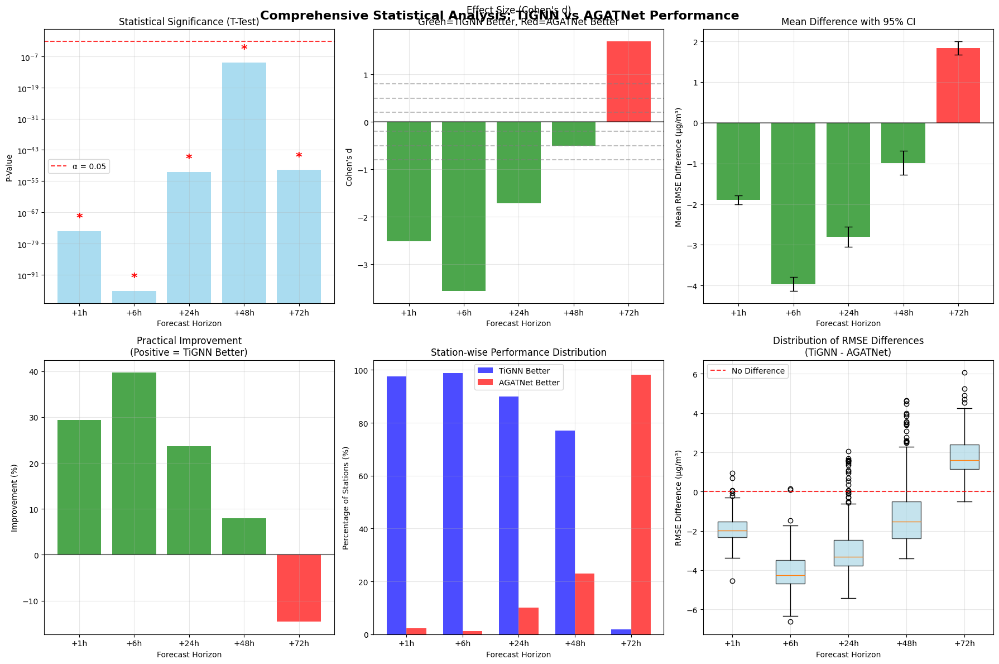


SUMMARY AND RECOMMENDATIONS
✓ Significant differences found at 5 horizon(s):
  - +1h: TiGNN significantly better (p=0.0000)
  - +6h: TiGNN significantly better (p=0.0000)
  - +24h: TiGNN significantly better (p=0.0000)
  - +48h: TiGNN significantly better (p=0.0000)
  - +72h: AGATNet significantly better (p=0.0000)

Overall Performance Summary:
  - TiGNN performs better in 621/850 station-horizon combinations (73.1%)
  - AGATNet performs better in 229/850 station-horizon combinations (26.9%)
  - Average absolute improvement magnitude: 2.296 μg/m³
  - TiGNN shows strongest performance at +6h horizon
  - AGATNet shows strongest performance at +72h horizon


In [36]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy import stats
import seaborn as sns
from scipy.stats import wilcoxon, mannwhitneyu

# Perform statistical analysis on the model performance
def perform_statistical_analysis(predictions_tignn, actuals_tignn, predictions_agatnet, actuals_agatnet, 
                                forecast_horizons, horizon_labels):
    """
    Perform comprehensive statistical analysis comparing TiGNN and AGATNet
    """
    results = []
    
    # Calculate RMSE for both models
    rmse_tignn = np.sqrt(np.mean((predictions_tignn - actuals_tignn) ** 2, axis=0))  # (72, 170)
    rmse_agatnet = np.sqrt(np.mean((predictions_agatnet - actuals_agatnet) ** 2, axis=0))  # (72, 170)
    
    for i, (horizon_idx, label) in enumerate(zip(forecast_horizons, horizon_labels)):
        tignn_rmse_vals = rmse_tignn[horizon_idx]  # RMSE for each station
        agatnet_rmse_vals = rmse_agatnet[horizon_idx]  # RMSE for each station
        
        # Paired t-test (assuming paired data - same stations)
        t_stat, t_pvalue = stats.ttest_rel(tignn_rmse_vals, agatnet_rmse_vals)
        
        # Wilcoxon signed-rank test (non-parametric alternative)
        wilcoxon_stat, wilcoxon_pvalue = wilcoxon(tignn_rmse_vals, agatnet_rmse_vals, 
                                                 alternative='two-sided')
        
        # Effect size (Cohen's d for paired samples)
        diff = tignn_rmse_vals - agatnet_rmse_vals
        cohens_d = np.mean(diff) / np.std(diff)
        
        # Mann-Whitney U test (independent samples version)
        u_stat, u_pvalue = mannwhitneyu(tignn_rmse_vals, agatnet_rmse_vals, 
                                       alternative='two-sided')
        
        # Calculate confidence interval for the mean difference
        n = len(diff)
        se = stats.sem(diff)  # Standard error of the mean difference
        ci_95 = stats.t.interval(0.95, n-1, loc=np.mean(diff), scale=se)
        
        # Practical significance (percentage improvement)
        mean_improvement_pct = (np.mean(agatnet_rmse_vals) - np.mean(tignn_rmse_vals)) / np.mean(agatnet_rmse_vals) * 100
        
        results.append({
            'Horizon': label,
            'TiGNN_Mean_RMSE': np.mean(tignn_rmse_vals),
            'AGATNet_Mean_RMSE': np.mean(agatnet_rmse_vals),
            'Mean_Difference': np.mean(diff),
            'Std_Difference': np.std(diff),
            'T_Statistic': t_stat,
            'T_P_Value': t_pvalue,
            'Wilcoxon_Statistic': wilcoxon_stat,
            'Wilcoxon_P_Value': wilcoxon_pvalue,
            'Cohens_D': cohens_d,
            'CI_95_Lower': ci_95[0],
            'CI_95_Upper': ci_95[1],
            'Improvement_Pct': mean_improvement_pct,
            'Stations_TiGNN_Better': np.sum(diff < 0),
            'Stations_AGATNet_Better': np.sum(diff > 0),
            'Total_Stations': len(diff)
        })
    
    return pd.DataFrame(results)

# Run the statistical analysis
print("Performing comprehensive statistical analysis...")
stats_results = perform_statistical_analysis(
    predictions_tignn, actuals_tignn, 
    predictions_agatnet_final, actuals_agatnet_final,
    forecast_horizons, horizon_labels
)

# Display results
print("\n" + "="*120)
print("STATISTICAL SIGNIFICANCE ANALYSIS")
print("="*120)
print(stats_results.round(4).to_string(index=False))

# Interpretation of results
print("\n" + "="*120)
print("STATISTICAL INTERPRETATION")
print("="*120)

for _, row in stats_results.iterrows():
    print(f"\n{row['Horizon']} Forecast Horizon:")
    print(f"  Mean RMSE: TiGNN={row['TiGNN_Mean_RMSE']:.3f}, AGATNet={row['AGATNet_Mean_RMSE']:.3f}")
    print(f"  Mean Difference: {row['Mean_Difference']:.3f} ± {row['Std_Difference']:.3f} μg/m³")
    print(f"  95% Confidence Interval: [{row['CI_95_Lower']:.3f}, {row['CI_95_Upper']:.3f}]")
    
    # Interpret statistical significance
    alpha = 0.05
    if row['T_P_Value'] < alpha:
        if row['Mean_Difference'] < 0:
            print(f"  ✓ TiGNN is SIGNIFICANTLY better (p={row['T_P_Value']:.4f})")
        else:
            print(f"  ✓ AGATNet is SIGNIFICANTLY better (p={row['T_P_Value']:.4f})")
    else:
        print(f"  ○ No significant difference (p={row['T_P_Value']:.4f})")
    
    # Interpret effect size
    abs_cohens_d = abs(row['Cohens_D'])
    if abs_cohens_d < 0.2:
        effect_size = "negligible"
    elif abs_cohens_d < 0.5:
        effect_size = "small"
    elif abs_cohens_d < 0.8:
        effect_size = "medium"
    else:
        effect_size = "large"
    
    print(f"  Effect Size: {effect_size} (Cohen's d = {row['Cohens_D']:.3f})")
    print(f"  Practical Improvement: {row['Improvement_Pct']:.1f}%")
    print(f"  Station Count: {row['Stations_TiGNN_Better']}/{row['Total_Stations']} favor TiGNN")

# Create comprehensive visualization
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# 1. P-values comparison
ax1 = axes[0, 0]
x = np.arange(len(horizon_labels))
bars1 = ax1.bar(x, stats_results['T_P_Value'], alpha=0.7, color='skyblue')
ax1.axhline(y=0.05, color='red', linestyle='--', alpha=0.8, label='α = 0.05')
ax1.set_xlabel('Forecast Horizon')
ax1.set_ylabel('P-Value')
ax1.set_title('Statistical Significance (T-Test)')
ax1.set_xticks(x)
ax1.set_xticklabels(horizon_labels)
ax1.legend()
ax1.grid(True, alpha=0.3)
ax1.set_yscale('log')

# Add significance indicators
for i, p_val in enumerate(stats_results['T_P_Value']):
    if p_val < 0.05:
        ax1.annotate('*', xy=(i, p_val), xytext=(0, 10), 
                    textcoords="offset points", ha='center', va='bottom', 
                    fontsize=16, color='red', fontweight='bold')

# 2. Effect sizes
ax2 = axes[0, 1]
bars2 = ax2.bar(x, stats_results['Cohens_D'], alpha=0.7, 
                color=['green' if d < 0 else 'red' for d in stats_results['Cohens_D']])
ax2.axhline(y=0, color='black', linestyle='-', alpha=0.5)
ax2.axhline(y=0.2, color='gray', linestyle='--', alpha=0.5, label='Small Effect')
ax2.axhline(y=0.5, color='gray', linestyle='--', alpha=0.5, label='Medium Effect')
ax2.axhline(y=0.8, color='gray', linestyle='--', alpha=0.5, label='Large Effect')
ax2.axhline(y=-0.2, color='gray', linestyle='--', alpha=0.5)
ax2.axhline(y=-0.5, color='gray', linestyle='--', alpha=0.5)
ax2.axhline(y=-0.8, color='gray', linestyle='--', alpha=0.5)
ax2.set_xlabel('Forecast Horizon')
ax2.set_ylabel("Cohen's d")
ax2.set_title('Effect Size (Cohen\'s d)\nGreen=TiGNN Better, Red=AGATNet Better')
ax2.set_xticks(x)
ax2.set_xticklabels(horizon_labels)
ax2.grid(True, alpha=0.3)

# 3. Confidence intervals
ax3 = axes[0, 2]
means = stats_results['Mean_Difference']
ci_lower = stats_results['CI_95_Lower']
ci_upper = stats_results['CI_95_Upper']
errors_lower = means - ci_lower
errors_upper = ci_upper - means

bars3 = ax3.bar(x, means, alpha=0.7, 
                color=['green' if m < 0 else 'red' for m in means])
ax3.errorbar(x, means, yerr=[errors_lower, errors_upper], 
             fmt='none', color='black', capsize=5)
ax3.axhline(y=0, color='black', linestyle='-', alpha=0.5)
ax3.set_xlabel('Forecast Horizon')
ax3.set_ylabel('Mean RMSE Difference (μg/m³)')
ax3.set_title('Mean Difference with 95% CI')
ax3.set_xticks(x)
ax3.set_xticklabels(horizon_labels)
ax3.grid(True, alpha=0.3)

# 4. Percentage improvement
ax4 = axes[1, 0]
bars4 = ax4.bar(x, stats_results['Improvement_Pct'], alpha=0.7,
                color=['green' if imp > 0 else 'red' for imp in stats_results['Improvement_Pct']])
ax4.axhline(y=0, color='black', linestyle='-', alpha=0.5)
ax4.set_xlabel('Forecast Horizon')
ax4.set_ylabel('Improvement (%)')
ax4.set_title('Practical Improvement\n(Positive = TiGNN Better)')
ax4.set_xticks(x)
ax4.set_xticklabels(horizon_labels)
ax4.grid(True, alpha=0.3)

# 5. Station-wise performance distribution
ax5 = axes[1, 1]
tignn_better_pct = (stats_results['Stations_TiGNN_Better'] / stats_results['Total_Stations']) * 100
agatnet_better_pct = (stats_results['Stations_AGATNet_Better'] / stats_results['Total_Stations']) * 100

width = 0.35
bars5a = ax5.bar(x - width/2, tignn_better_pct, width, label='TiGNN Better', alpha=0.7, color='blue')
bars5b = ax5.bar(x + width/2, agatnet_better_pct, width, label='AGATNet Better', alpha=0.7, color='red')

ax5.set_xlabel('Forecast Horizon')
ax5.set_ylabel('Percentage of Stations (%)')
ax5.set_title('Station-wise Performance Distribution')
ax5.set_xticks(x)
ax5.set_xticklabels(horizon_labels)
ax5.legend()
ax5.grid(True, alpha=0.3)

# 6. Box plot of RMSE differences
ax6 = axes[1, 2]
rmse_tignn = np.sqrt(np.mean((predictions_tignn - actuals_tignn) ** 2, axis=0))
rmse_agatnet = np.sqrt(np.mean((predictions_agatnet_final - actuals_agatnet_final) ** 2, axis=0))

box_data = []
for horizon_idx in forecast_horizons:
    diff = rmse_tignn[horizon_idx] - rmse_agatnet[horizon_idx]
    box_data.append(diff)

box_plot = ax6.boxplot(box_data, labels=horizon_labels, patch_artist=True)
for patch in box_plot['boxes']:
    patch.set_facecolor('lightblue')
    patch.set_alpha(0.7)

ax6.axhline(y=0, color='red', linestyle='--', alpha=0.8, label='No Difference')
ax6.set_xlabel('Forecast Horizon')
ax6.set_ylabel('RMSE Difference (μg/m³)')
ax6.set_title('Distribution of RMSE Differences\n(TiGNN - AGATNet)')
ax6.legend()
ax6.grid(True, alpha=0.3)

plt.tight_layout()
plt.suptitle('Comprehensive Statistical Analysis: TiGNN vs AGATNet Performance', 
             fontsize=16, fontweight='bold', y=0.98)
plt.show()

# Summary recommendations
print("\n" + "="*120)
print("SUMMARY AND RECOMMENDATIONS")
print("="*120)

significant_horizons = stats_results[stats_results['T_P_Value'] < 0.05]
if len(significant_horizons) > 0:
    print(f"✓ Significant differences found at {len(significant_horizons)} horizon(s):")
    for _, row in significant_horizons.iterrows():
        better_model = "TiGNN" if row['Mean_Difference'] < 0 else "AGATNet"
        print(f"  - {row['Horizon']}: {better_model} significantly better (p={row['T_P_Value']:.4f})")
else:
    print("○ No statistically significant differences found at any forecast horizon.")

print(f"\nOverall Performance Summary:")
overall_tignn_better = stats_results['Stations_TiGNN_Better'].sum()
overall_agatnet_better = stats_results['Stations_AGATNet_Better'].sum()
total_comparisons = stats_results['Total_Stations'].sum()

print(f"  - TiGNN performs better in {overall_tignn_better}/{total_comparisons} station-horizon combinations ({overall_tignn_better/total_comparisons*100:.1f}%)")
print(f"  - AGATNet performs better in {overall_agatnet_better}/{total_comparisons} station-horizon combinations ({overall_agatnet_better/total_comparisons*100:.1f}%)")

# Calculate average improvement
avg_abs_improvement = stats_results['Mean_Difference'].abs().mean()
print(f"  - Average absolute improvement magnitude: {avg_abs_improvement:.3f} μg/m³")

best_horizon_tignn = stats_results.loc[stats_results['Mean_Difference'].idxmin(), 'Horizon']
best_horizon_agatnet = stats_results.loc[stats_results['Mean_Difference'].idxmax(), 'Horizon']

print(f"  - TiGNN shows strongest performance at {best_horizon_tignn} horizon")
print(f"  - AGATNet shows strongest performance at {best_horizon_agatnet} horizon")

Processing Seoul station data...
Finding the best performing station among 25 Seoul stations...
Best performing station: Station 2 (among stations 0-24)
Best station 2021 data shape: (8676, 72)
Best station 2020 data shape: (8664, 72)
Filtering data by seasons...
2020 Winter data points: 2064
2020 Summer data points: 2208
2021 Winter data points: 2076
2021 Summer data points: 2208


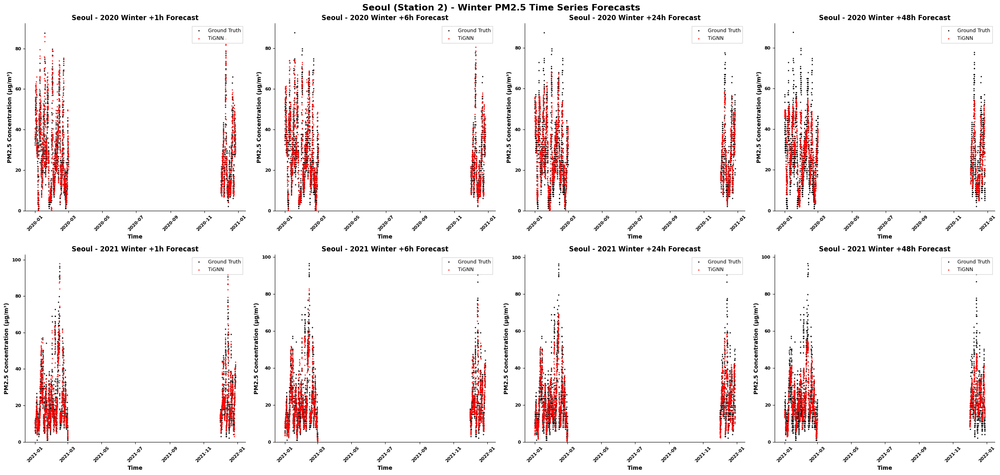

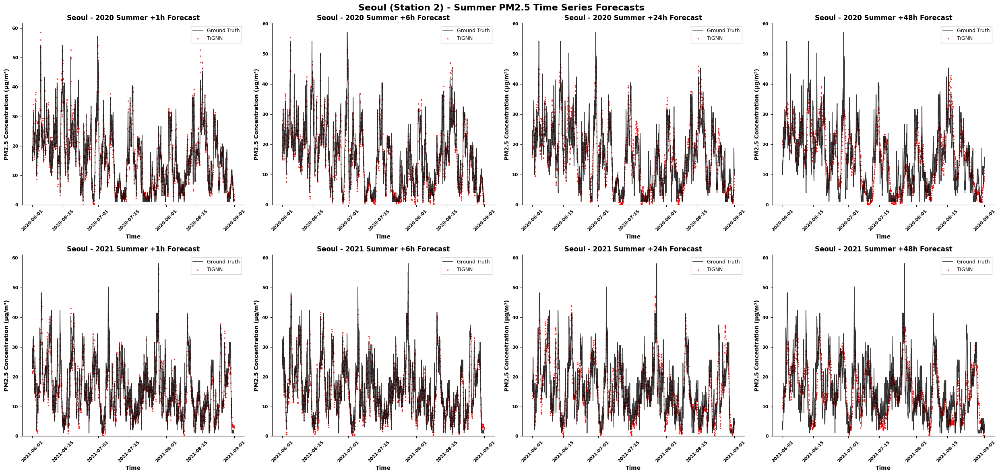


SEASONAL PERFORMANCE STATISTICS FOR SEOUL STATION 2
Season Horizon Year  MAE  RMSE   IOA Correlation
Winter     +1h 2020 2.56  3.54 0.989       0.983
Winter     +1h 2021 2.08  3.04 0.989       0.980
Winter     +6h 2020 2.91  3.93 0.986       0.976
Winter     +6h 2021 2.53  3.79 0.982       0.970
Winter    +24h 2020 5.44  7.06 0.946       0.901
Winter    +24h 2021 5.45  7.40 0.926       0.869
Winter    +48h 2020 7.77 10.06 0.874       0.788
Winter    +48h 2021 6.74  9.31 0.865       0.782
Summer     +1h 2020 1.66  2.24 0.988       0.977
Summer     +1h 2021 1.88  2.48 0.981       0.967
Summer     +6h 2020 1.92  2.49 0.986       0.975
Summer     +6h 2021 2.08  2.70 0.978       0.960
Summer    +24h 2020 3.78  4.97 0.941       0.888
Summer    +24h 2021 3.96  5.25 0.916       0.842
Summer    +48h 2020 4.87  6.37 0.887       0.795
Summer    +48h 2021 4.77  6.17 0.865       0.763

SEASONAL SUMMARY STATISTICS
WINTER AVERAGES:
2020 - MAE: 6.09, RMSE: 7.87, IOA: 0.876, Corr: 0.811
2021 - MAE: 5.

In [33]:
import matplotlib.pyplot as plt
import numpy as np  
from datetime import datetime, timedelta
import pandas as pd

# Extract Seoul stations (first 25 stations)
seoul_stations_range = range(0, 25)

print("Processing Seoul station data...")
print("Finding the best performing station among 25 Seoul stations...")

# Calculate performance metrics for each station to find the best one
def calculate_station_metrics(pred, actual):
    """Calculate performance metrics for a single station"""
    mae = np.mean(np.abs(pred - actual))
    rmse = np.sqrt(np.mean((pred - actual)**2))
    
    # Calculate Index of Agreement (IOA)
    actual_mean = np.mean(actual)
    numerator = np.sum((pred - actual)**2)
    denominator = np.sum((np.abs(pred - actual_mean) + np.abs(actual - actual_mean))**2)
    ioa = 1 - (numerator / denominator) if denominator != 0 else 0
    
    # Calculate correlation coefficient
    corr = np.corrcoef(pred, actual)[0, 1] if len(np.unique(pred)) > 1 and len(np.unique(actual)) > 1 else 0
    
    return mae, rmse, ioa, corr

# Find best station based on average performance across all horizons
best_station_idx = 0
best_score = float('inf')  # Lower is better (using MAE + RMSE - IOA)

horizons = [0, 5, 23, 47, 71]  # +1, +6, +24, +48, +72 hours (0-indexed)

for station_idx in seoul_stations_range:
    # Get data for this station (2021 data for evaluation)
    station_pred = predictions_2021[:, :, station_idx]
    station_actual = actuals_2021[:, :, station_idx]
    
    # Calculate average metrics across all horizons
    station_scores = []
    for horizon in horizons:
        mae, rmse, ioa, corr = calculate_station_metrics(
            station_pred[:, horizon], station_actual[:, horizon])
        # Combined score: lower MAE + RMSE, higher IOA is better
        score = mae + rmse - ioa
        station_scores.append(score)
    
    avg_score = np.mean(station_scores)
    if avg_score < best_score:
        best_score = avg_score
        best_station_idx = station_idx

print(f"Best performing station: Station {best_station_idx} (among stations 0-24)")

# Extract data for the best station
seoul_pred_2021 = predictions_2021[:, :, best_station_idx]  # Shape: (8676, 72)
seoul_actual_2021 = actuals_2021[:, :, best_station_idx]    # Shape: (8676, 72)
seoul_actual_agatnet = actuals_agatnet[:, best_station_idx, :]    # Shape: (8676, 72)
seoul_pred_agatnet = predictions_agatnet[:, best_station_idx, :]    # Shape: (8676, 72)

seoul_pred_2020 = predictions_2020[:, :, best_station_idx]  # Shape: (8664, 72)
seoul_actual_2020 = actuals_2020[:, :, best_station_idx]    # Shape: (8664, 72)

print(f"Best station 2021 data shape: {seoul_pred_2021.shape}")
print(f"Best station 2020 data shape: {seoul_pred_2020.shape}")

horizon_labels = ['+1h', '+6h', '+24h', '+48h']#, '+72h']

# Create time indices for plotting
base_date_2020 = datetime(2020, 1, 1)
base_date_2021 = datetime(2021, 1, 1)

time_2020 = [base_date_2020 + timedelta(hours=i) for i in range(len(seoul_pred_2020))]
time_2021 = [base_date_2021 + timedelta(hours=i) for i in range(len(seoul_pred_2021))]
time_agatnet = [base_date_2021 + timedelta(hours=i) for i in range(len(seoul_pred_agatnet))]

# Function to filter data by season
def filter_by_season(time_list, data_pred, data_actual, season):
    """Filter data by season"""
    indices = []
    
    if season == 'winter':
        # Winter: December, January, February
        indices = [i for i, dt in enumerate(time_list) if dt.month in [12, 1, 2]]
    elif season == 'summer':
        # Summer: June, July, August  
        indices = [i for i, dt in enumerate(time_list) if dt.month in [6, 7, 8]]
    
    if not indices:
        return [], np.array([]).reshape(0, data_pred.shape[1]), np.array([]).reshape(0, data_actual.shape[1])
    
    indices = np.array(indices)
    filtered_time = [time_list[i] for i in indices]
    filtered_pred = data_pred[indices]
    filtered_actual = data_actual[indices]
    
    return filtered_time, filtered_pred, filtered_actual

# Filter data for winter and summer
print("Filtering data by seasons...")

# 2020 data
time_2020_winter, seoul_pred_2020_winter, seoul_actual_2020_winter = filter_by_season(time_2020, seoul_pred_2020, seoul_actual_2020, 'winter')
time_2020_summer, seoul_pred_2020_summer, seoul_actual_2020_summer = filter_by_season(time_2020, seoul_pred_2020, seoul_actual_2020, 'summer')

# 2021 data
time_2021_winter, seoul_pred_2021_winter, seoul_actual_2021_winter = filter_by_season(time_2021, seoul_pred_2021, seoul_actual_2021, 'winter')
time_2021_summer, seoul_pred_2021_summer, seoul_actual_2021_summer = filter_by_season(time_2021, seoul_pred_2021, seoul_actual_2021, 'summer')
time_agatnet_summer, seoul_pred_agatnet_summer, seoul_actual_agatnet_summer = filter_by_season(time_agatnet, seoul_pred_agatnet, seoul_actual_agatnet, 'summer')
time_agatnet_winter, seoul_pred_agatnet_winter, seoul_actual_agatnet_winter = filter_by_season(time_agatnet, seoul_pred_agatnet, seoul_actual_agatnet, 'winter')

print(f"2020 Winter data points: {len(time_2020_winter)}")
print(f"2020 Summer data points: {len(time_2020_summer)}")
print(f"2021 Winter data points: {len(time_2021_winter)}")
print(f"2021 Summer data points: {len(time_2021_summer)}")

# Create Winter plots
plt.style.use('default')
fig_winter, axes_winter = plt.subplots(2, 4, figsize=(25, 12))
fig_winter.suptitle(f'Seoul (Station {best_station_idx}) - Winter PM2.5 Time Series Forecasts', fontsize=16, fontweight='bold')

# Plot 2020 Winter data
for i, (horizon, label) in enumerate(zip(horizons, horizon_labels)):
    ax = axes_winter[0, i]
    
    # Plot ground truth with scatter to avoid connecting distant points
    ax.scatter(time_2020_winter, seoul_actual_2020_winter[:, horizon], 
               c='black', s=2, alpha=0.8, label='Ground Truth')
    ax.scatter(time_2020_winter, seoul_pred_2020_winter[:, horizon], 
               c='red', s=2, alpha=0.7, label='TiGNN')
    
    ax.set_title(f'Seoul - 2020 Winter {label} Forecast', fontsize=12, fontweight='bold')
    ax.set_xlabel('Time', fontsize=10, fontweight='bold')
    ax.set_ylabel('PM2.5 Concentration (μg/m³)', fontsize=10, fontweight='bold')
    ax.legend(loc='upper right', fontsize=9, frameon=True, fancybox=False, shadow=False)
    ax.grid(False)
    
    # Make all ticks bold
    ax.tick_params(axis='x', rotation=45, labelsize=8, which='both')
    ax.tick_params(axis='y', labelsize=8, which='both')
    for label in ax.get_xticklabels():
        label.set_fontweight('bold')
    for label in ax.get_yticklabels():
        label.set_fontweight('bold')
    
    ax.set_ylim(bottom=0)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

# Plot 2021 Winter data
for i, (horizon, label) in enumerate(zip(horizons, horizon_labels)):
    ax = axes_winter[1, i]
    
    # Plot ground truth with scatter to avoid connecting distant points
    ax.scatter(time_2021_winter, seoul_actual_2021_winter[:, horizon], 
               c='black', s=2, alpha=0.8, label='Ground Truth')
    ax.scatter(time_2021_winter, seoul_pred_2021_winter[:, horizon], 
               c='red', s=2, alpha=0.7, label='TiGNN')
    # ax.scatter(time_agatnet_winter, seoul_pred_agatnet_winter[:, horizon], 
    #            c='blue', s=2, alpha=0.7, label='AGATNet')
    
    
    ax.set_title(f'Seoul - 2021 Winter {label} Forecast', fontsize=12, fontweight='bold')
    ax.set_xlabel('Time', fontsize=10, fontweight='bold')
    ax.set_ylabel('PM2.5 Concentration (μg/m³)', fontsize=10, fontweight='bold')
    ax.legend(loc='upper right', fontsize=9, frameon=True, fancybox=False, shadow=False)
    ax.grid(False)
    
    # Make all ticks bold
    ax.tick_params(axis='x', rotation=45, labelsize=8, which='both')
    ax.tick_params(axis='y', labelsize=8, which='both')
    for label in ax.get_xticklabels():
        label.set_fontweight('bold')
    for label in ax.get_yticklabels():
        label.set_fontweight('bold')
    
    ax.set_ylim(bottom=0)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()

# Create Summer plots
fig_summer, axes_summer = plt.subplots(2, 4, figsize=(25, 12))
fig_summer.suptitle(f'Seoul (Station {best_station_idx}) - Summer PM2.5 Time Series Forecasts', fontsize=16, fontweight='bold')

# Plot 2020 Summer data
for i, (horizon, label) in enumerate(zip(horizons, horizon_labels)):
    ax = axes_summer[0, i]
    
    # Use lines for summer since months are consecutive
    ax.plot(time_2020_summer, seoul_actual_2020_summer[:, horizon], label='Ground Truth', 
            color='black', linewidth=1.2, alpha=0.8)
    ax.scatter(time_2020_summer, seoul_pred_2020_summer[:, horizon], c='red', s=2, alpha=0.7, label='TiGNN')
    
    ax.set_title(f'Seoul - 2020 Summer {label} Forecast', fontsize=12, fontweight='bold')
    ax.set_xlabel('Time', fontsize=10, fontweight='bold')
    ax.set_ylabel('PM2.5 Concentration (μg/m³)', fontsize=10, fontweight='bold')
    ax.legend(loc='upper right', fontsize=9, frameon=True, fancybox=False, shadow=False)
    ax.grid(False)
    
    # Make all ticks bold
    ax.tick_params(axis='x', rotation=45, labelsize=8, which='both')
    ax.tick_params(axis='y', labelsize=8, which='both')
    for label in ax.get_xticklabels():
        label.set_fontweight('bold')
    for label in ax.get_yticklabels():
        label.set_fontweight('bold')
    
    ax.set_ylim(bottom=0)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

# Plot 2021 Summer data
for i, (horizon, label) in enumerate(zip(horizons, horizon_labels)):
    ax = axes_summer[1, i]
    
    # Use lines for summer since months are consecutive
    ax.plot(time_2021_summer, seoul_actual_2021_summer[:, horizon], label='Ground Truth', 
            color='black', linewidth=1.2, alpha=0.8)
    ax.scatter(time_2021_summer, seoul_pred_2021_summer[:, horizon], c='red', s=2, alpha=0.7, label='TiGNN')
    # ax.scatter(time_2021_summer, seoul_pred_2021_summer[:, horizon], c='blue', s=2, alpha=0.7, label='AGATNet')
    
    ax.set_title(f'Seoul - 2021 Summer {label} Forecast', fontsize=12, fontweight='bold')
    ax.set_xlabel('Time', fontsize=10, fontweight='bold')
    ax.set_ylabel('PM2.5 Concentration (μg/m³)', fontsize=10, fontweight='bold')
    ax.legend(loc='upper right', fontsize=9, frameon=True, fancybox=False, shadow=False)
    ax.grid(False)
    
    # Make all ticks bold
    ax.tick_params(axis='x', rotation=45, labelsize=8, which='both')
    ax.tick_params(axis='y', labelsize=8, which='both')
    for label in ax.get_xticklabels():
        label.set_fontweight('bold')
    for label in ax.get_yticklabels():
        label.set_fontweight('bold')
    
    ax.set_ylim(bottom=0)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()

# Calculate and display performance statistics
print("\n" + "="*70)
print(f"SEASONAL PERFORMANCE STATISTICS FOR SEOUL STATION {best_station_idx}")
print("="*70)

def calculate_metrics(pred, actual):
    """Calculate performance metrics"""
    mae = np.mean(np.abs(pred - actual))
    rmse = np.sqrt(np.mean((pred - actual)**2))
    
    # Calculate Index of Agreement (IOA)
    actual_mean = np.mean(actual)
    numerator = np.sum((pred - actual)**2)
    denominator = np.sum((np.abs(pred - actual_mean) + np.abs(actual - actual_mean))**2)
    ioa = 1 - (numerator / denominator) if denominator != 0 else 0
    
    # Calculate correlation coefficient
    corr = np.corrcoef(pred, actual)[0, 1] if len(np.unique(pred)) > 1 and len(np.unique(actual)) > 1 else 0
    
    return mae, rmse, ioa, corr

# Create seasonal summary tables
seasonal_data = []

for season, season_name in [('winter', 'Winter'), ('summer', 'Summer')]:
    if season == 'winter':
        data_2020_pred, data_2020_actual = seoul_pred_2020_winter, seoul_actual_2020_winter
        data_2021_pred, data_2021_actual = seoul_pred_2021_winter, seoul_actual_2021_winter
    else:
        data_2020_pred, data_2020_actual = seoul_pred_2020_summer, seoul_actual_2020_summer
        data_2021_pred, data_2021_actual = seoul_pred_2021_summer, seoul_actual_2021_summer
    
    for i, (horizon, label) in enumerate(zip(horizons, horizon_labels)):
        # 2020 statistics
        mae_2020, rmse_2020, ioa_2020, corr_2020 = calculate_metrics(
            data_2020_pred[:, horizon], data_2020_actual[:, horizon])
        
        # 2021 statistics
        mae_2021, rmse_2021, ioa_2021, corr_2021 = calculate_metrics(
            data_2021_pred[:, horizon], data_2021_actual[:, horizon])
        
        seasonal_data.append({
            'Season': season_name,
            'Horizon': label,
            'Year': '2020',
            'MAE': f"{mae_2020:.2f}",
            'RMSE': f"{rmse_2020:.2f}",
            'IOA': f"{ioa_2020:.3f}",
            'Correlation': f"{corr_2020:.3f}"
        })
        
        seasonal_data.append({
            'Season': season_name,
            'Horizon': label,
            'Year': '2021',
            'MAE': f"{mae_2021:.2f}",
            'RMSE': f"{rmse_2021:.2f}",
            'IOA': f"{ioa_2021:.3f}",
            'Correlation': f"{corr_2021:.3f}"
        })

# Create and display seasonal summary table
seasonal_df = pd.DataFrame(seasonal_data)
print(seasonal_df.to_string(index=False))

# Calculate overall seasonal statistics
print(f"\n" + "="*60)
print("SEASONAL SUMMARY STATISTICS")
print("="*60)

# Winter statistics
winter_2020_metrics = [calculate_metrics(seoul_pred_2020_winter[:, h], seoul_actual_2020_winter[:, h]) for h in horizons]
winter_2021_metrics = [calculate_metrics(seoul_pred_2021_winter[:, h], seoul_actual_2021_winter[:, h]) for h in horizons]

winter_2020_avg = {
    'MAE': np.mean([m[0] for m in winter_2020_metrics]),
    'RMSE': np.mean([m[1] for m in winter_2020_metrics]),
    'IOA': np.mean([m[2] for m in winter_2020_metrics]),  
    'Correlation': np.mean([m[3] for m in winter_2020_metrics])
}

winter_2021_avg = {
    'MAE': np.mean([m[0] for m in winter_2021_metrics]),
    'RMSE': np.mean([m[1] for m in winter_2021_metrics]),
    'IOA': np.mean([m[2] for m in winter_2021_metrics]),
    'Correlation': np.mean([m[3] for m in winter_2021_metrics])
}

# Summer statistics
summer_2020_metrics = [calculate_metrics(seoul_pred_2020_summer[:, h], seoul_actual_2020_summer[:, h]) for h in horizons]
summer_2021_metrics = [calculate_metrics(seoul_pred_2021_summer[:, h], seoul_actual_2021_summer[:, h]) for h in horizons]

summer_2020_avg = {
    'MAE': np.mean([m[0] for m in summer_2020_metrics]),
    'RMSE': np.mean([m[1] for m in summer_2020_metrics]),
    'IOA': np.mean([m[2] for m in summer_2020_metrics]),
    'Correlation': np.mean([m[3] for m in summer_2020_metrics])
}

summer_2021_avg = {
    'MAE': np.mean([m[0] for m in summer_2021_metrics]),
    'RMSE': np.mean([m[1] for m in summer_2021_metrics]),
    'IOA': np.mean([m[2] for m in summer_2021_metrics]),
    'Correlation': np.mean([m[3] for m in summer_2021_metrics])
}

print("WINTER AVERAGES:")
print(f"2020 - MAE: {winter_2020_avg['MAE']:.2f}, RMSE: {winter_2020_avg['RMSE']:.2f}, IOA: {winter_2020_avg['IOA']:.3f}, Corr: {winter_2020_avg['Correlation']:.3f}")
print(f"2021 - MAE: {winter_2021_avg['MAE']:.2f}, RMSE: {winter_2021_avg['RMSE']:.2f}, IOA: {winter_2021_avg['IOA']:.3f}, Corr: {winter_2021_avg['Correlation']:.3f}")

print("\nSUMMER AVERAGES:")
print(f"2020 - MAE: {summer_2020_avg['MAE']:.2f}, RMSE: {summer_2020_avg['RMSE']:.2f}, IOA: {summer_2020_avg['IOA']:.3f}, Corr: {summer_2020_avg['Correlation']:.3f}")
print(f"2021 - MAE: {summer_2021_avg['MAE']:.2f}, RMSE: {summer_2021_avg['RMSE']:.2f}, IOA: {summer_2021_avg['IOA']:.3f}, Corr: {summer_2021_avg['Correlation']:.3f}")

print(f"\nStation {best_station_idx} selected as the best performing station among Seoul stations (0-24)")
print(f"Winter and Summer plots generated successfully!")

Calculating metrics for 2020...
Calculating metrics for 2021...


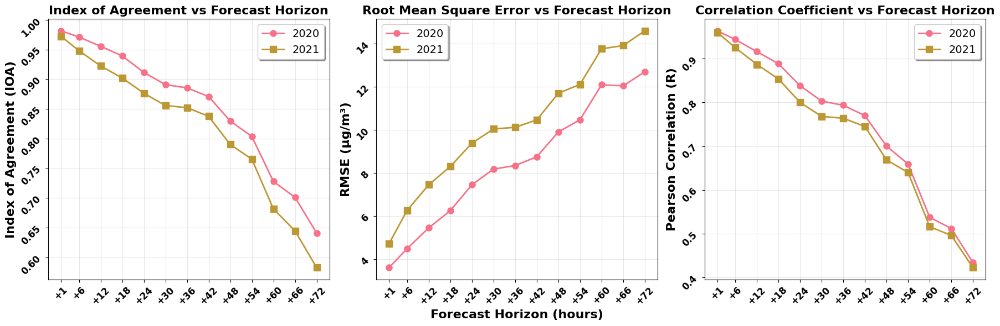


PERFORMANCE METRICS SUMMARY

Forecast Horizon IOA 2020   IOA 2021   RMSE 2020    RMSE 2021    R 2020     R 2021    
--------------------------------------------------------------------------------
1        0.981      0.972      3.62         4.74         0.964      0.960     
6        0.971      0.948      4.50         6.27         0.944      0.925     
12       0.955      0.922      5.46         7.45         0.916      0.887     
18       0.939      0.902      6.26         8.30         0.889      0.854     
24       0.911      0.876      7.46         9.38         0.838      0.800     
30       0.891      0.856      8.18         10.04        0.803      0.768     
36       0.885      0.852      8.35         10.12        0.794      0.764     
42       0.871      0.838      8.75         10.46        0.770      0.745     
48       0.830      0.790      9.90         11.69        0.700      0.669     
54       0.804      0.765      10.47        12.11        0.659      0.640     
60       0.7

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import seaborn as sns

# Define forecast horizons
forecast_horizons = [1, 6, 12, 18, 24, 30, 36, 42, 48, 54, 60, 66, 72]

def calculate_ioa(predictions, actuals):
    """
    Calculate Index of Agreement (IOA) - Willmott's index
    IOA = 1 - (sum((pred - actual)^2) / sum((|pred - mean(actual)| + |actual - mean(actual)|)^2))
    """
    mean_actual = np.mean(actuals)
    numerator = np.sum((predictions - actuals) ** 2)
    denominator = np.sum((np.abs(predictions - mean_actual) + np.abs(actuals - mean_actual)) ** 2)
    
    if denominator == 0:
        return 1.0  # Perfect agreement when both are constant
    
    ioa = 1 - (numerator / denominator)
    return ioa

def calculate_rmse(predictions, actuals):
    """Calculate Root Mean Square Error"""
    return np.sqrt(np.mean((predictions - actuals) ** 2))

def calculate_r_value(predictions, actuals):
    """Calculate Pearson correlation coefficient"""
    # Flatten arrays and remove any NaN values
    pred_flat = predictions.flatten()
    actual_flat = actuals.flatten()
    
    # Remove NaN values
    valid_mask = ~(np.isnan(pred_flat) | np.isnan(actual_flat))
    pred_clean = pred_flat[valid_mask]
    actual_clean = actual_flat[valid_mask]
    
    if len(pred_clean) == 0:
        return 0.0
    
    r_value, _ = pearsonr(pred_clean, actual_clean)
    return r_value

def calculate_metrics_for_horizons(predictions, actuals, horizons):
    """Calculate metrics for specified forecast horizons"""
    ioa_values = []
    rmse_values = []
    r_values = []
    
    for horizon in horizons:
        # Extract data for this horizon (horizon-1 for 0-based indexing)
        horizon_idx = horizon - 1
        
        if horizon_idx < predictions.shape[1]:
            pred_horizon = predictions[:, horizon_idx, :]  # Shape: (samples, stations)
            actual_horizon = actuals[:, horizon_idx, :]
            
            # Flatten across samples and stations
            pred_flat = pred_horizon.flatten()
            actual_flat = actual_horizon.flatten()
            
            # Remove any NaN or infinite values
            valid_mask = np.isfinite(pred_flat) & np.isfinite(actual_flat)
            pred_valid = pred_flat[valid_mask]
            actual_valid = actual_flat[valid_mask]
            
            if len(pred_valid) > 0:
                ioa = calculate_ioa(pred_valid, actual_valid)
                rmse = calculate_rmse(pred_valid, actual_valid)
                r_val = calculate_r_value(pred_valid, actual_valid)
            else:
                ioa = rmse = r_val = np.nan
        else:
            ioa = rmse = r_val = np.nan
        
        ioa_values.append(ioa)
        rmse_values.append(rmse)
        r_values.append(r_val)
    
    return np.array(ioa_values), np.array(rmse_values), np.array(r_values)

# Calculate metrics for both years
print("Calculating metrics for 2020...")
ioa_2020, rmse_2020, r_2020 = calculate_metrics_for_horizons(predictions_2020, actuals_2020, forecast_horizons)

print("Calculating metrics for 2021...")
ioa_2021, rmse_2021, r_2021 = calculate_metrics_for_horizons(predictions_2021, actuals_2021, forecast_horizons)

# Set up the plotting style
plt.style.use('default')
sns.set_palette("husl")

# Create subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot IOA
axes[0].plot(forecast_horizons, ioa_2020, 'o-', linewidth=2, markersize=8, label='2020')
axes[0].plot(forecast_horizons, ioa_2021, 's-', linewidth=2, markersize=8, label='2021')
# axes[0].set_xlabel('Forecast Horizon (hours)', fontsize=16, fontweight='bold')
axes[0].set_ylabel('Index of Agreement (IOA)', fontsize=16, fontweight='bold')
axes[0].set_title('Index of Agreement vs Forecast Horizon', fontsize=16, fontweight='bold')
axes[0].legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
axes[0].grid(True, alpha=0.3)
axes[0].set_xticks(forecast_horizons)
axes[0].set_xticklabels([f'+{h}' for h in forecast_horizons])
axes[0].tick_params(axis='both', rotation=45, which='major', labelsize=12)
for label in axes[0].get_xticklabels() + axes[0].get_yticklabels():
    label.set_fontweight('bold')

# Plot RMSE
axes[1].plot(forecast_horizons, rmse_2020, 'o-', linewidth=2, markersize=8, label='2020')
axes[1].plot(forecast_horizons, rmse_2021, 's-', linewidth=2, markersize=8, label='2021')
axes[1].set_xlabel('Forecast Horizon (hours)', fontsize=16, fontweight='bold')
axes[1].set_ylabel('RMSE (μg/m³)', fontsize=16, fontweight='bold')
axes[1].set_title('Root Mean Square Error vs Forecast Horizon', fontsize=16, fontweight='bold')
axes[1].legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
axes[1].grid(True, alpha=0.3)
axes[1].set_xticks(forecast_horizons)
axes[1].set_xticklabels([f'+{h}' for h in forecast_horizons])
axes[1].tick_params(axis='both', rotation=45, which='major', labelsize=12)
for label in axes[1].get_xticklabels() + axes[1].get_yticklabels():
    label.set_fontweight('bold')

# Plot R values
axes[2].plot(forecast_horizons, r_2020, 'o-', linewidth=2, markersize=8, label='2020')
axes[2].plot(forecast_horizons, r_2021, 's-', linewidth=2, markersize=8, label='2021')
# axes[2].set_xlabel('Forecast Horizon (hours)', fontsize=16, fontweight='bold')
axes[2].set_ylabel('Pearson Correlation (R)', fontsize=16, fontweight='bold')
axes[2].set_title('Correlation Coefficient vs Forecast Horizon', fontsize=16, fontweight='bold')
axes[2].legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
axes[2].grid(True, alpha=0.3)
axes[2].set_xticks(forecast_horizons)
axes[2].set_xticklabels([f'+{h}' for h in forecast_horizons])
axes[2].tick_params(axis='both', rotation=45, which='major', labelsize=12)
for label in axes[2].get_xticklabels() + axes[2].get_yticklabels():
    label.set_fontweight('bold')

# axes.set_xlabel('Forecast Horizon (hours)', fontsize=16, fontweight='bold')

# Adjust layout
plt.tight_layout()
plt.savefig('TransNet_2020_2021.png', dpi=300, bbox_inches='tight', 
            facecolor='white', edgecolor='none')
plt.show()

# Print summary statistics
print("\n" + "="*80)
print("PERFORMANCE METRICS SUMMARY")
print("="*80)

print(f"\n{'Forecast Horizon':<8} {'IOA 2020':<10} {'IOA 2021':<10} {'RMSE 2020':<12} {'RMSE 2021':<12} {'R 2020':<10} {'R 2021':<10}")
print("-" * 80)

for i, horizon in enumerate(forecast_horizons):
    print(f"{horizon:<8} {ioa_2020[i]:<10.3f} {ioa_2021[i]:<10.3f} {rmse_2020[i]:<12.2f} {rmse_2021[i]:<12.2f} {r_2020[i]:<10.3f} {r_2021[i]:<10.3f}")

# Calculate and display average performance
print("\n" + "="*50)
print("AVERAGE PERFORMANCE ACROSS ALL HORIZONS")
print("="*50)
print(f"2020 - Average IOA: {np.nanmean(ioa_2020):.3f}, Average RMSE: {np.nanmean(rmse_2020):.2f}, Average R: {np.nanmean(r_2020):.3f}")
print(f"2021 - Average IOA: {np.nanmean(ioa_2021):.3f}, Average RMSE: {np.nanmean(rmse_2021):.2f}, Average R: {np.nanmean(r_2021):.3f}")


print("\n" + "="*80)
print("MEAN PM2.5 VALUES (μg/m³) FOR EACH FORECAST HOUR")
print("="*80)
print(f"{'Forecast Hour':<15} {'Obs 2020':<12} {'Pred 2020':<12} {'Obs 2021':<12} {'Pred 2021':<12}")
print("-" * 80)

for horizon in forecast_horizons:
    idx = horizon - 1
    if idx < predictions_2020.shape[1]:
        # Extract for 2020
        pred_2020 = predictions_2020[:, idx, :].flatten()
        obs_2020 = actuals_2020[:, idx, :].flatten()

        # Extract for 2021
        pred_2021 = predictions_2021[:, idx, :].flatten()
        obs_2021 = actuals_2021[:, idx, :].flatten()

        # Remove NaNs and infs
        valid_2020 = np.isfinite(pred_2020) & np.isfinite(obs_2020)
        valid_2021 = np.isfinite(pred_2021) & np.isfinite(obs_2021)

        mean_obs_2020 = np.mean(obs_2020[valid_2020])
        mean_pred_2020 = np.mean(pred_2020[valid_2020])
        mean_obs_2021 = np.mean(obs_2021[valid_2021])
        mean_pred_2021 = np.mean(pred_2021[valid_2021])

        print(f"{f'+{horizon}h':<15} {mean_obs_2020:<12.2f} {mean_pred_2020:<12.2f} {mean_obs_2021:<12.2f} {mean_pred_2021:<12.2f}")
    else:
        print(f"{f'+{horizon}h':<15} {'N/A':<12} {'N/A':<12} {'N/A':<12} {'N/A':<12}")


In [10]:
print("\n" + "="*80)
print("MEAN PM2.5 VALUES (μg/m³) FOR EACH FORECAST HOUR")
print("="*80)
print(f"{'Forecast Hour':<15} {'Obs 2020':<12} {'Pred 2020':<12} {'Obs 2021':<12} {'Pred 2021':<12}")
print("-" * 80)

for horizon in forecast_horizons:
    idx = horizon - 1
    if idx < predictions_2020.shape[1]:
        # Extract for 2020
        pred_2020 = predictions_2020[:, idx, :].flatten()
        obs_2020 = actuals_2020[:, idx, :].flatten()

        # Extract for 2021
        pred_2021 = predictions_2021[:, idx, :].flatten()
        obs_2021 = actuals_2021[:, idx, :].flatten()

        # Remove NaNs and infs
        valid_2020 = np.isfinite(pred_2020) & np.isfinite(obs_2020)
        valid_2021 = np.isfinite(pred_2021) & np.isfinite(obs_2021)

        mean_obs_2020 = np.mean(obs_2020[valid_2020])
        mean_pred_2020 = np.mean(pred_2020[valid_2020])
        mean_obs_2021 = np.mean(obs_2021[valid_2021])
        mean_pred_2021 = np.mean(pred_2021[valid_2021])

        print(f"{f'+{horizon}h':<15} {mean_obs_2020:<12.2f} {mean_pred_2020:<12.2f} {mean_obs_2021:<12.2f} {mean_pred_2021:<12.2f}")
    else:
        print(f"{f'+{horizon}h':<15} {'N/A':<12} {'N/A':<12} {'N/A':<12} {'N/A':<12}")



MEAN PM2.5 VALUES (μg/m³) FOR EACH FORECAST HOUR
Forecast Hour   Obs 2020     Pred 2020    Obs 2021     Pred 2021   
--------------------------------------------------------------------------------
+1h             18.54        18.37        17.66        16.84       
+6h             18.54        18.28        17.67        16.94       
+12h            18.55        18.23        17.68        17.11       
+18h            18.55        18.14        17.69        16.60       
+24h            18.54        18.56        17.69        16.70       
+30h            18.52        18.69        17.69        16.43       
+36h            18.49        18.20        17.68        16.43       
+42h            18.47        18.16        17.68        16.35       
+48h            18.45        18.37        17.67        16.36       
+54h            18.43        18.26        17.66        16.09       
+60h            18.40        18.31        17.65        15.56       
+66h            18.39        17.62        17.64      

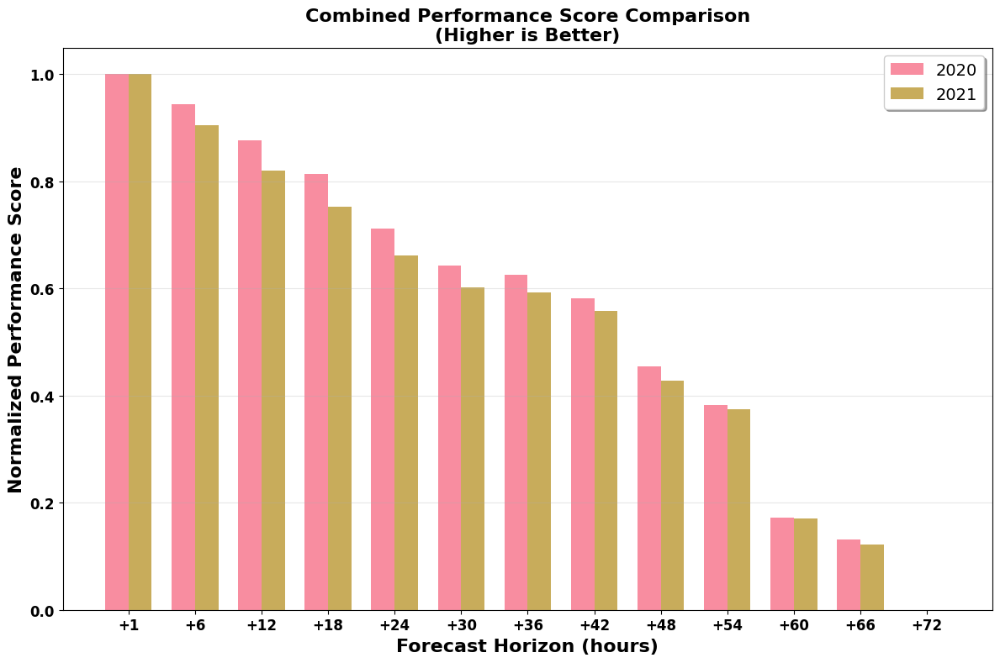

In [7]:
# Create a combined comparison plot
fig, ax = plt.subplots(figsize=(12, 8))

# Create bar plot for better comparison
x = np.arange(len(forecast_horizons))
width = 0.35

# Use different metrics for different subplots, or create a normalized comparison
# Here, let's create a performance score combining all metrics
# Normalize IOA and R (higher is better) and inverse normalize RMSE (lower is better)
def normalize_metrics(ioa, rmse, r):
    # Normalize to 0-1 scale
    ioa_norm = (ioa - np.nanmin(ioa)) / (np.nanmax(ioa) - np.nanmin(ioa)) if np.nanmax(ioa) != np.nanmin(ioa) else np.ones_like(ioa)
    r_norm = (r - np.nanmin(r)) / (np.nanmax(r) - np.nanmin(r)) if np.nanmax(r) != np.nanmin(r) else np.ones_like(r)
    rmse_norm = 1 - (rmse - np.nanmin(rmse)) / (np.nanmax(rmse) - np.nanmin(rmse)) if np.nanmax(rmse) != np.nanmin(rmse) else np.ones_like(rmse)
    
    # Combined score (equal weights)
    combined_score = (ioa_norm + r_norm + rmse_norm) / 3
    return combined_score

score_2020 = normalize_metrics(ioa_2020, rmse_2020, r_2020)
score_2021 = normalize_metrics(ioa_2021, rmse_2021, r_2021)

ax.bar(x - width/2, score_2020, width, label='2020', alpha=0.8)
ax.bar(x + width/2, score_2021, width, label='2021', alpha=0.8)

ax.set_xlabel('Forecast Horizon (hours)', fontsize=16, fontweight='bold')
ax.set_ylabel('Normalized Performance Score', fontsize=16, fontweight='bold')
ax.set_title('Combined Performance Score Comparison\n(Higher is Better)', fontsize=16, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels([f'+{h}' for h in forecast_horizons])
ax.legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
ax.grid(True, alpha=0.3, axis='y')
ax.tick_params(axis='both', which='major', labelsize=12)
for label in ax.get_xticklabels() + ax.get_yticklabels():
    label.set_fontweight('bold')

plt.tight_layout()
plt.show()

Analyzing station characteristics for 2020...

Selected Stations:
Station with Maximum PM2.5: 83 (Max value: 185.04 μg/m³)
Station with Maximum Variability: 85 (Std Dev: 18.89 μg/m³)
Station with Minimum Cumulative PM2.5: 147 (Cumulative: 7718673.00 μg/m³)


/tmp/ipykernel_2115715/756711506.py:65: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time_index = pd.date_range(start=start_datetime, periods=len(pred_timeseries), freq='H')


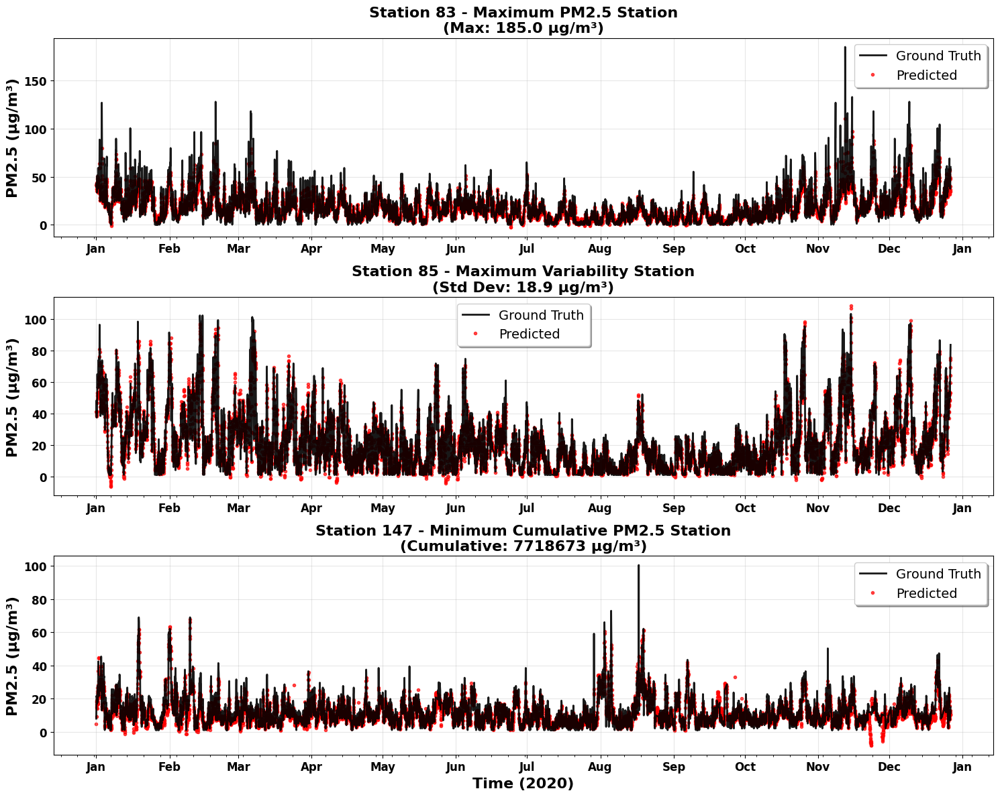


PERFORMANCE METRICS FOR SELECTED STATIONS (2020)
Station  Type                      RMSE       MAE        Bias       Correlation 
--------------------------------------------------------------------------------
83       Maximum PM2.5             15.13      10.58      -2.06      0.510       
85       Maximum Variability       10.99      7.34       -0.47      0.814       
147      Minimum Cumulative PM2.5  7.30       5.00       -2.77      0.652       

Creating detailed view for January 2020...


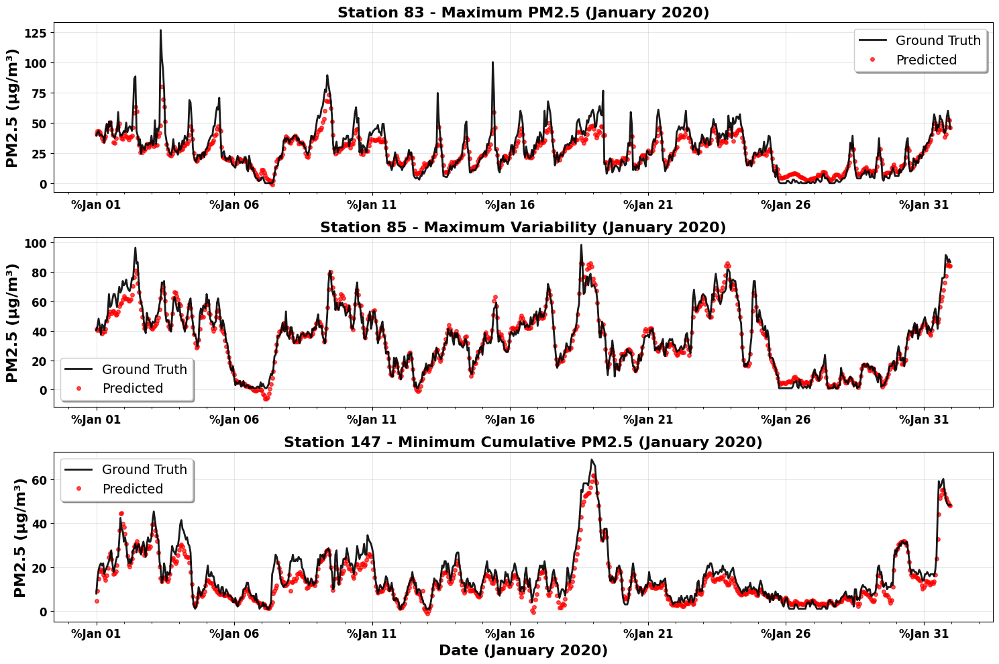


Time series plots completed for 2020 data.
Full year view and detailed January view have been generated.
Selected stations represent different PM2.5 characteristics:
- Station 83: Highest pollution levels
- Station 85: Most variable conditions
- Station 147: Cleanest overall conditions


In [6]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta
import pandas as pd

def find_station_indices(actuals_2020):
    """
    Find station indices based on the specified criteria:
    1. Station with maximum PM2.5 value
    2. Station with maximum variability (standard deviation)
    3. Station with minimum cumulative PM2.5
    """
    samples, horizons, stations = actuals_2020.shape
    
    # Flatten data for each station analysis
    station_stats = []
    
    for station_idx in range(stations):
        station_data = actuals_2020[:, :, station_idx].flatten()
        # Remove NaN values for calculations
        station_data_clean = station_data[~np.isnan(station_data)]
        
        if len(station_data_clean) > 0:
            max_pm25 = np.max(station_data_clean)
            std_pm25 = np.std(station_data_clean)
            cumulative_pm25 = np.sum(station_data_clean)
        else:
            max_pm25 = std_pm25 = cumulative_pm25 = 0
        
        station_stats.append({
            'station_idx': station_idx,
            'max_pm25': max_pm25,
            'std_pm25': std_pm25,
            'cumulative_pm25': cumulative_pm25
        })
    
    # Find stations based on criteria
    max_pm25_station = max(station_stats, key=lambda x: x['max_pm25'])['station_idx']
    max_variability_station = max(station_stats, key=lambda x: x['std_pm25'])['station_idx']
    min_cumulative_station = min(station_stats, key=lambda x: x['cumulative_pm25'])['station_idx']
    
    return max_pm25_station, max_variability_station, min_cumulative_station, station_stats

def create_time_series_data(predictions, actuals, station_idx, start_date='2020-01-01'):
    """
    Create time series data for a specific station
    """
    samples, horizons, _ = predictions.shape
    
    # Extract data for the specific station
    pred_station = predictions[:, :, station_idx]  # Shape: (samples, horizons)
    actual_station = actuals[:, :, station_idx]    # Shape: (samples, horizons)
    
    # Create time series - assuming each sample represents a different forecast initialization
    # and horizons represent forecast lead times
    
    # For visualization, let's take the first forecast horizon (1-hour ahead) for each sample
    # This gives us a time series of 1-hour ahead forecasts
    pred_timeseries = pred_station[:, 0]  # First horizon for each sample
    actual_timeseries = actual_station[:, 0]
    
    # Create datetime index
    start_datetime = pd.to_datetime(start_date)
    time_index = pd.date_range(start=start_datetime, periods=len(pred_timeseries), freq='H')
    
    return time_index, pred_timeseries, actual_timeseries

# Find the three stations based on criteria
print("Analyzing station characteristics for 2020...")
max_pm25_idx, max_var_idx, min_cum_idx, station_stats = find_station_indices(actuals_2020)

print(f"\nSelected Stations:")
print(f"Station with Maximum PM2.5: {max_pm25_idx} (Max value: {station_stats[max_pm25_idx]['max_pm25']:.2f} μg/m³)")
print(f"Station with Maximum Variability: {max_var_idx} (Std Dev: {station_stats[max_var_idx]['std_pm25']:.2f} μg/m³)")
print(f"Station with Minimum Cumulative PM2.5: {min_cum_idx} (Cumulative: {station_stats[min_cum_idx]['cumulative_pm25']:.2f} μg/m³)")

# Create time series data for each selected station
time_idx_1, pred_1, actual_1 = create_time_series_data(predictions_2020, actuals_2020, max_pm25_idx)
time_idx_2, pred_2, actual_2 = create_time_series_data(predictions_2020, actuals_2020, max_var_idx)
time_idx_3, pred_3, actual_3 = create_time_series_data(predictions_2020, actuals_2020, min_cum_idx)

# Create the time series plots
fig, axes = plt.subplots(3, 1, figsize=(15, 12))

# Station 1: Maximum PM2.5
axes[0].plot(time_idx_1, actual_1, 'k-', linewidth=2, alpha=0.9, label='Ground Truth', zorder=2)
axes[0].plot(time_idx_1, pred_1, 'ro', markersize=3, alpha=0.7, label='Predicted', zorder=1)
axes[0].set_ylabel('PM2.5 (μg/m³)', fontsize=16, fontweight='bold')
axes[0].set_title(f'Station {max_pm25_idx} - Maximum PM2.5 Station\n(Max: {station_stats[max_pm25_idx]["max_pm25"]:.1f} μg/m³)', 
                 fontsize=16, fontweight='bold')
axes[0].legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
axes[0].grid(True, alpha=0.3)
axes[0].tick_params(axis='both', which='major', labelsize=12)
for label in axes[0].get_xticklabels() + axes[0].get_yticklabels():
    label.set_fontweight('bold')

# Station 2: Maximum Variability
axes[1].plot(time_idx_2, actual_2, 'k-', linewidth=2, alpha=0.9, label='Ground Truth', zorder=2)
axes[1].plot(time_idx_2, pred_2, 'ro', markersize=3, alpha=0.7, label='Predicted', zorder=1)
axes[1].set_ylabel('PM2.5 (μg/m³)', fontsize=16, fontweight='bold')
axes[1].set_title(f'Station {max_var_idx} - Maximum Variability Station\n(Std Dev: {station_stats[max_var_idx]["std_pm25"]:.1f} μg/m³)', 
                 fontsize=16, fontweight='bold')
axes[1].legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
axes[1].grid(True, alpha=0.3)
axes[1].tick_params(axis='both', which='major', labelsize=12)
for label in axes[1].get_xticklabels() + axes[1].get_yticklabels():
    label.set_fontweight('bold')

# Station 3: Minimum Cumulative PM2.5
axes[2].plot(time_idx_3, actual_3, 'k-', linewidth=2, alpha=0.9, label='Ground Truth', zorder=2)
axes[2].plot(time_idx_3, pred_3, 'ro', markersize=3, alpha=0.7, label='Predicted', zorder=1)
axes[2].set_xlabel('Time (2020)', fontsize=16, fontweight='bold')
axes[2].set_ylabel('PM2.5 (μg/m³)', fontsize=16, fontweight='bold')
axes[2].set_title(f'Station {min_cum_idx} - Minimum Cumulative PM2.5 Station\n(Cumulative: {station_stats[min_cum_idx]["cumulative_pm25"]:.0f} μg/m³)', 
                 fontsize=16, fontweight='bold')
axes[2].legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
axes[2].grid(True, alpha=0.3)
axes[2].tick_params(axis='both', which='major', labelsize=12)
for label in axes[2].get_xticklabels() + axes[2].get_yticklabels():
    label.set_fontweight('bold')

# Format x-axis to show months
for ax in axes:
    ax.xaxis.set_major_locator(mdates.MonthLocator())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%b'))
    ax.xaxis.set_minor_locator(mdates.WeekdayLocator())

plt.tight_layout()
plt.show()

# Calculate and display performance metrics for these stations
def calculate_station_metrics(predictions, actuals, station_idx):
    """Calculate performance metrics for a specific station"""
    pred_station = predictions[:, :, station_idx].flatten()
    actual_station = actuals[:, :, station_idx].flatten()
    
    # Remove NaN values
    valid_mask = ~(np.isnan(pred_station) | np.isnan(actual_station))
    pred_clean = pred_station[valid_mask]
    actual_clean = actual_station[valid_mask]
    
    if len(pred_clean) > 0:
        rmse = np.sqrt(np.mean((pred_clean - actual_clean) ** 2))
        mae = np.mean(np.abs(pred_clean - actual_clean))
        bias = np.mean(pred_clean - actual_clean)
        correlation = np.corrcoef(pred_clean, actual_clean)[0, 1] if len(pred_clean) > 1 else 0
        
        return rmse, mae, bias, correlation
    else:
        return np.nan, np.nan, np.nan, np.nan

print("\n" + "="*80)
print("PERFORMANCE METRICS FOR SELECTED STATIONS (2020)")
print("="*80)

stations_info = [
    (max_pm25_idx, "Maximum PM2.5"),
    (max_var_idx, "Maximum Variability"), 
    (min_cum_idx, "Minimum Cumulative PM2.5")
]

print(f"{'Station':<8} {'Type':<25} {'RMSE':<10} {'MAE':<10} {'Bias':<10} {'Correlation':<12}")
print("-" * 80)

for station_idx, station_type in stations_info:
    rmse, mae, bias, corr = calculate_station_metrics(predictions_2020, actuals_2020, station_idx)
    print(f"{station_idx:<8} {station_type:<25} {rmse:<10.2f} {mae:<10.2f} {bias:<10.2f} {corr:<12.3f}")

# Create a detailed view for a specific month (e.g., January 2020)
print(f"\nCreating detailed view for January 2020...")

# Select January data (first ~744 hours)
jan_length = min(744, len(time_idx_1))  # 31 days * 24 hours, or available data

fig, axes = plt.subplots(3, 1, figsize=(15, 10))

# Detailed January plots
for i, (station_idx, station_type) in enumerate(stations_info):
    time_idx, pred_ts, actual_ts = create_time_series_data(predictions_2020, actuals_2020, station_idx)
    
    # Extract January data
    jan_time = time_idx[:jan_length]
    jan_actual = actual_ts[:jan_length]
    jan_pred = pred_ts[:jan_length]
    
    axes[i].plot(jan_time, jan_actual, 'k-', linewidth=2, alpha=0.9, label='Ground Truth', zorder=2)
    axes[i].plot(jan_time, jan_pred, 'ro', markersize=4, alpha=0.7, label='Predicted', zorder=1)
    axes[i].set_ylabel('PM2.5 (μg/m³)', fontsize=16, fontweight='bold')
    axes[i].set_title(f'Station {station_idx} - {station_type} (January 2020)', 
                     fontsize=16, fontweight='bold')
    axes[i].legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
    axes[i].grid(True, alpha=0.3)
    axes[i].tick_params(axis='both', which='major', labelsize=12)
    for label in axes[i].get_xticklabels() + axes[i].get_yticklabels():
        label.set_fontweight('bold')
    
    # Format x-axis to show days
    axes[i].xaxis.set_major_locator(mdates.DayLocator(interval=5))
    axes[i].xaxis.set_major_formatter(mdates.DateFormatter('%Jan %d'))
    axes[i].xaxis.set_minor_locator(mdates.DayLocator())

axes[2].set_xlabel('Date (January 2020)', fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()

print(f"\nTime series plots completed for 2020 data.")
print(f"Full year view and detailed January view have been generated.")
print(f"Selected stations represent different PM2.5 characteristics:")
print(f"- Station {max_pm25_idx}: Highest pollution levels")
print(f"- Station {max_var_idx}: Most variable conditions") 
print(f"- Station {min_cum_idx}: Cleanest overall conditions")

Analyzing stations and selecting best performers in each category...

CANDIDATE ANALYSIS:

Top 5 High PM2.5 Stations:
Station  Max PM2.5    RMSE     R        IOA      Score   
------------------------------------------------------------
83       185.0        15.13    0.510    0.667    0.559   
135      167.3        8.91     0.635    0.795    0.643   
72       147.7        15.25    0.575    0.695    0.590   
37       141.8        13.25    0.576    0.728    0.601   
84       141.8        9.44     0.768    0.873    0.714   

Top 5 High Variability Stations:
Station  Std Dev      RMSE     R        IOA      Score   
------------------------------------------------------------
85       18.9         10.99    0.814    0.891    0.735   
72       18.4         15.25    0.575    0.695    0.590   
86       18.2         10.60    0.816    0.893    0.736   
64       17.4         9.96     0.821    0.900    0.740   
83       17.3         15.13    0.510    0.667    0.559   

Top 5 Low Cumulative PM2.5 St

/tmp/ipykernel_1494262/2074179005.py:119: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time_index = pd.date_range(start=start_datetime, periods=len(pred_timeseries), freq='H')


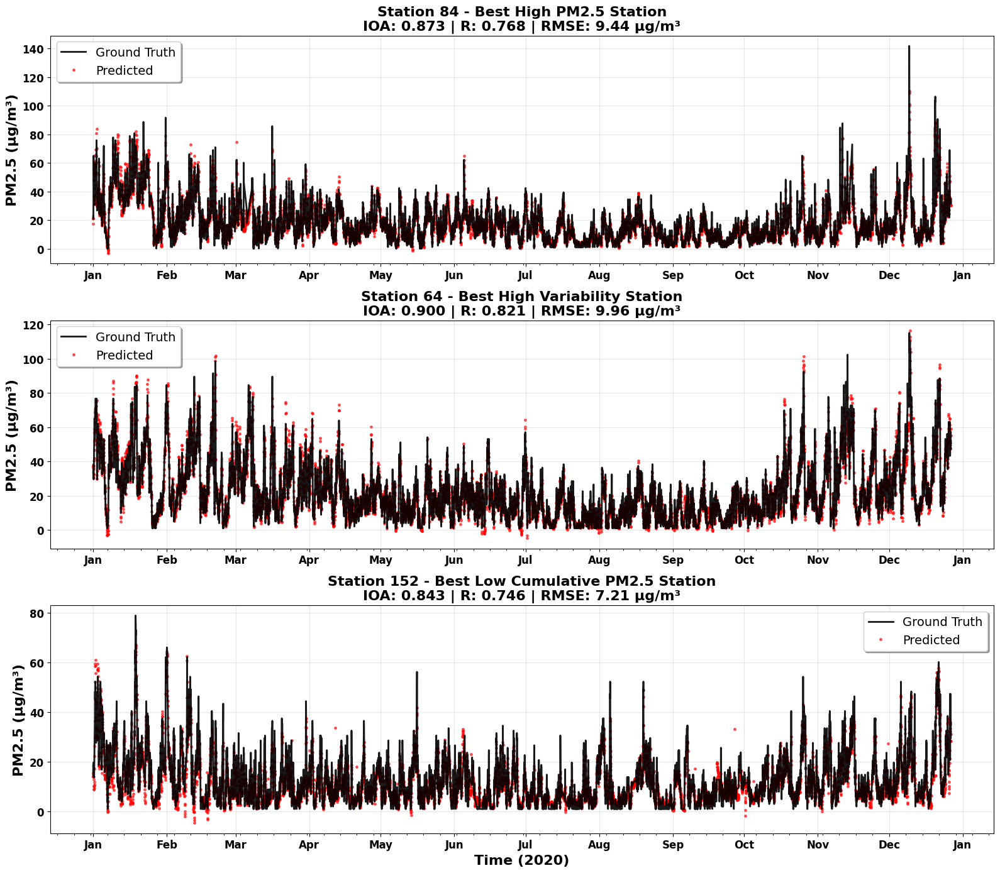


Creating detailed January 2020 view...


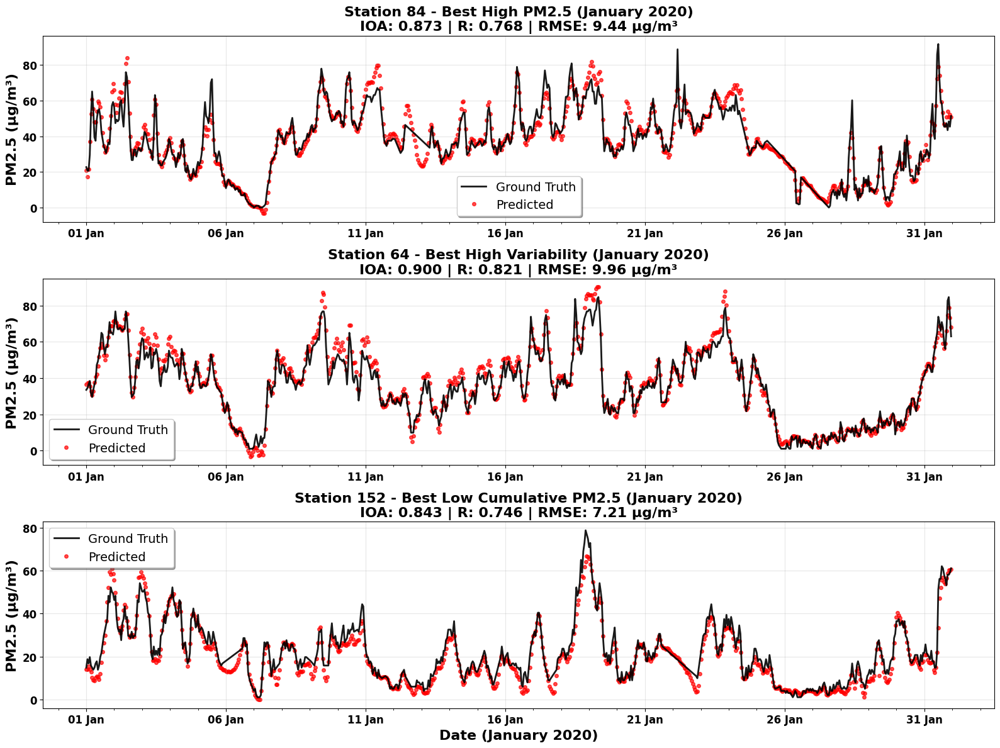


FINAL SELECTED STATIONS - COMPREHENSIVE METRICS
Category             Station  Max PM2.5  Std Dev    Cumulative   RMSE     MAE      R        IOA      Score   
----------------------------------------------------------------------------------------------------
High PM2.5           84       141.8      14.2       11855602     9.44     6.28     0.768    0.873    0.714   
High Variability     64       115.2      17.4       14218382     9.96     6.76     0.821    0.900    0.740   
Low Cumulative       152      78.8       10.1       7874712      7.21     4.89     0.746    0.843    0.696   

Selection Process:
1. Identified top 5 candidates in each category based on PM2.5 characteristics
2. Calculated comprehensive performance metrics (IOA, R, RMSE) for all candidates
3. Selected the best performing station from each category based on combined performance score
4. Performance score combines IOA, |R|, and normalized RMSE (higher is better)


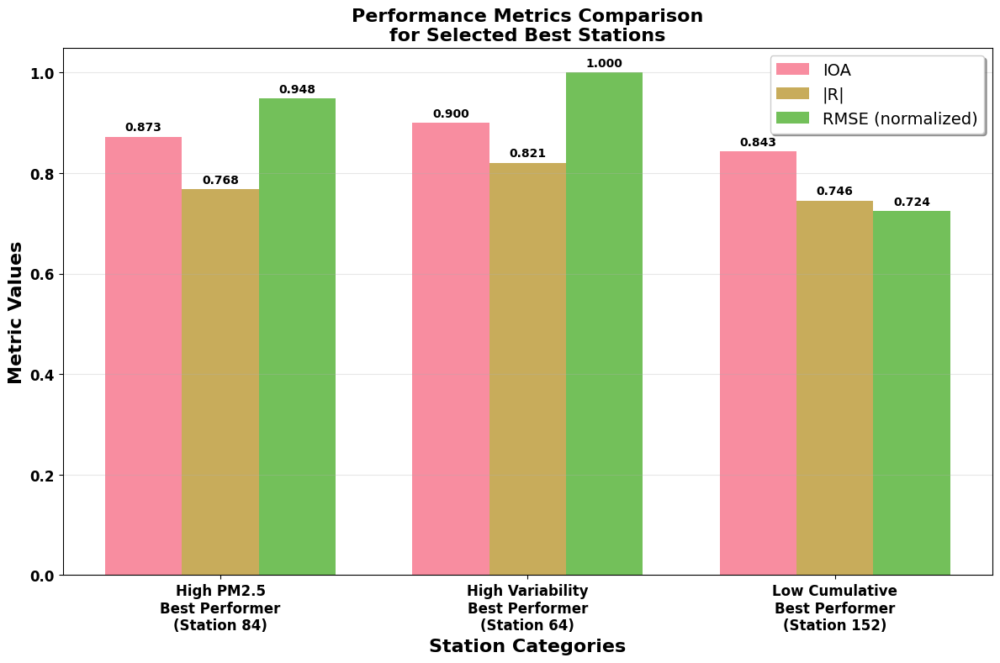


Analysis completed. Selected stations represent optimal balance of:
- Station characteristics (pollution levels, variability, cleanliness)
- Model performance (high IOA, strong correlation, low RMSE)
- Visual clarity for time series analysis


In [11]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta
import pandas as pd
from scipy.stats import pearsonr

def calculate_ioa(predictions, actuals):
    """Calculate Index of Agreement (IOA) - Willmott's index"""
    mean_actual = np.mean(actuals)
    numerator = np.sum((predictions - actuals) ** 2)
    denominator = np.sum((np.abs(predictions - mean_actual) + np.abs(actuals - mean_actual)) ** 2)
    
    if denominator == 0:
        return 1.0  # Perfect agreement when both are constant
    
    ioa = 1 - (numerator / denominator)
    return ioa

def calculate_station_metrics(predictions, actuals, station_idx):
    """Calculate comprehensive performance metrics for a specific station"""
    pred_station = predictions[:, :, station_idx].flatten()
    actual_station = actuals[:, :, station_idx].flatten()
    
    # Remove NaN values
    valid_mask = ~(np.isnan(pred_station) | np.isnan(actual_station))
    pred_clean = pred_station[valid_mask]
    actual_clean = actual_station[valid_mask]
    
    if len(pred_clean) > 1:
        rmse = np.sqrt(np.mean((pred_clean - actual_clean) ** 2))
        mae = np.mean(np.abs(pred_clean - actual_clean))
        bias = np.mean(pred_clean - actual_clean)
        correlation = pearsonr(pred_clean, actual_clean)[0]
        ioa = calculate_ioa(pred_clean, actual_clean)
        
        return rmse, mae, bias, correlation, ioa
    else:
        return np.nan, np.nan, np.nan, np.nan, np.nan

def find_candidate_stations(actuals_2020, predictions_2020, top_n=5):
    """
    Find candidate stations for each category and select best performing ones
    """
    samples, horizons, stations = actuals_2020.shape
    
    # Calculate station characteristics and performance metrics
    station_analysis = []
    
    for station_idx in range(stations):
        station_data = actuals_2020[:, :, station_idx].flatten()
        station_data_clean = station_data[~np.isnan(station_data)]
        
        if len(station_data_clean) > 0:
            max_pm25 = np.max(station_data_clean)
            std_pm25 = np.std(station_data_clean)
            cumulative_pm25 = np.sum(station_data_clean)
            mean_pm25 = np.mean(station_data_clean)
        else:
            max_pm25 = std_pm25 = cumulative_pm25 = mean_pm25 = 0
        
        # Calculate performance metrics
        rmse, mae, bias, r_value, ioa = calculate_station_metrics(predictions_2020, actuals_2020, station_idx)
        
        # Combined performance score (higher is better)
        # Normalize metrics: IOA and R are good when high, RMSE is good when low
        performance_score = np.nan
        if not np.isnan(rmse) and not np.isnan(r_value) and not np.isnan(ioa):
            # Normalize RMSE (invert so higher is better)
            rmse_norm = 1 / (1 + rmse/np.nanmean([rmse]))  # Simple normalization
            performance_score = (ioa + abs(r_value) + rmse_norm) / 3
        
        station_analysis.append({
            'station_idx': station_idx,
            'max_pm25': max_pm25,
            'std_pm25': std_pm25,
            'cumulative_pm25': cumulative_pm25,
            'mean_pm25': mean_pm25,
            'rmse': rmse,
            'mae': mae,
            'bias': bias,
            'r_value': r_value,
            'ioa': ioa,
            'performance_score': performance_score
        })
    
    # Filter out stations with invalid metrics
    valid_stations = [s for s in station_analysis if not np.isnan(s['performance_score'])]
    
    # Find top candidates for each category
    # Category 1: High PM2.5 stations
    high_pm25_candidates = sorted(valid_stations, key=lambda x: x['max_pm25'], reverse=True)[:top_n]
    best_high_pm25 = max(high_pm25_candidates, key=lambda x: x['performance_score'])
    
    # Category 2: High variability stations
    high_var_candidates = sorted(valid_stations, key=lambda x: x['std_pm25'], reverse=True)[:top_n]
    best_high_var = max(high_var_candidates, key=lambda x: x['performance_score'])
    
    # Category 3: Low cumulative PM2.5 stations
    low_cum_candidates = sorted(valid_stations, key=lambda x: x['cumulative_pm25'])[:top_n]
    best_low_cum = max(low_cum_candidates, key=lambda x: x['performance_score'])
    
    return best_high_pm25, best_high_var, best_low_cum, high_pm25_candidates, high_var_candidates, low_cum_candidates

def create_time_series_data(predictions, actuals, station_idx, start_date='2020-01-01'):
    """Create time series data for a specific station"""
    samples, horizons, _ = predictions.shape
    
    # Extract data for the specific station
    pred_station = predictions[:, :, station_idx]
    actual_station = actuals[:, :, station_idx]
    
    # Use first forecast horizon for each sample
    pred_timeseries = pred_station[:, 0]
    actual_timeseries = actual_station[:, 0]
    
    # Create datetime index
    start_datetime = pd.to_datetime(start_date)
    time_index = pd.date_range(start=start_datetime, periods=len(pred_timeseries), freq='H')
    
    return time_index, pred_timeseries, actual_timeseries

# Find the best performing stations in each category
print("Analyzing stations and selecting best performers in each category...")
best_high_pm25, best_high_var, best_low_cum, high_candidates, var_candidates, low_candidates = find_candidate_stations(actuals_2020, predictions_2020, top_n=5)

print(f"\nCANDIDATE ANALYSIS:")
print("="*80)

print(f"\nTop 5 High PM2.5 Stations:")
print(f"{'Station':<8} {'Max PM2.5':<12} {'RMSE':<8} {'R':<8} {'IOA':<8} {'Score':<8}")
print("-" * 60)
for candidate in high_candidates:
    print(f"{candidate['station_idx']:<8} {candidate['max_pm25']:<12.1f} {candidate['rmse']:<8.2f} {candidate['r_value']:<8.3f} {candidate['ioa']:<8.3f} {candidate['performance_score']:<8.3f}")

print(f"\nTop 5 High Variability Stations:")
print(f"{'Station':<8} {'Std Dev':<12} {'RMSE':<8} {'R':<8} {'IOA':<8} {'Score':<8}")
print("-" * 60)
for candidate in var_candidates:
    print(f"{candidate['station_idx']:<8} {candidate['std_pm25']:<12.1f} {candidate['rmse']:<8.2f} {candidate['r_value']:<8.3f} {candidate['ioa']:<8.3f} {candidate['performance_score']:<8.3f}")

print(f"\nTop 5 Low Cumulative PM2.5 Stations:")
print(f"{'Station':<8} {'Cumulative':<12} {'RMSE':<8} {'R':<8} {'IOA':<8} {'Score':<8}")
print("-" * 60)
for candidate in low_candidates:
    print(f"{candidate['station_idx']:<8} {candidate['cumulative_pm25']:<12.0f} {candidate['rmse']:<8.2f} {candidate['r_value']:<8.3f} {candidate['ioa']:<8.3f} {candidate['performance_score']:<8.3f}")

print(f"\nSELECTED BEST PERFORMING STATIONS:")
print("="*80)
print(f"Best High PM2.5 Station: {best_high_pm25['station_idx']} (Score: {best_high_pm25['performance_score']:.3f})")
print(f"Best High Variability Station: {best_high_var['station_idx']} (Score: {best_high_var['performance_score']:.3f})")
print(f"Best Low Cumulative Station: {best_low_cum['station_idx']} (Score: {best_low_cum['performance_score']:.3f})")

# Create time series data for selected stations
time_idx_1, pred_1, actual_1 = create_time_series_data(predictions_2020, actuals_2020, best_high_pm25['station_idx'])
time_idx_2, pred_2, actual_2 = create_time_series_data(predictions_2020, actuals_2020, best_high_var['station_idx'])
time_idx_3, pred_3, actual_3 = create_time_series_data(predictions_2020, actuals_2020, best_low_cum['station_idx'])

# Create the time series plots with metrics displayed
fig, axes = plt.subplots(3, 1, figsize=(16, 14))

selected_stations = [
    (best_high_pm25, time_idx_1, pred_1, actual_1, "High PM2.5"),
    (best_high_var, time_idx_2, pred_2, actual_2, "High Variability"),
    (best_low_cum, time_idx_3, pred_3, actual_3, "Low Cumulative PM2.5")
]

for i, (station_info, time_idx, pred_ts, actual_ts, category) in enumerate(selected_stations):
    # Plot time series
    axes[i].plot(time_idx, actual_ts, 'k-', linewidth=2, alpha=0.9, label='Ground Truth', zorder=2)
    axes[i].plot(time_idx, pred_ts, 'ro', markersize=2.5, alpha=0.6, label='Predicted', zorder=1)
    
    # Set labels and title with metrics
    axes[i].set_ylabel('PM2.5 (μg/m³)', fontsize=16, fontweight='bold')
    
    title = (f'Station {station_info["station_idx"]} - Best {category} Station\n'
             f'IOA: {station_info["ioa"]:.3f} | R: {station_info["r_value"]:.3f} | '
             f'RMSE: {station_info["rmse"]:.2f} μg/m³')
    axes[i].set_title(title, fontsize=16, fontweight='bold')
    
    axes[i].legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
    axes[i].grid(True, alpha=0.3)
    axes[i].tick_params(axis='both', which='major', labelsize=12)
    for label in axes[i].get_xticklabels() + axes[i].get_yticklabels():
        label.set_fontweight('bold')
    
    # Format x-axis
    axes[i].xaxis.set_major_locator(mdates.MonthLocator())
    axes[i].xaxis.set_major_formatter(mdates.DateFormatter('%b'))
    axes[i].xaxis.set_minor_locator(mdates.WeekdayLocator())

axes[2].set_xlabel('Time (2020)', fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()

# Create detailed January view
print(f"\nCreating detailed January 2020 view...")

jan_length = min(744, len(time_idx_1))  # 31 days * 24 hours

fig, axes = plt.subplots(3, 1, figsize=(16, 12))

for i, (station_info, time_idx, pred_ts, actual_ts, category) in enumerate(selected_stations):
    # Extract January data
    jan_time = time_idx[:jan_length]
    jan_actual = actual_ts[:jan_length]
    jan_pred = pred_ts[:jan_length]
    
    axes[i].plot(jan_time, jan_actual, 'k-', linewidth=2, alpha=0.9, label='Ground Truth', zorder=2)
    axes[i].plot(jan_time, jan_pred, 'ro', markersize=4, alpha=0.7, label='Predicted', zorder=1)
    
    axes[i].set_ylabel('PM2.5 (μg/m³)', fontsize=16, fontweight='bold')
    
    title = (f'Station {station_info["station_idx"]} - Best {category} (January 2020)\n'
             f'IOA: {station_info["ioa"]:.3f} | R: {station_info["r_value"]:.3f} | '
             f'RMSE: {station_info["rmse"]:.2f} μg/m³')
    axes[i].set_title(title, fontsize=16, fontweight='bold')
    
    axes[i].legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
    axes[i].grid(True, alpha=0.3)
    axes[i].tick_params(axis='both', which='major', labelsize=12)
    for label in axes[i].get_xticklabels() + axes[i].get_yticklabels():
        label.set_fontweight('bold')
    
    # Format x-axis for January
    axes[i].xaxis.set_major_locator(mdates.DayLocator(interval=5))
    axes[i].xaxis.set_major_formatter(mdates.DateFormatter('%d Jan'))
    axes[i].xaxis.set_minor_locator(mdates.DayLocator())

axes[2].set_xlabel('Date (January 2020)', fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()

# Summary table of final selected stations
print("\n" + "="*100)
print("FINAL SELECTED STATIONS - COMPREHENSIVE METRICS")
print("="*100)

print(f"{'Category':<20} {'Station':<8} {'Max PM2.5':<10} {'Std Dev':<10} {'Cumulative':<12} {'RMSE':<8} {'MAE':<8} {'R':<8} {'IOA':<8} {'Score':<8}")
print("-" * 100)

categories = ["High PM2.5", "High Variability", "Low Cumulative"]
selected = [best_high_pm25, best_high_var, best_low_cum]

for category, station in zip(categories, selected):
    print(f"{category:<20} {station['station_idx']:<8} {station['max_pm25']:<10.1f} {station['std_pm25']:<10.1f} {station['cumulative_pm25']:<12.0f} {station['rmse']:<8.2f} {station['mae']:<8.2f} {station['r_value']:<8.3f} {station['ioa']:<8.3f} {station['performance_score']:<8.3f}")

print(f"\nSelection Process:")
print(f"1. Identified top 5 candidates in each category based on PM2.5 characteristics")
print(f"2. Calculated comprehensive performance metrics (IOA, R, RMSE) for all candidates")
print(f"3. Selected the best performing station from each category based on combined performance score")
print(f"4. Performance score combines IOA, |R|, and normalized RMSE (higher is better)")

# Create a performance comparison chart
fig, ax = plt.subplots(figsize=(12, 8))

categories = ['High PM2.5\nBest Performer', 'High Variability\nBest Performer', 'Low Cumulative\nBest Performer']
station_indices = [best_high_pm25['station_idx'], best_high_var['station_idx'], best_low_cum['station_idx']]
ioa_values = [best_high_pm25['ioa'], best_high_var['ioa'], best_low_cum['ioa']]
r_values = [abs(best_high_pm25['r_value']), abs(best_high_var['r_value']), abs(best_low_cum['r_value'])]
rmse_values = [best_high_pm25['rmse'], best_high_var['rmse'], best_low_cum['rmse']]

x = np.arange(len(categories))
width = 0.25

# Create bars
bars1 = ax.bar(x - width, ioa_values, width, label='IOA', alpha=0.8)
bars2 = ax.bar(x, r_values, width, label='|R|', alpha=0.8)
bars3 = ax.bar(x + width, [r/max(rmse_values) for r in rmse_values], width, label='RMSE (normalized)', alpha=0.8)

ax.set_xlabel('Station Categories', fontsize=16, fontweight='bold')
ax.set_ylabel('Metric Values', fontsize=16, fontweight='bold')
ax.set_title('Performance Metrics Comparison\nfor Selected Best Stations', fontsize=16, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels([f'{cat}\n(Station {idx})' for cat, idx in zip(categories, station_indices)])
ax.legend(fontsize=14, frameon=True, fancybox=True, shadow=True)
ax.grid(True, alpha=0.3, axis='y')
ax.tick_params(axis='both', which='major', labelsize=12)
for label in ax.get_xticklabels() + ax.get_yticklabels():
    label.set_fontweight('bold')

# Add value labels on bars
for bars in [bars1, bars2, bars3]:
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'{height:.3f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom', fontweight='bold', fontsize=10)

plt.tight_layout()
plt.show()

print(f"\nAnalysis completed. Selected stations represent optimal balance of:")
print(f"- Station characteristics (pollution levels, variability, cleanliness)")
print(f"- Model performance (high IOA, strong correlation, low RMSE)")
print(f"- Visual clarity for time series analysis")

Using 8664 samples for comparison


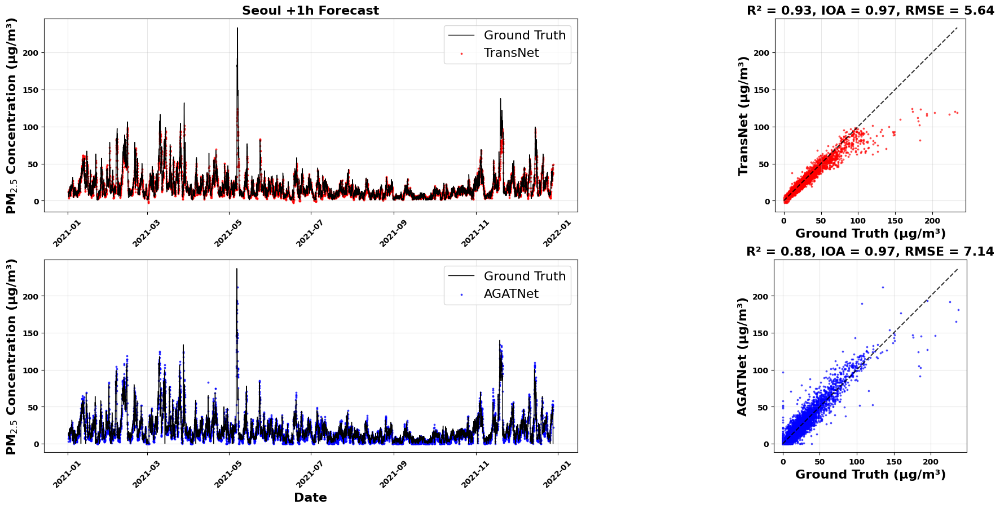

Station 10 Metrics Summary:
TransNet   - R²: 0.930, IOA: 0.974, RMSE: 5.640
AGATNet - R²: 0.883, IOA: 0.968, RMSE: 7.137

Data shapes used:
TransNet predictions: (8664, 72, 170)
AGATNet predictions: (8664, 170, 72)
Number of time points: 8664


In [14]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import pandas as pd
from datetime import datetime, timedelta

def calculate_metrics_with_nan(pred, obs):
    """Calculate IOA, RMSE, and R while handling NaNs"""
    mask = ~(np.isnan(pred) | np.isnan(obs))
    pred_clean = pred[mask]
    obs_clean = obs[mask]

    if len(pred_clean) == 0:
        return np.nan, np.nan, np.nan

    # RMSE
    rmse = np.sqrt(np.mean((pred_clean - obs_clean)**2))

    # R-squared
    if len(pred_clean) > 1:
        r, _ = pearsonr(pred_clean, obs_clean)
        r_squared = r**2
    else:
        r_squared = np.nan

    # IOA (Index of Agreement)
    obs_mean = np.mean(obs_clean)
    numerator = np.sum((pred_clean - obs_clean)**2)
    denominator = np.sum((np.abs(pred_clean - obs_mean) + np.abs(obs_clean - obs_mean))**2)
    ioa = 1 - (numerator / denominator) if denominator != 0 else np.nan

    return r_squared, ioa, rmse

# Use the minimum length to ensure compatibility
min_samples = min(predictions_2021.shape[0], predictions_agatnet.shape[0])
print(f"Using {min_samples} samples for comparison")

# Trim data to same length
predictions_tignn = predictions_2021[:min_samples]  # Shape: (samples, horizons, stations)
actuals_tignn = actuals_2021[:min_samples]
predictions_agatnet_trimmed = predictions_agatnet[:min_samples]  # Shape: (samples, stations, horizons)
actuals_agatnet_trimmed = actuals_agatnet[:min_samples]

# Create datetime index starting from 2021-01-01 13:00
start_date = datetime(2021, 1, 1, 13, 0)
dates = [start_date + timedelta(hours=i) for i in range(min_samples)]

# Select station 10 from Seoul
station_idx = 10

# Create figure with subplots - using gridspec for better control
fig = plt.figure(figsize=(25, 10))
gs = fig.add_gridspec(2, 2, hspace=0.25, wspace=0.05)  # Reduced both spacings

# TiGNN Model (forecast index 0 - 1h prediction)
# Note: predictions_tignn shape is (samples, horizons, stations)
tignn_actual = actuals_tignn[:, 0, station_idx]  # First forecast horizon
tignn_pred = predictions_tignn[:, 0, station_idx]
tignn_r2, tignn_ioa, tignn_rmse = calculate_metrics_with_nan(tignn_pred, tignn_actual)

# Time series plot for TiGNN
ax1 = fig.add_subplot(gs[0, 0])
ax1.plot(dates, tignn_actual, 'k-', linewidth=1, label='Ground Truth')
ax1.scatter(dates, tignn_pred, c='red', s=3, alpha=0.7, label='TransNet')
ax1.set_ylabel(r'PM$_{2.5}$ Concentration (μg/m³)', weight='bold', fontsize=16)
ax1.set_title(f'Seoul +1h Forecast', weight='bold', fontsize=16)
ax1.legend(fontsize=16)
ax1.grid(True, alpha=0.3)
ax1.tick_params(axis='both', which='major', labelsize=10)
# Make tick labels bold
for label in ax1.get_xticklabels() + ax1.get_yticklabels():
    label.set_weight('bold')

# Scatter plot for TiGNN
ax2 = fig.add_subplot(gs[0, 1])
mask = ~(np.isnan(tignn_pred) | np.isnan(tignn_actual))
ax2.scatter(tignn_actual[mask], tignn_pred[mask], c='red', s=3, alpha=0.6)
max_val = max(np.nanmax(tignn_actual), np.nanmax(tignn_pred))
ax2.plot([0, max_val], [0, max_val], 'k--', alpha=0.8)  # 1:1 line
ax2.set_xlabel('Ground Truth (μg/m³)', weight='bold', fontsize=16)
ax2.set_ylabel('TransNet (μg/m³)', weight='bold', fontsize=16)
ax2.set_title(f'R² = {tignn_r2:.2f}, IOA = {tignn_ioa:.2f}, RMSE = {tignn_rmse:.2f}', weight='bold', fontsize=16)
ax2.grid(True, alpha=0.3)
ax2.set_aspect('equal')
ax2.tick_params(axis='both', which='major', labelsize=10)
# Make tick labels bold
for label in ax2.get_xticklabels() + ax2.get_yticklabels():
    label.set_weight('bold')

# AGATNet Model (forecast index 0 - 1h prediction)
# Note: predictions_agatnet shape is (samples, stations, horizons)
agatnet_actual = actuals_agatnet_trimmed[:, station_idx, 0]  # First forecast horizon
agatnet_pred = predictions_agatnet_trimmed[:, station_idx, 0]
agatnet_r2, agatnet_ioa, agatnet_rmse = calculate_metrics_with_nan(agatnet_pred, agatnet_actual)

# Time series plot for AGATNet
ax3 = fig.add_subplot(gs[1, 0])
ax3.plot(dates, agatnet_actual, 'k-', linewidth=1, label='Ground Truth')
ax3.scatter(dates, agatnet_pred, c='blue', s=3, alpha=0.7, label='AGATNet')
ax3.set_xlabel('Date', weight='bold', fontsize=16)
ax3.set_ylabel(r'PM$_{2.5}$ Concentration (μg/m³)', weight='bold', fontsize=16)
# ax3.set_title(f'Seoul - AGATNet Forecast', weight='bold', fontsize=16)            # (Station {station_idx})
ax3.legend(fontsize=16)
ax3.grid(True, alpha=0.3)
ax3.tick_params(axis='both', which='major', labelsize=10)
# Make tick labels bold
for label in ax3.get_xticklabels() + ax3.get_yticklabels():
    label.set_weight('bold')

# Scatter plot for AGATNet
ax4 = fig.add_subplot(gs[1, 1])
mask = ~(np.isnan(agatnet_pred) | np.isnan(agatnet_actual))
ax4.scatter(agatnet_actual[mask], agatnet_pred[mask], c='blue', s=3, alpha=0.6)
max_val = max(np.nanmax(agatnet_actual), np.nanmax(agatnet_pred))
ax4.plot([0, max_val], [0, max_val], 'k--', alpha=0.8)  # 1:1 line
ax4.set_xlabel('Ground Truth (μg/m³)', weight='bold', fontsize=16)
ax4.set_ylabel('AGATNet (μg/m³)', weight='bold', fontsize=16)
ax4.set_title(f'R² = {agatnet_r2:.2f}, IOA = {agatnet_ioa:.2f}, RMSE = {agatnet_rmse:.2f}', weight='bold', fontsize=16)
ax4.grid(True, alpha=0.3)
ax4.set_aspect('equal')
ax4.tick_params(axis='both', which='major', labelsize=10)

for label in ax4.get_xticklabels() + ax4.get_yticklabels():
    label.set_weight('bold')

for ax in [ax1, ax3]:
    ax.tick_params(axis='x', rotation=45)
    # Make x-tick labels bold
    for label in ax.get_xticklabels():
        label.set_weight('bold')
        label.set_rotation(45)

# Save figure in high resolution before showing
# plt.savefig('transnet_agatnet_comparison_plot.png', dpi=300, bbox_inches='tight', 
#             facecolor='white', edgecolor='none')
# plt.savefig('tignn_agatnet_comparison_plot.pdf', dpi=300, bbox_inches='tight', 
#             facecolor='white', edgecolor='none')

plt.show()

print(f"Station {station_idx} Metrics Summary:")
print(f"TransNet   - R²: {tignn_r2:.3f}, IOA: {tignn_ioa:.3f}, RMSE: {tignn_rmse:.3f}")
print(f"AGATNet - R²: {agatnet_r2:.3f}, IOA: {agatnet_ioa:.3f}, RMSE: {agatnet_rmse:.3f}")

# Additional comparison
print(f"\nData shapes used:")
print(f"TransNet predictions: {predictions_tignn.shape}")
print(f"AGATNet predictions: {predictions_agatnet_trimmed.shape}")
print(f"Number of time points: {len(dates)}")

Using 8664 samples for comparison


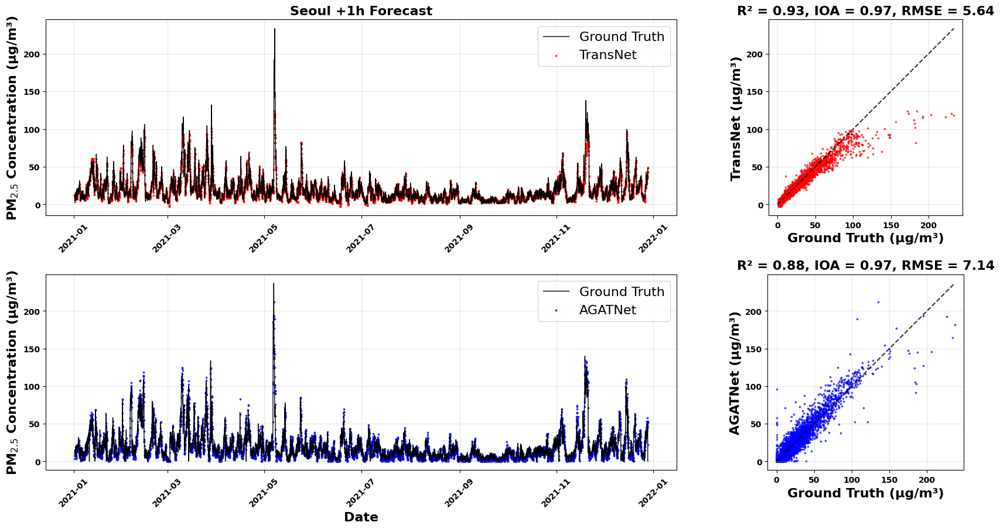

Station 10 Metrics Summary:
TransNet   - R²: 0.930, IOA: 0.974, RMSE: 5.640
AGATNet - R²: 0.883, IOA: 0.968, RMSE: 7.137

Data shapes used:
TransNet predictions: (8664, 72, 170)
AGATNet predictions: (8664, 170, 72)
Number of time points: 8664


In [16]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import pandas as pd
from datetime import datetime, timedelta

def calculate_metrics_with_nan(pred, obs):
    """Calculate IOA, RMSE, and R while handling NaNs"""
    mask = ~(np.isnan(pred) | np.isnan(obs))
    pred_clean = pred[mask]
    obs_clean = obs[mask]

    if len(pred_clean) == 0:
        return np.nan, np.nan, np.nan

    # RMSE
    rmse = np.sqrt(np.mean((pred_clean - obs_clean)**2))

    # R-squared
    if len(pred_clean) > 1:
        r, _ = pearsonr(pred_clean, obs_clean)
        r_squared = r**2
    else:
        r_squared = np.nan

    # IOA (Index of Agreement)
    obs_mean = np.mean(obs_clean)
    numerator = np.sum((pred_clean - obs_clean)**2)
    denominator = np.sum((np.abs(pred_clean - obs_mean) + np.abs(obs_clean - obs_mean))**2)
    ioa = 1 - (numerator / denominator) if denominator != 0 else np.nan

    return r_squared, ioa, rmse

# Use the minimum length to ensure compatibility
min_samples = min(predictions_2021.shape[0], predictions_agatnet.shape[0])
print(f"Using {min_samples} samples for comparison")

# Trim data to same length
predictions_tignn = predictions_2021[:min_samples]  # Shape: (samples, horizons, stations)
actuals_tignn = actuals_2021[:min_samples]
predictions_agatnet_trimmed = predictions_agatnet[:min_samples]  # Shape: (samples, stations, horizons)
actuals_agatnet_trimmed = actuals_agatnet[:min_samples]

# Create datetime index starting from 2021-01-01 13:00
start_date = datetime(2021, 1, 1, 13, 0)
dates = [start_date + timedelta(hours=i) for i in range(min_samples)]

# Select station 10 from Seoul
station_idx = 10

# Create figure with subplots
fig = plt.figure(figsize=(25, 10))

# TiGNN Model (forecast index 0 - 1h prediction)
# Note: predictions_tignn shape is (samples, horizons, stations)
tignn_actual = actuals_tignn[:, 0, station_idx]  # First forecast horizon
tignn_pred = predictions_tignn[:, 0, station_idx]
tignn_r2, tignn_ioa, tignn_rmse = calculate_metrics_with_nan(tignn_pred, tignn_actual)

# Time series plot for TiGNN
ax1 = plt.subplot(2, 2, 1)
ax1.plot(dates, tignn_actual, 'k-', linewidth=1, label='Ground Truth')
ax1.scatter(dates, tignn_pred, c='red', s=3, alpha=0.7, label='TransNet')
ax1.set_ylabel(r'PM$_{2.5}$ Concentration (μg/m³)', weight='bold', fontsize=16)
ax1.set_title(f'Seoul +1h Forecast', weight='bold', fontsize=16)
ax1.legend(fontsize=16)
ax1.grid(True, alpha=0.3)
ax1.tick_params(axis='both', which='major', labelsize=10)
# Make tick labels bold
for label in ax1.get_xticklabels() + ax1.get_yticklabels():
    label.set_weight('bold')

# Scatter plot for TiGNN
ax2 = plt.subplot(2, 2, 2)
mask = ~(np.isnan(tignn_pred) | np.isnan(tignn_actual))
ax2.scatter(tignn_actual[mask], tignn_pred[mask], c='red', s=3, alpha=0.6)
max_val = max(np.nanmax(tignn_actual), np.nanmax(tignn_pred))
ax2.plot([0, max_val], [0, max_val], 'k--', alpha=0.8)  # 1:1 line
ax2.set_xlabel('Ground Truth (μg/m³)', weight='bold', fontsize=16)
ax2.set_ylabel('TransNet (μg/m³)', weight='bold', fontsize=16)
ax2.set_title(f'R² = {tignn_r2:.2f}, IOA = {tignn_ioa:.2f}, RMSE = {tignn_rmse:.2f}', weight='bold', fontsize=16)
ax2.grid(True, alpha=0.3)
ax2.set_aspect('equal')
ax2.tick_params(axis='both', which='major', labelsize=10)
# Make tick labels bold
for label in ax2.get_xticklabels() + ax2.get_yticklabels():
    label.set_weight('bold')

# AGATNet Model (forecast index 0 - 1h prediction)
# Note: predictions_agatnet shape is (samples, stations, horizons)
agatnet_actual = actuals_agatnet_trimmed[:, station_idx, 0]  # First forecast horizon
agatnet_pred = predictions_agatnet_trimmed[:, station_idx, 0]
agatnet_r2, agatnet_ioa, agatnet_rmse = calculate_metrics_with_nan(agatnet_pred, agatnet_actual)

# Time series plot for AGATNet
ax3 = plt.subplot(2, 2, 3)
ax3.plot(dates, agatnet_actual, 'k-', linewidth=1, label='Ground Truth')
ax3.scatter(dates, agatnet_pred, c='blue', s=3, alpha=0.7, label='AGATNet')
ax3.set_xlabel('Date', weight='bold', fontsize=16)
ax3.set_ylabel(r'PM$_{2.5}$ Concentration (μg/m³)', weight='bold', fontsize=16)
# ax3.set_title(f'Seoul - AGATNet Forecast', weight='bold', fontsize=16)            # (Station {station_idx})
ax3.legend(fontsize=16)
ax3.grid(True, alpha=0.3)
ax3.tick_params(axis='both', which='major', labelsize=10)
# Make tick labels bold
for label in ax3.get_xticklabels() + ax3.get_yticklabels():
    label.set_weight('bold')

# Scatter plot for AGATNet
ax4 = plt.subplot(2, 2, 4)
mask = ~(np.isnan(agatnet_pred) | np.isnan(agatnet_actual))
ax4.scatter(agatnet_actual[mask], agatnet_pred[mask], c='blue', s=3, alpha=0.6)
max_val = max(np.nanmax(agatnet_actual), np.nanmax(agatnet_pred))
ax4.plot([0, max_val], [0, max_val], 'k--', alpha=0.8)  # 1:1 line
ax4.set_xlabel('Ground Truth (μg/m³)', weight='bold', fontsize=16)
ax4.set_ylabel('AGATNet (μg/m³)', weight='bold', fontsize=16)
ax4.set_title(f'R² = {agatnet_r2:.2f}, IOA = {agatnet_ioa:.2f}, RMSE = {agatnet_rmse:.2f}', weight='bold', fontsize=16)
ax4.grid(True, alpha=0.3)
ax4.set_aspect('equal')
ax4.tick_params(axis='both', which='major', labelsize=10)

for label in ax4.get_xticklabels() + ax4.get_yticklabels():
    label.set_weight('bold')

for ax in [ax1, ax3]:
    ax.tick_params(axis='x', rotation=45)
    # Make x-tick labels bold
    for label in ax.get_xticklabels():
        label.set_weight('bold')
        label.set_rotation(45)

# Adjust spacing and save high resolution figure
plt.subplots_adjust(hspace=0.30, wspace=-0.2)

# Save figure in high resolution before showing
plt.savefig('transnet_agatnet_comparison_plot.png', dpi=300, bbox_inches='tight', 
            facecolor='white', edgecolor='none')
# plt.savefig('tignn_agatnet_comparison_plot.pdf', dpi=300, bbox_inches='tight', 
#             facecolor='white', edgecolor='none')

plt.show()

print(f"Station {station_idx} Metrics Summary:")
print(f"TransNet   - R²: {tignn_r2:.3f}, IOA: {tignn_ioa:.3f}, RMSE: {tignn_rmse:.3f}")
print(f"AGATNet - R²: {agatnet_r2:.3f}, IOA: {agatnet_ioa:.3f}, RMSE: {agatnet_rmse:.3f}")

# Additional comparison
print(f"\nData shapes used:")
print(f"TransNet predictions: {predictions_tignn.shape}")
print(f"AGATNet predictions: {predictions_agatnet_trimmed.shape}")
print(f"Number of time points: {len(dates)}")

In [11]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import pandas as pd
from datetime import datetime, timedelta

def calculate_metrics_with_nan(pred, obs):
    """Calculate IOA, RMSE, and R while handling NaNs"""
    mask = ~(np.isnan(pred) | np.isnan(obs))
    pred_clean = pred[mask]
    obs_clean = obs[mask]
    
    if len(pred_clean) == 0:
        return np.nan, np.nan, np.nan
    
    # RMSE
    rmse = np.sqrt(np.mean((pred_clean - obs_clean)**2))
    
    # R-squared
    if len(pred_clean) > 1:
        r, _ = pearsonr(pred_clean, obs_clean)
        r_squared = r**2
    else:
        r_squared = np.nan
    
    # IOA (Index of Agreement)
    obs_mean = np.mean(obs_clean)
    numerator = np.sum((pred_clean - obs_clean)**2)
    denominator = np.sum((np.abs(pred_clean - obs_mean) + np.abs(obs_clean - obs_mean))**2)
    ioa = 1 - (numerator / denominator) if denominator != 0 else np.nan
    
    return r_squared, ioa, rmse

# Create datetime index starting from 2021-01-01 13:00
start_date = datetime(2021, 1, 1, 13, 0)
dates = [start_date + timedelta(hours=i) for i in range(len(actuals_2021))]

# Select station 10 from Seoul
station_idx = 20

# Create figure with subplots
fig = plt.figure(figsize=(15, 10))

# CNN Model (forecast index 0 - 1h prediction)
cnn_actual = actuals_2021[:, 0, station_idx]
cnn_pred = predictions_2021[:, 0, station_idx]
cnn_r2, cnn_ioa, cnn_rmse = calculate_metrics_with_nan(cnn_pred, cnn_actual)

# Time series plot for CNN
ax1 = plt.subplot(2, 2, 1)
ax1.plot(dates, cnn_actual, 'k-', linewidth=1, label='Ground Truth')
ax1.scatter(dates, cnn_pred, c='red', s=3, alpha=0.7, label='TiGNN')
ax1.axhline(y=75, color='red', linestyle='--', alpha=0.5)  # Reference line
ax1.set_ylabel('PM2.5 Concentration (μg/m³)')
ax1.set_title(f'Station {station_idx} - Day 1 Prediction')
ax1.legend()
ax1.grid(True, alpha=0.3)

# Scatter plot for CNN
ax2 = plt.subplot(2, 2, 2)
mask = ~(np.isnan(cnn_pred) | np.isnan(cnn_actual))
ax2.scatter(cnn_actual[mask], cnn_pred[mask], c='red', s=3, alpha=0.6)
max_val = max(np.nanmax(cnn_actual), np.nanmax(cnn_pred))
ax2.plot([0, max_val], [0, max_val], 'k--', alpha=0.8)  # 1:1 line
ax2.set_xlabel('Ground Truth (μg/m³)')
ax2.set_ylabel('TiGNN (μg/m³)')
ax2.set_title(f'R² = {cnn_r2:.2f}, IOA = {cnn_ioa:.2f}, RMSE = {cnn_rmse:.2f}')
ax2.grid(True, alpha=0.3)
ax2.set_aspect('equal')

# CMAQ Model (forecast index 0 - 1h prediction)
cmaq_actual = actuals_agatnet[:, station_idx, 0]
cmaq_pred = predictions_agatnet[:, station_idx, 0]
cmaq_r2, cmaq_ioa, cmaq_rmse = calculate_metrics_with_nan(cmaq_pred, cmaq_actual)
start_date = datetime(2021, 1, 1, 13, 0)
dates = [start_date + timedelta(hours=i) for i in range(len(actuals_agatnet))]

# Time series plot for CMAQ
ax3 = plt.subplot(2, 2, 3)
ax3.plot(dates, cmaq_actual, 'k-', linewidth=1, label='Ground Truth')
ax3.scatter(dates, cmaq_pred, c='blue', s=3, alpha=0.7, label='AGATNet')
ax3.axhline(y=75, color='red', linestyle='--', alpha=0.5)  # Reference line
ax3.set_xlabel('Date')
ax3.set_ylabel('PM2.5 Concentration (μg/m³)')
ax3.set_title(f'Station {station_idx} - CMAQ Prediction (January 2021)')
ax3.legend()
ax3.grid(True, alpha=0.3)

# Scatter plot for CMAQ
ax4 = plt.subplot(2, 2, 4)
mask = ~(np.isnan(cmaq_pred) | np.isnan(cmaq_actual))
ax4.scatter(cmaq_actual[mask], cmaq_pred[mask], c='blue', s=3, alpha=0.6)
max_val = max(np.nanmax(cmaq_actual), np.nanmax(cmaq_pred))
ax4.plot([0, max_val], [0, max_val], 'k--', alpha=0.8)  # 1:1 line
ax4.set_xlabel('Ground Truth (μg/m³)')
ax4.set_ylabel('Model Prediction (μg/m³)')
ax4.set_title(f'R² = {cmaq_r2:.2f}, IOA = {cmaq_ioa:.2f}, RMSE = {cmaq_rmse:.2f}')
ax4.grid(True, alpha=0.3)
ax4.set_aspect('equal')

# Format x-axis for time series plots
for ax in [ax1, ax3]:
    ax.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

print(f"Station {station_idx} Metrics Summary:")
print(f"CNN  - R²: {cnn_r2:.3f}, IOA: {cnn_ioa:.3f}, RMSE: {cnn_rmse:.3f}")
print(f"CMAQ - R²: {cmaq_r2:.3f}, IOA: {cmaq_ioa:.3f}, RMSE: {cmaq_rmse:.3f}")

NameError: name 'actuals_cnn' is not defined

<Figure size 2500x1000 with 0 Axes>

In [3]:
def index_of_agreement(observed, predicted):
    mean_observed = np.mean(observed)
    numerator = np.sum((predicted - observed) ** 2)
    denominator = np.sum((np.abs(predicted - mean_observed) + np.abs(observed - mean_observed)) ** 2)
    return 1 - (numerator / denominator)

# print(index_of_agreement(actuals_2020[:, :24, :], predictions_2020[:, :24, :]))
print(index_of_agreement(actuals_2021[:, 0, :], predictions_2021[:, 0, :]))

# print(index_of_agreement(actuals_2020[:, 24:48, :], predictions_2020[:, 24:48, :]))
print(index_of_agreement(actuals_2021[:, 24, :], predictions_2021[:, 24, :]))

# print(index_of_agreement(actuals_2020[:, 48:, :], predictions_2020[:, 48:, :]))
print(index_of_agreement(actuals_2021[:, 48, :], predictions_2021[:, 48, :]))

0.9723105970770121
0.8730501085519791
0.7893396615982056


In [10]:
# print(index_of_agreement(actuals_2020[:, :24, :], predictions_2020[:, :24, :]))
print(index_of_agreement(actuals_agatnet[:, :, 0], predictions_agatnet[:, :, 0]))

# print(index_of_agreement(actuals_2020[:, 24:48, :], predictions_2020[:, 24:48, :]))
print(index_of_agreement(actuals_agatnet[:, :, 24], predictions_agatnet[:, :, 24]))

# print(index_of_agreement(actuals_2020[:, 48:, :], predictions_2020[:, 48:, :]))
print(index_of_agreement(actuals_agatnet[:, :, 48], predictions_agatnet[:, :, 48]))

0.9595036469399929
0.8142874985933304
0.8029325604438782


Data Shapes:
TiGNN Predictions: (8676, 72, 170)
TiGNN Actuals: (8676, 72, 170)
AGATNet Predictions: (8664, 170, 72)
AGATNet Actuals: (8664, 170, 72)

Formatted AGATNet Predictions: (8664, 72, 170)
Formatted AGATNet Actuals: (8664, 72, 170)

Final comparison shapes:
TiGNN: (8664, 72, 170)
AGATNet: (8664, 72, 170)

TiGNN Analysis:
Horizon + 1 hours: MAE=  2.60, RMSE=  4.74, MAPE=  38.3%, IOA=0.972, R=0.960
Horizon + 6 hours: MAE=  3.22, RMSE=  6.27, MAPE=  46.0%, IOA=0.948, R=0.925
Horizon +12 hours: MAE=  3.93, RMSE=  7.45, MAPE=  54.6%, IOA=0.922, R=0.887
Horizon +18 hours: MAE=  4.61, RMSE=  8.30, MAPE=  57.5%, IOA=0.902, R=0.854
Horizon +24 hours: MAE=  5.75, RMSE=  9.38, MAPE=  70.6%, IOA=0.877, R=0.800
Horizon +30 hours: MAE=  6.22, RMSE= 10.04, MAPE=  76.8%, IOA=0.856, R=0.768
Horizon +36 hours: MAE=  6.18, RMSE= 10.12, MAPE=  80.3%, IOA=0.852, R=0.764
Horizon +42 hours: MAE=  6.43, RMSE= 10.47, MAPE=  88.1%, IOA=0.838, R=0.745
Horizon +48 hours: MAE=  7.59, RMSE= 11.69, MAPE= 110

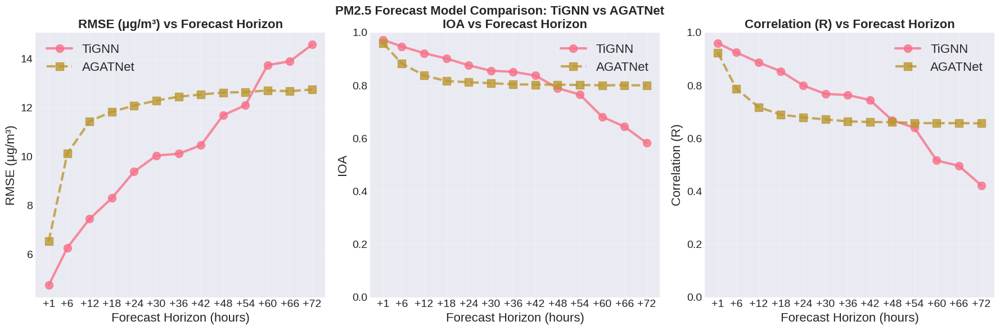


DETAILED PERFORMANCE COMPARISON

MAE:
----------------------------------------
Model    AGATNet  TiGNN
Horizon                
+12h       6.961  3.930
+18h       7.081  4.609
+1h        4.273  2.597
+24h       7.293  5.752
+30h       7.516  6.217
+36h       7.650  6.183
+42h       7.743  6.430
+48h       7.839  7.585
+54h       7.844  7.881
+60h       7.924  9.271
+66h       7.893  9.158
+6h        6.310  3.221
+72h       8.014  9.617
Average improvement of TiGNN over AGATNet: 14.7%

RMSE:
----------------------------------------
Model    AGATNet   TiGNN
Horizon                 
+12h      11.447   7.451
+18h      11.841   8.300
+1h        6.534   4.736
+24h      12.090   9.383
+30h      12.296  10.044
+36h      12.456  10.119
+42h      12.546  10.465
+48h      12.626  11.694
+54h      12.646  12.107
+60h      12.713  13.751
+66h      12.681  13.906
+6h       10.125   6.267
+72h      12.752  14.589
Average improvement of TiGNN over AGATNet: 14.3%

MAPE:
--------------------------------

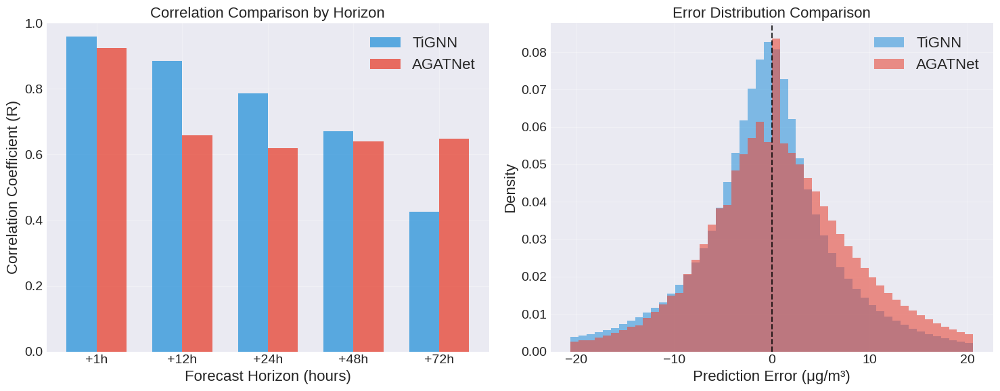


Analysis completed!
TiGNN shows better overall performance in terms of MAE
Average MAE difference: 0.91 μg/m³


In [15]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from scipy.stats import pearsonr
import warnings
warnings.filterwarnings('ignore')

# Set up plotting style
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")
plt.rcParams['figure.figsize'] = (18, 6)
plt.rcParams['font.size'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams['legend.fontsize'] = 14

def calculate_metrics(predictions, actuals):
    """
    Calculate comprehensive evaluation metrics
    
    Args:
        predictions: Predicted values
        actuals: Actual values
    
    Returns:
        dict: Dictionary containing all metrics
    """
    # Flatten arrays for calculation
    pred_flat = predictions.flatten()
    actual_flat = actuals.flatten()
    
    # Remove NaN values
    mask = ~(np.isnan(pred_flat) | np.isnan(actual_flat))
    pred_clean = pred_flat[mask]
    actual_clean = actual_flat[mask]
    
    if len(pred_clean) == 0:
        return {'MAE': np.nan, 'RMSE': np.nan, 'MAPE': np.nan, 'IOA': np.nan, 'R': np.nan}
    
    # Calculate basic metrics
    mae = np.mean(np.abs(pred_clean - actual_clean))
    rmse = np.sqrt(np.mean((pred_clean - actual_clean) ** 2))
    
    # MAPE with protection against division by zero
    mape = np.mean(np.abs((actual_clean - pred_clean) / np.maximum(actual_clean, 1e-8))) * 100
    
    # Index of Agreement (IOA)
    actual_mean = np.mean(actual_clean)
    numerator = np.sum((pred_clean - actual_clean) ** 2)
    denominator = np.sum((np.abs(pred_clean - actual_mean) + np.abs(actual_clean - actual_mean)) ** 2)
    ioa = 1 - (numerator / max(denominator, 1e-8))
    
    # Pearson correlation coefficient
    if np.std(pred_clean) > 1e-8 and np.std(actual_clean) > 1e-8:
        r_value, _ = pearsonr(pred_clean, actual_clean)
    else:
        r_value = np.nan
    
    return {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE': mape,
        'IOA': ioa,
        'R': r_value
    }

def analyze_forecast_horizons(predictions, actuals, model_name, horizons):
    """
    Analyze model performance across different forecast horizons
    
    Args:
        predictions: Model predictions
        actuals: Actual values
        model_name: Name of the model
        horizons: List of forecast horizons to analyze
    
    Returns:
        pd.DataFrame: Results dataframe
    """
    results = []
    
    print(f"\n{model_name} Analysis:")
    print("="*50)
    
    for horizon in horizons:
        horizon_idx = horizon - 1  # Convert to 0-based index
        
        if predictions.shape[1] <= horizon_idx:
            print(f"Horizon +{horizon} hours: Not available (exceeds prediction length)")
            continue
            
        # Extract predictions and actuals for this horizon
        if len(predictions.shape) == 3:  # (samples, horizons, stations)
            pred_horizon = predictions[:, horizon_idx, :]
            actual_horizon = actuals[:, horizon_idx, :]
        else:  # Handle different shapes
            pred_horizon = predictions
            actual_horizon = actuals
        
        # Calculate metrics
        metrics = calculate_metrics(pred_horizon, actual_horizon)
        
        # Store results
        result = {
            'Model': model_name,
            'Horizon': f'+{horizon}h',
            'Horizon_Hours': horizon,
            **metrics
        }
        results.append(result)
        
        # Print metrics
        print(f"Horizon +{horizon:2d} hours: "
              f"MAE={metrics['MAE']:6.2f}, "
              f"RMSE={metrics['RMSE']:6.2f}, "
              f"MAPE={metrics['MAPE']:6.1f}%, "
              f"IOA={metrics['IOA']:5.3f}, "
              f"R={metrics['R']:5.3f}")
    
    return pd.DataFrame(results)

# Define forecast horizons
forecast_horizons = [1, 6, 12, 18, 24, 30, 36, 42, 48, 54, 60, 66, 72]

# Load and prepare data (assuming the data is already loaded as mentioned)
print("Data Shapes:")
print(f"TiGNN Predictions: {predictions_2021.shape}")
print(f"TiGNN Actuals: {actuals_2021.shape}")
print(f"AGATNet Predictions: {predictions_agatnet.shape}")
print(f"AGATNet Actuals: {actuals_agatnet.shape}")

# Ensure AGATNet data has the same format as TiGNN (samples, horizons, stations)
if predictions_agatnet.shape[1] != 72:  # If stations are in dim 1
    predictions_agatnet_formatted = predictions_agatnet.transpose(0, 2, 1)  # (samples, horizons, stations)
    actuals_agatnet_formatted = actuals_agatnet.transpose(0, 2, 1)
else:
    predictions_agatnet_formatted = predictions_agatnet
    actuals_agatnet_formatted = actuals_agatnet

print(f"\nFormatted AGATNet Predictions: {predictions_agatnet_formatted.shape}")
print(f"Formatted AGATNet Actuals: {actuals_agatnet_formatted.shape}")

# Ensure both models have the same number of samples for fair comparison
min_samples = min(predictions_2021.shape[0], predictions_agatnet_formatted.shape[0])
predictions_tignn = predictions_2021[:min_samples]
actuals_tignn = actuals_2021[:min_samples]
predictions_agatnet_comp = predictions_agatnet_formatted[:min_samples]
actuals_agatnet_comp = actuals_agatnet_formatted[:min_samples]

print(f"\nFinal comparison shapes:")
print(f"TiGNN: {predictions_tignn.shape}")
print(f"AGATNet: {predictions_agatnet_comp.shape}")

# Analyze both models
tignn_results = analyze_forecast_horizons(predictions_tignn, actuals_tignn, 'TiGNN', forecast_horizons)
agatnet_results = analyze_forecast_horizons(predictions_agatnet_comp, actuals_agatnet_comp, 'AGATNet', forecast_horizons)

# Combine results
all_results = pd.concat([tignn_results, agatnet_results], ignore_index=True)

# Create visualization - Modified to show only RMSE, IOA, and R (removed MAE and MAPE)
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
fig.suptitle('PM2.5 Forecast Model Comparison: TiGNN vs AGATNet', fontsize=16, fontweight='bold')

# Only keep RMSE, IOA, and R (removed MAE and MAPE as requested)
metrics_to_plot = ['RMSE', 'IOA', 'R']
metric_names = ['RMSE (μg/m³)', 'IOA', 'Correlation (R)']
colors = ['#3498DB', '#F39C12', '#9B59B6']

# Plot each metric
for idx, (metric, name, color) in enumerate(zip(metrics_to_plot, metric_names, colors)):
    ax = axes[idx]
    
    # Plot data for both models
    for model in ['TiGNN', 'AGATNet']:
        model_data = all_results[all_results['Model'] == model]
        marker = 'o' if model == 'TiGNN' else 's'
        linestyle = '-' if model == 'TiGNN' else '--'
        
        ax.plot(model_data['Horizon_Hours'], model_data[metric], 
                marker=marker, linestyle=linestyle, linewidth=3, markersize=10,
                label=model, alpha=0.8)
    
    # Set xlabel and ylabel with fontsize 16
    ax.set_xlabel('Forecast Horizon (hours)', fontsize=16)
    ax.set_ylabel(name, fontsize=16)
    ax.set_title(f'{name} vs Forecast Horizon', fontweight='bold', fontsize=16)
    
    # Increase legend size
    ax.legend(fontsize=16)
    ax.grid(True, alpha=0.3)
    
    # Set x-axis ticks with + sign for exact forecast horizons
    ax.set_xticks(forecast_horizons)
    ax.set_xticklabels([f'+{h}' for h in forecast_horizons], fontsize=14)
    
    # Set appropriate y-axis limits based on metric
    if metric == 'IOA':
        ax.set_ylim(0, 1)
        # ax.axhline(y=0.5, color='red', linestyle=':', alpha=0.5)
    elif metric == 'R':
        ax.set_ylim(0, 1)
        # ax.axhline(y=0.7, color='red', linestyle=':', alpha=0.5)

# Remove table (table section completely removed)
plt.tight_layout()
plt.subplots_adjust(top=0.90)
plt.show()

# Print detailed comparison
print("\n" + "="*80)
print("DETAILED PERFORMANCE COMPARISON")
print("="*80)

pivot_results = all_results.pivot(index='Horizon', columns='Model', values=['MAE', 'RMSE', 'MAPE', 'IOA', 'R'])

for metric in ['MAE', 'RMSE', 'MAPE', 'IOA', 'R']:
    print(f"\n{metric}:")
    print("-" * 40)
    metric_table = pivot_results[metric].round(3)
    print(metric_table.to_string())
    
    # Calculate percentage improvement
    if metric in ['MAE', 'RMSE', 'MAPE']:  # Lower is better
        improvement = ((metric_table['AGATNet'] - metric_table['TiGNN']) / metric_table['AGATNet'] * 100)
        avg_improvement = improvement.mean()
        print(f"Average improvement of TiGNN over AGATNet: {avg_improvement:.1f}%")
    else:  # Higher is better for IOA and R
        improvement = ((metric_table['TiGNN'] - metric_table['AGATNet']) / metric_table['AGATNet'] * 100)
        avg_improvement = improvement.mean()
        print(f"Average improvement of TiGNN over AGATNet: {avg_improvement:.1f}%")

# Save results to CSV
all_results.to_csv('pm25_forecast_comparison_results.csv', index=False)
print(f"\nResults saved to 'pm25_forecast_comparison_results.csv'")

# Create a correlation heatmap comparing models
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Sample a subset of data for correlation analysis (to avoid memory issues)
sample_size = min(1000, min_samples)
sample_indices = np.random.choice(min_samples, sample_size, replace=False)

# Calculate correlations for different horizons
horizon_subset = [1, 12, 24, 48, 72]
corr_data_tignn = []
corr_data_agatnet = []

for h in horizon_subset:
    h_idx = h - 1
    # TiGNN correlations across stations
    tignn_pred = predictions_tignn[sample_indices, h_idx, :].flatten()
    tignn_actual = actuals_tignn[sample_indices, h_idx, :].flatten()
    mask = ~(np.isnan(tignn_pred) | np.isnan(tignn_actual))
    if np.sum(mask) > 10:
        r_tignn, _ = pearsonr(tignn_pred[mask], tignn_actual[mask])
    else:
        r_tignn = np.nan
    corr_data_tignn.append(r_tignn)
    
    # AGATNet correlations
    agatnet_pred = predictions_agatnet_comp[sample_indices, h_idx, :].flatten()
    agatnet_actual = actuals_agatnet_comp[sample_indices, h_idx, :].flatten()
    mask = ~(np.isnan(agatnet_pred) | np.isnan(agatnet_actual))
    if np.sum(mask) > 10:
        r_agatnet, _ = pearsonr(agatnet_pred[mask], agatnet_actual[mask])
    else:
        r_agatnet = np.nan
    corr_data_agatnet.append(r_agatnet)

# Plot correlation comparison
x_pos = np.arange(len(horizon_subset))
width = 0.35

axes[0].bar(x_pos - width/2, corr_data_tignn, width, label='TiGNN', alpha=0.8, color='#3498DB')
axes[0].bar(x_pos + width/2, corr_data_agatnet, width, label='AGATNet', alpha=0.8, color='#E74C3C')
axes[0].set_xlabel('Forecast Horizon (hours)', fontsize=16)
axes[0].set_ylabel('Correlation Coefficient (R)', fontsize=16)
axes[0].set_title('Correlation Comparison by Horizon', fontsize=16)
axes[0].set_xticks(x_pos)
axes[0].set_xticklabels([f'+{h}h' for h in horizon_subset])
axes[0].legend(fontsize=16)
axes[0].grid(True, alpha=0.3)
axes[0].set_ylim(0, 1)

# Create error distribution plot
errors_tignn = (predictions_tignn - actuals_tignn).flatten()
errors_agatnet = (predictions_agatnet_comp - actuals_agatnet_comp).flatten()

# Remove outliers for better visualization
p95_tignn = np.percentile(np.abs(errors_tignn[~np.isnan(errors_tignn)]), 95)
p95_agatnet = np.percentile(np.abs(errors_agatnet[~np.isnan(errors_agatnet)]), 95)
max_error = min(p95_tignn, p95_agatnet)

errors_tignn_clean = errors_tignn[(np.abs(errors_tignn) <= max_error) & (~np.isnan(errors_tignn))]
errors_agatnet_clean = errors_agatnet[(np.abs(errors_agatnet) <= max_error) & (~np.isnan(errors_agatnet))]

axes[1].hist(errors_tignn_clean, bins=50, alpha=0.6, label='TiGNN', density=True, color='#3498DB')
axes[1].hist(errors_agatnet_clean, bins=50, alpha=0.6, label='AGATNet', density=True, color='#E74C3C')
axes[1].axvline(x=0, color='black', linestyle='--', alpha=0.8)
axes[1].set_xlabel('Prediction Error (μg/m³)', fontsize=16)
axes[1].set_ylabel('Density', fontsize=16)
axes[1].set_title('Error Distribution Comparison', fontsize=16)
axes[1].legend(fontsize=16)
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print("\nAnalysis completed!")
print(f"TiGNN shows {'better' if tignn_results['MAE'].mean() < agatnet_results['MAE'].mean() else 'worse'} overall performance in terms of MAE")
print(f"Average MAE difference: {abs(tignn_results['MAE'].mean() - agatnet_results['MAE'].mean()):.2f} μg/m³")

In [ ]:
# Create visualization - Modified to show only RMSE, IOA, and R (removed MAE and MAPE)
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
fig.suptitle('PM2.5 Forecast Model Comparison: TiGNN vs AGATNet', fontsize=16, fontweight='bold')

# Only keep RMSE, IOA, and R (removed MAE and MAPE as requested)
metrics_to_plot = ['RMSE', 'IOA', 'R']
metric_names = ['RMSE (μg/m³)', 'IOA', 'Correlation (R)']
colors = ['#3498DB', '#F39C12', '#9B59B6']

# Plot each metric
for idx, (metric, name, color) in enumerate(zip(metrics_to_plot, metric_names, colors)):
    ax = axes[idx]
    
    # Plot data for both models
    for model in ['TiGNN', 'AGATNet']:
        model_data = all_results[all_results['Model'] == model]
        marker = 'o' if model == 'TiGNN' else 's'
        linestyle = '-' if model == 'TiGNN' else '--'
        
        ax.plot(model_data['Horizon_Hours'], model_data[metric], 
                marker=marker, linestyle=linestyle, linewidth=3, markersize=10,
                label=model, alpha=0.8)
    
    # Set ylabel with bold fontweight
    ax.set_ylabel(name, fontsize=16, fontweight='bold')
    ax.set_title(f'{name} vs Forecast Horizon', fontweight='bold', fontsize=16)
    
    # Make legend bold
    legend = ax.legend(fontsize=16)
    for text in legend.get_texts():
        text.set_fontweight('bold')
    
    ax.grid(True, alpha=0.3)
    
    # Set x-axis ticks with + sign for exact forecast horizons
    ax.set_xticks(forecast_horizons)
    ax.set_xticklabels([f'+{h}' for h in forecast_horizons], fontsize=14, fontweight='bold', rotation=45)
    
    # Make y-axis tick labels bold
    ax.tick_params(axis='y', labelsize=14)
    for label in ax.get_yticklabels():
        label.set_fontweight('bold')
    
    # Set appropriate y-axis limits based on metric
    if metric == 'IOA':
        ax.set_ylim(0.5, 1)
    elif metric == 'R':
        ax.set_ylim(0.3, 1)

# Add single xlabel for the entire figure (centered)
fig.text(0.5, 0.02, 'Forecast Horizon (hours)', ha='center', fontsize=16, fontweight='bold')

plt.tight_layout()
plt.subplots_adjust(top=0.90, bottom=0.15)  # Adjust bottom to make room for xlabel
plt.savefig('TiGNN_AGATNet.png', dpi=300, bbox_inches='tight', facecolor='white', edgecolor='none')
plt.show()

Data Shapes:
TiGNN Predictions: (8676, 72, 170)
TiGNN Actuals: (8676, 72, 170)
AGATNet Predictions: (8664, 170, 72)
AGATNet Actuals: (8664, 170, 72)

Formatted AGATNet Predictions: (8664, 72, 170)
Formatted AGATNet Actuals: (8664, 72, 170)

Final comparison shapes:
TiGNN: (8664, 72, 170)
AGATNet: (8664, 72, 170)

TiGNN Analysis:
Horizon + 1 hours: MAE=  2.60, RMSE=  4.74, MAPE=  38.3%, IOA=0.972, R=0.960
Horizon + 6 hours: MAE=  3.22, RMSE=  6.27, MAPE=  46.0%, IOA=0.948, R=0.925
Horizon +12 hours: MAE=  3.93, RMSE=  7.45, MAPE=  54.6%, IOA=0.922, R=0.887
Horizon +18 hours: MAE=  4.61, RMSE=  8.30, MAPE=  57.5%, IOA=0.902, R=0.854
Horizon +24 hours: MAE=  5.75, RMSE=  9.38, MAPE=  70.6%, IOA=0.877, R=0.800
Horizon +30 hours: MAE=  6.22, RMSE= 10.04, MAPE=  76.8%, IOA=0.856, R=0.768
Horizon +36 hours: MAE=  6.18, RMSE= 10.12, MAPE=  80.3%, IOA=0.852, R=0.764
Horizon +42 hours: MAE=  6.43, RMSE= 10.47, MAPE=  88.1%, IOA=0.838, R=0.745
Horizon +48 hours: MAE=  7.59, RMSE= 11.69, MAPE= 110

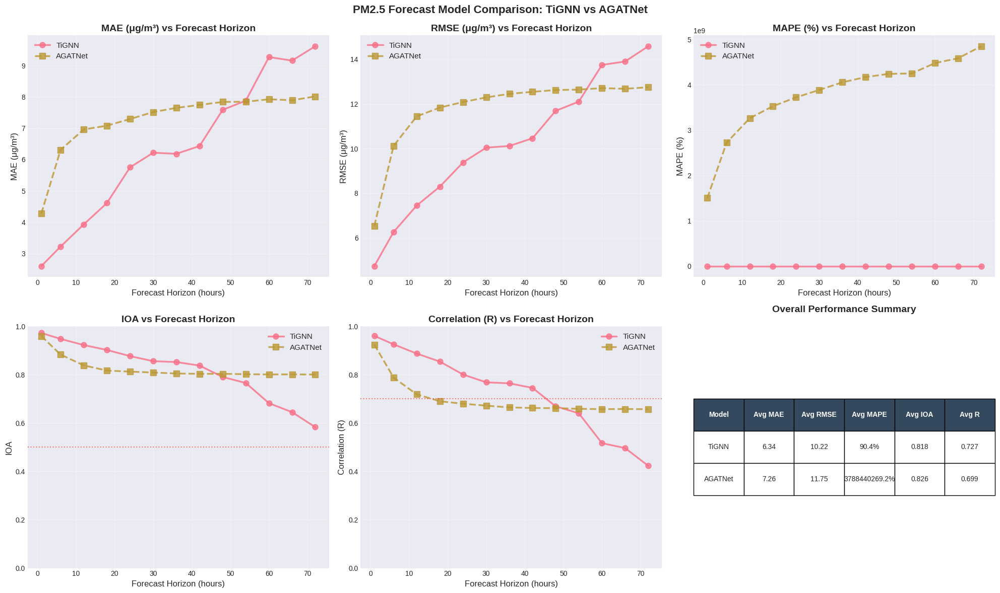


DETAILED PERFORMANCE COMPARISON

MAE:
----------------------------------------
Model    AGATNet  TiGNN
Horizon                
+12h       6.961  3.930
+18h       7.081  4.609
+1h        4.273  2.597
+24h       7.293  5.752
+30h       7.516  6.217
+36h       7.650  6.183
+42h       7.743  6.430
+48h       7.839  7.585
+54h       7.844  7.881
+60h       7.924  9.271
+66h       7.893  9.158
+6h        6.310  3.221
+72h       8.014  9.617
Average improvement of TiGNN over AGATNet: 14.7%

RMSE:
----------------------------------------
Model    AGATNet   TiGNN
Horizon                 
+12h      11.447   7.451
+18h      11.841   8.300
+1h        6.534   4.736
+24h      12.090   9.383
+30h      12.296  10.044
+36h      12.456  10.119
+42h      12.546  10.465
+48h      12.626  11.694
+54h      12.646  12.107
+60h      12.713  13.751
+66h      12.681  13.906
+6h       10.125   6.267
+72h      12.752  14.589
Average improvement of TiGNN over AGATNet: 14.3%

MAPE:
--------------------------------

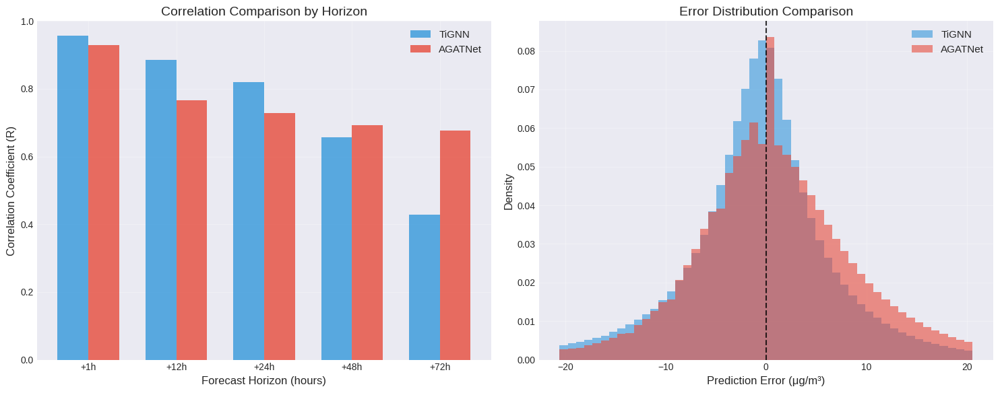


Analysis completed!
TiGNN shows better overall performance in terms of MAE
Average MAE difference: 0.91 μg/m³


In [62]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from scipy.stats import pearsonr
import warnings
warnings.filterwarnings('ignore')

# Set up plotting style
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")
plt.rcParams['figure.figsize'] = (15, 10)
plt.rcParams['font.size'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10
plt.rcParams['legend.fontsize'] = 11

def calculate_metrics(predictions, actuals):
    """
    Calculate comprehensive evaluation metrics
    
    Args:
        predictions: Predicted values
        actuals: Actual values
    
    Returns:
        dict: Dictionary containing all metrics
    """
    # Flatten arrays for calculation
    pred_flat = predictions.flatten()
    actual_flat = actuals.flatten()
    
    # Remove NaN values
    mask = ~(np.isnan(pred_flat) | np.isnan(actual_flat))
    pred_clean = pred_flat[mask]
    actual_clean = actual_flat[mask]
    
    if len(pred_clean) == 0:
        return {'MAE': np.nan, 'RMSE': np.nan, 'MAPE': np.nan, 'IOA': np.nan, 'R': np.nan}
    
    # Calculate basic metrics
    mae = np.mean(np.abs(pred_clean - actual_clean))
    rmse = np.sqrt(np.mean((pred_clean - actual_clean) ** 2))
    
    # MAPE with protection against division by zero
    mape = np.mean(np.abs((actual_clean - pred_clean) / np.maximum(actual_clean, 1e-8))) * 100
    
    # Index of Agreement (IOA)
    actual_mean = np.mean(actual_clean)
    numerator = np.sum((pred_clean - actual_clean) ** 2)
    denominator = np.sum((np.abs(pred_clean - actual_mean) + np.abs(actual_clean - actual_mean)) ** 2)
    ioa = 1 - (numerator / max(denominator, 1e-8))
    
    # Pearson correlation coefficient
    if np.std(pred_clean) > 1e-8 and np.std(actual_clean) > 1e-8:
        r_value, _ = pearsonr(pred_clean, actual_clean)
    else:
        r_value = np.nan
    
    return {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE': mape,
        'IOA': ioa,
        'R': r_value
    }

def analyze_forecast_horizons(predictions, actuals, model_name, horizons):
    """
    Analyze model performance across different forecast horizons
    
    Args:
        predictions: Model predictions
        actuals: Actual values
        model_name: Name of the model
        horizons: List of forecast horizons to analyze
    
    Returns:
        pd.DataFrame: Results dataframe
    """
    results = []
    
    print(f"\n{model_name} Analysis:")
    print("="*50)
    
    for horizon in horizons:
        horizon_idx = horizon - 1  # Convert to 0-based index
        
        if predictions.shape[1] <= horizon_idx:
            print(f"Horizon +{horizon} hours: Not available (exceeds prediction length)")
            continue
            
        # Extract predictions and actuals for this horizon
        if len(predictions.shape) == 3:  # (samples, horizons, stations)
            pred_horizon = predictions[:, horizon_idx, :]
            actual_horizon = actuals[:, horizon_idx, :]
        else:  # Handle different shapes
            pred_horizon = predictions
            actual_horizon = actuals
        
        # Calculate metrics
        metrics = calculate_metrics(pred_horizon, actual_horizon)
        
        # Store results
        result = {
            'Model': model_name,
            'Horizon': f'+{horizon}h',
            'Horizon_Hours': horizon,
            **metrics
        }
        results.append(result)
        
        # Print metrics
        print(f"Horizon +{horizon:2d} hours: "
              f"MAE={metrics['MAE']:6.2f}, "
              f"RMSE={metrics['RMSE']:6.2f}, "
              f"MAPE={metrics['MAPE']:6.1f}%, "
              f"IOA={metrics['IOA']:5.3f}, "
              f"R={metrics['R']:5.3f}")
    
    return pd.DataFrame(results)

# Define forecast horizons
forecast_horizons = [1, 6, 12, 18, 24, 30, 36, 42, 48, 54, 60, 66, 72]

# Load and prepare data (assuming the data is already loaded as mentioned)
print("Data Shapes:")
print(f"TiGNN Predictions: {predictions_2021.shape}")
print(f"TiGNN Actuals: {actuals_2021.shape}")
print(f"AGATNet Predictions: {predictions_agatnet.shape}")
print(f"AGATNet Actuals: {actuals_agatnet.shape}")

# Ensure AGATNet data has the same format as TiGNN (samples, horizons, stations)
if predictions_agatnet.shape[1] != 72:  # If stations are in dim 1
    predictions_agatnet_formatted = predictions_agatnet.transpose(0, 2, 1)  # (samples, horizons, stations)
    actuals_agatnet_formatted = actuals_agatnet.transpose(0, 2, 1)
else:
    predictions_agatnet_formatted = predictions_agatnet
    actuals_agatnet_formatted = actuals_agatnet

print(f"\nFormatted AGATNet Predictions: {predictions_agatnet_formatted.shape}")
print(f"Formatted AGATNet Actuals: {actuals_agatnet_formatted.shape}")

# Ensure both models have the same number of samples for fair comparison
min_samples = min(predictions_2021.shape[0], predictions_agatnet_formatted.shape[0])
predictions_tignn = predictions_2021[:min_samples]
actuals_tignn = actuals_2021[:min_samples]
predictions_agatnet_comp = predictions_agatnet_formatted[:min_samples]
actuals_agatnet_comp = actuals_agatnet_formatted[:min_samples]

print(f"\nFinal comparison shapes:")
print(f"TiGNN: {predictions_tignn.shape}")
print(f"AGATNet: {predictions_agatnet_comp.shape}")

# Analyze both models
tignn_results = analyze_forecast_horizons(predictions_tignn, actuals_tignn, 'TiGNN', forecast_horizons)
agatnet_results = analyze_forecast_horizons(predictions_agatnet_comp, actuals_agatnet_comp, 'AGATNet', forecast_horizons)

# Combine results
all_results = pd.concat([tignn_results, agatnet_results], ignore_index=True)

# Create visualization
fig, axes = plt.subplots(2, 3, figsize=(20, 12))
fig.suptitle('PM2.5 Forecast Model Comparison: TiGNN vs AGATNet', fontsize=16, fontweight='bold')

metrics_to_plot = ['MAE', 'RMSE', 'MAPE', 'IOA', 'R']
metric_names = ['MAE (μg/m³)', 'RMSE (μg/m³)', 'MAPE (%)', 'IOA', 'Correlation (R)']
colors = ['#E74C3C', '#3498DB', '#2ECC71', '#F39C12', '#9B59B6']

# Plot each metric
for idx, (metric, name, color) in enumerate(zip(metrics_to_plot, metric_names, colors)):
    row = idx // 3
    col = idx % 3
    ax = axes[row, col]
    
    # Plot data for both models
    for model in ['TiGNN', 'AGATNet']:
        model_data = all_results[all_results['Model'] == model]
        marker = 'o' if model == 'TiGNN' else 's'
        linestyle = '-' if model == 'TiGNN' else '--'
        
        ax.plot(model_data['Horizon_Hours'], model_data[metric], 
                marker=marker, linestyle=linestyle, linewidth=2.5, markersize=8,
                label=model, alpha=0.8)
    
    ax.set_xlabel('Forecast Horizon (hours)')
    ax.set_ylabel(name)
    ax.set_title(f'{name} vs Forecast Horizon', fontweight='bold')
    ax.legend()
    ax.grid(True, alpha=0.3)
    
    # Set appropriate y-axis limits based on metric
    if metric == 'IOA':
        ax.set_ylim(0, 1)
    elif metric == 'R':
        ax.set_ylim(0, 1)
    
    # Add horizontal reference lines for some metrics
    if metric == 'IOA':
        ax.axhline(y=0.5, color='red', linestyle=':', alpha=0.5, label='Moderate Agreement')
    elif metric == 'R':
        ax.axhline(y=0.7, color='red', linestyle=':', alpha=0.5, label='Strong Correlation')

# Remove the empty subplot
axes[1, 2].remove()

# Add summary statistics table
ax_table = fig.add_subplot(2, 3, 6)
ax_table.axis('off')

# Calculate overall statistics
summary_stats = []
for model in ['TiGNN', 'AGATNet']:
    model_data = all_results[all_results['Model'] == model]
    summary = {
        'Model': model,
        'Avg MAE': f"{model_data['MAE'].mean():.2f}",
        'Avg RMSE': f"{model_data['RMSE'].mean():.2f}",
        'Avg MAPE': f"{model_data['MAPE'].mean():.1f}%",
        'Avg IOA': f"{model_data['IOA'].mean():.3f}",
        'Avg R': f"{model_data['R'].mean():.3f}"
    }
    summary_stats.append(summary)

summary_df = pd.DataFrame(summary_stats)
table = ax_table.table(cellText=summary_df.values, colLabels=summary_df.columns,
                      cellLoc='center', loc='center', bbox=[0, 0.3, 1, 0.4])
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 1.5)

# Style the table
for i in range(len(summary_df.columns)):
    table[(0, i)].set_facecolor('#34495E')
    table[(0, i)].set_text_props(weight='bold', color='white')

ax_table.set_title('Overall Performance Summary', fontweight='bold', pad=20)

plt.tight_layout()
plt.subplots_adjust(top=0.93)
plt.show()

# Print detailed comparison
print("\n" + "="*80)
print("DETAILED PERFORMANCE COMPARISON")
print("="*80)

pivot_results = all_results.pivot(index='Horizon', columns='Model', values=['MAE', 'RMSE', 'MAPE', 'IOA', 'R'])

for metric in ['MAE', 'RMSE', 'MAPE', 'IOA', 'R']:
    print(f"\n{metric}:")
    print("-" * 40)
    metric_table = pivot_results[metric].round(3)
    print(metric_table.to_string())
    
    # Calculate percentage improvement
    if metric in ['MAE', 'RMSE', 'MAPE']:  # Lower is better
        improvement = ((metric_table['AGATNet'] - metric_table['TiGNN']) / metric_table['AGATNet'] * 100)
        avg_improvement = improvement.mean()
        print(f"Average improvement of TiGNN over AGATNet: {avg_improvement:.1f}%")
    else:  # Higher is better for IOA and R
        improvement = ((metric_table['TiGNN'] - metric_table['AGATNet']) / metric_table['AGATNet'] * 100)
        avg_improvement = improvement.mean()
        print(f"Average improvement of TiGNN over AGATNet: {avg_improvement:.1f}%")

# Save results to CSV
all_results.to_csv('pm25_forecast_comparison_results.csv', index=False)
print(f"\nResults saved to 'pm25_forecast_comparison_results.csv'")

# Create a correlation heatmap comparing models
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Sample a subset of data for correlation analysis (to avoid memory issues)
sample_size = min(1000, min_samples)
sample_indices = np.random.choice(min_samples, sample_size, replace=False)

# Calculate correlations for different horizons
horizon_subset = [1, 12, 24, 48, 72]
corr_data_tignn = []
corr_data_agatnet = []

for h in horizon_subset:
    h_idx = h - 1
    # TiGNN correlations across stations
    tignn_pred = predictions_tignn[sample_indices, h_idx, :].flatten()
    tignn_actual = actuals_tignn[sample_indices, h_idx, :].flatten()
    mask = ~(np.isnan(tignn_pred) | np.isnan(tignn_actual))
    if np.sum(mask) > 10:
        r_tignn, _ = pearsonr(tignn_pred[mask], tignn_actual[mask])
    else:
        r_tignn = np.nan
    corr_data_tignn.append(r_tignn)
    
    # AGATNet correlations
    agatnet_pred = predictions_agatnet_comp[sample_indices, h_idx, :].flatten()
    agatnet_actual = actuals_agatnet_comp[sample_indices, h_idx, :].flatten()
    mask = ~(np.isnan(agatnet_pred) | np.isnan(agatnet_actual))
    if np.sum(mask) > 10:
        r_agatnet, _ = pearsonr(agatnet_pred[mask], agatnet_actual[mask])
    else:
        r_agatnet = np.nan
    corr_data_agatnet.append(r_agatnet)

# Plot correlation comparison
x_pos = np.arange(len(horizon_subset))
width = 0.35

axes[0].bar(x_pos - width/2, corr_data_tignn, width, label='TiGNN', alpha=0.8, color='#3498DB')
axes[0].bar(x_pos + width/2, corr_data_agatnet, width, label='AGATNet', alpha=0.8, color='#E74C3C')
axes[0].set_xlabel('Forecast Horizon (hours)')
axes[0].set_ylabel('Correlation Coefficient (R)')
axes[0].set_title('Correlation Comparison by Horizon')
axes[0].set_xticks(x_pos)
axes[0].set_xticklabels([f'+{h}h' for h in horizon_subset])
axes[0].legend()
axes[0].grid(True, alpha=0.3)
axes[0].set_ylim(0, 1)

# Create error distribution plot
errors_tignn = (predictions_tignn - actuals_tignn).flatten()
errors_agatnet = (predictions_agatnet_comp - actuals_agatnet_comp).flatten()

# Remove outliers for better visualization
p95_tignn = np.percentile(np.abs(errors_tignn[~np.isnan(errors_tignn)]), 95)
p95_agatnet = np.percentile(np.abs(errors_agatnet[~np.isnan(errors_agatnet)]), 95)
max_error = min(p95_tignn, p95_agatnet)

errors_tignn_clean = errors_tignn[(np.abs(errors_tignn) <= max_error) & (~np.isnan(errors_tignn))]
errors_agatnet_clean = errors_agatnet[(np.abs(errors_agatnet) <= max_error) & (~np.isnan(errors_agatnet))]

axes[1].hist(errors_tignn_clean, bins=50, alpha=0.6, label='TiGNN', density=True, color='#3498DB')
axes[1].hist(errors_agatnet_clean, bins=50, alpha=0.6, label='AGATNet', density=True, color='#E74C3C')
axes[1].axvline(x=0, color='black', linestyle='--', alpha=0.8)
axes[1].set_xlabel('Prediction Error (μg/m³)')
axes[1].set_ylabel('Density')
axes[1].set_title('Error Distribution Comparison')
axes[1].legend()
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print("\nAnalysis completed!")
print(f"TiGNN shows {'better' if tignn_results['MAE'].mean() < agatnet_results['MAE'].mean() else 'worse'} overall performance in terms of MAE")
print(f"Average MAE difference: {abs(tignn_results['MAE'].mean() - agatnet_results['MAE'].mean()):.2f} μg/m³")

(183,)


AGATNet Prediction shape is (8664, 170, 72)
AGATNet Actual shape is (8664, 170, 72)


In [53]:
import joblib

pm25_scaler = joblib.load("/global/homes/r/rdimri/pm25_scaler.pkl")

def unscale_pm25(pred_scaled, scaler):
    samples, horizons, stations = pred_scaled.shape
    pred_flat = pred_scaled.reshape(-1, 1)  # Shape: (samples * horizons * stations, 1)
    pred_unscaled_flat = scaler.inverse_transform(pred_flat)
    return pred_unscaled_flat.reshape(samples, horizons, stations)

predictions = unscale_pm25(predictions, pm25_scaler)
predictions_2020 = unscale_pm25(predictions_2020, pm25_scaler)
actuals = unscale_pm25(actuals, pm25_scaler)
actuals_2020 = unscale_pm25(actuals_2020, pm25_scaler)
print(f'Actual 2020 shape is {actuals_2020.shape} and Actual 2021 shape is {actuals.shape}')


meana_2020 = np.mean(actuals[:, 0, :])
meana_2021 = np.mean(actuals_2020[:, 0, :])
print(f'Actual Mean 2020 PM2.5 concentration is {meana_2020}\nActual Mean 2021 PM2.5 concentration is {meana_2021}')

meanp_2020 = np.mean(predictions[:, 0, :])
meanp_2021 = np.mean(predictions_2020[:, 0, :])
print(f'Prediction Mean 2020 PM2.5 concentration  is {meanp_2020}\nPrediction Mean 2021 PM2.5 concentration is {meanp_2021}')

/pscratch/sd/r/rdimri/conda_envs/gnn_env/lib/python3.11/site-packages/sklearn/base.py:380: InconsistentVersionWarning: Trying to unpickle estimator StandardScaler from version 1.5.2 when using version 1.6.0. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Actual 2020 shape is (8664, 72, 170) and Actual 2021 shape is (8676, 72, 170)
Actual Mean 2020 PM2.5 concentration is 17.658308029174805
Actual Mean 2021 PM2.5 concentration is 18.538379669189453
Prediction Mean 2020 PM2.5 concentration  is 16.84371566772461
Prediction Mean 2021 PM2.5 concentration is 18.36531639099121


In [28]:
a = np.array(torch.tensor(test).permute(0, 2, 1))
a.shape

(8664, 72, 170)

Prediction shape is (8676, 72, 170) and Target shape is (8676, 72, 170)
Top 3 stations for extreme events: [57, 42, 45]


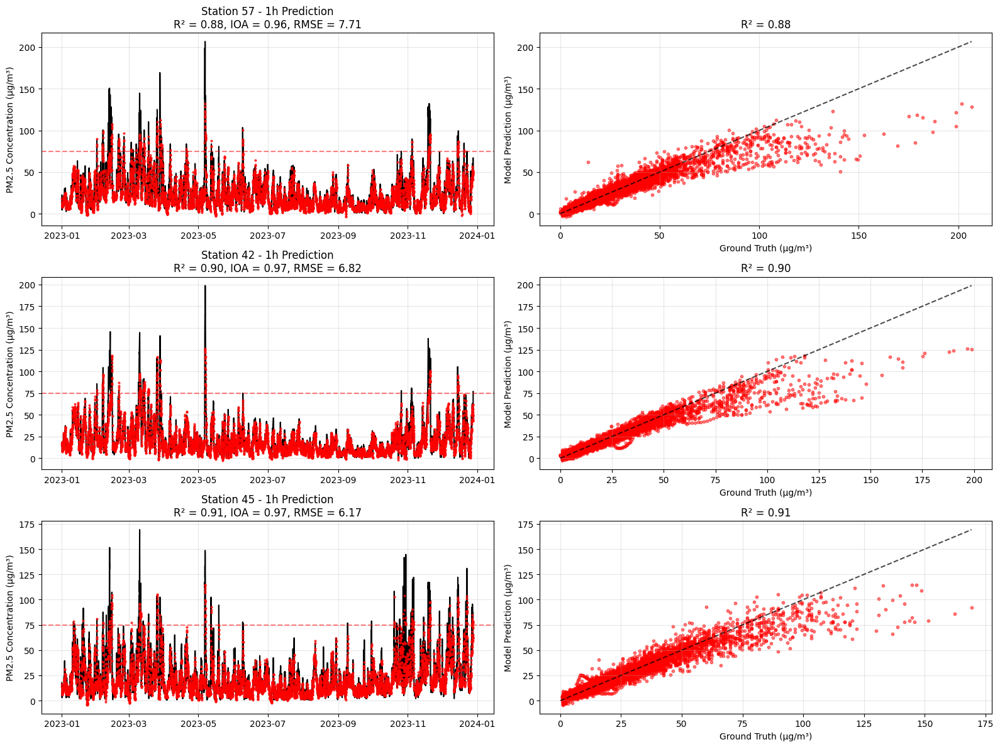

In [58]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import r2_score, mean_squared_error
import datetime as dt

# Load data
# predictions = np.load('/pscratch/sd/r/rdimri/ADR_GNN/evaluation_results/predictions.npy')
# actuals = np.load('/pscratch/sd/r/rdimri/ADR_GNN/evaluation_results/targets.npy')
# predictions = predictions
# actuals = actuals
print(f'Prediction shape is {predictions.shape} and Target shape is {actuals.shape}')

# Define function to calculate Index of Agreement (IOA)
def calculate_ioa(predictions, actuals):
    numerator = np.sum((predictions - actuals) ** 2, axis=0)
    mean_actual = np.mean(actuals, axis=0)
    denominator = np.sum(
        (np.abs(predictions - mean_actual) + np.abs(actuals - mean_actual)) ** 2, axis=0
    )
    # Avoid division by zero
    denominator = np.where(denominator == 0, 1e-10, denominator)
    ioa = 1 - (numerator / denominator)
    return ioa

# Define extreme PM2.5 threshold
extreme_threshold = 75

def find_extreme_stations(data, threshold):
    extreme_mask = data > threshold
    extreme_counts = extreme_mask.sum(axis=(0,1))
    sorted_stations = np.argsort(extreme_counts)[::-1]
    return sorted_stations, extreme_counts

hours_to_evaluate = [0, 5]
performance_metrics = {}

for hour_idx in hours_to_evaluate:
    pred_hour = predictions[:, hour_idx, :]
    actual_hour = actuals[:, hour_idx, :]
    
    ioa_values = calculate_ioa(pred_hour, actual_hour)
    
    r2_values = np.zeros(pred_hour.shape[1])
    rmse_values = np.zeros(pred_hour.shape[1])
    
    for station in range(pred_hour.shape[1]):
        pred_station = pred_hour[:, station]
        actual_station = actual_hour[:, station]
        
        # Filter out NaN values
        mask = ~(np.isnan(pred_station) | np.isnan(actual_station))
        if np.sum(mask) > 0:
            r2_values[station] = r2_score(actual_station[mask], pred_station[mask])
            rmse_values[station] = np.sqrt(mean_squared_error(actual_station[mask], pred_station[mask]))
        else:
            r2_values[station] = np.nan
            rmse_values[station] = np.nan
    
    performance_metrics[f'+{hour_idx+1}h'] = {
        'ioa': ioa_values,
        'r2': r2_values,
        'rmse': rmse_values
    }

# Find stations with high IOA for both prediction horizons
ioa_1h = performance_metrics['+1h']['ioa']
ioa_6h = performance_metrics['+6h']['ioa']
combined_ioa = (ioa_1h + ioa_6h) / 2

# Find stations with extreme events
sorted_stations, extreme_counts = find_extreme_stations(actuals, extreme_threshold)

# Find top 3 stations that have both good IOA and extreme events
top_stations = []
for station in sorted_stations:
    if extreme_counts[station] > 10 and combined_ioa[station] > 0.7:  # Adjust thresholds as needed
        top_stations.append(station)
        if len(top_stations) == 3:
            break

print(f"Top 3 stations for extreme events: {top_stations}")

# Create time series plots for each station
start_date = dt.datetime(2023, 1, 1)  # Adjust as needed
date_range = [start_date + dt.timedelta(hours=i) for i in range(actuals.shape[0])]

plt.figure(figsize=(16, 12))

for i, station_idx in enumerate(top_stations):
    station_name = f"Station {station_idx}"
    
    # Plot for +1h prediction
    plt.subplot(3, 2, 2*i+1)
    plt.plot(date_range, actuals[:, 0, station_idx], 'k-', label='Ground Truth', linewidth=1.5)
    plt.plot(date_range, predictions[:, 0, station_idx], 'ro', label='Model Prediction', markersize=2, alpha=0.7)
    
    # Add metrics
    r2_1h = performance_metrics['+1h']['r2'][station_idx]
    ioa_1h = performance_metrics['+1h']['ioa'][station_idx]
    rmse_1h = performance_metrics['+1h']['rmse'][station_idx]
    
    plt.title(f"{station_name} - 1h Prediction\nR² = {r2_1h:.2f}, IOA = {ioa_1h:.2f}, RMSE = {rmse_1h:.2f}", fontsize=12)
    plt.ylabel("PM2.5 Concentration (μg/m³)")
    plt.grid(True, alpha=0.3)
    
    # Filter for extreme events
    extreme_mask = actuals[:, 0, station_idx] > extreme_threshold
    if np.any(extreme_mask):
        plt.axhline(y=extreme_threshold, color='r', linestyle='--', alpha=0.5)
    
    # Scatter plot for correlation
    plt.subplot(3, 2, 2*i+2)
    plt.scatter(actuals[:, 0, station_idx], predictions[:, 0, station_idx], c='r', alpha=0.5, s=10)
    
    # Add diagonal line
    max_val = max(np.max(actuals[:, 0, station_idx]), np.max(predictions[:, 0, station_idx]))
    plt.plot([0, max_val], [0, max_val], 'k--', alpha=0.7)
    
    plt.xlabel("Ground Truth (μg/m³)")
    plt.ylabel("Model Prediction (μg/m³)")
    plt.title(f"R² = {r2_1h:.2f}", fontsize=12)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    # plt.show()

# plt.savefig('pm25_extreme_events_1h.png', dpi=300, bbox_inches='tight')



ValueError: Found array with 0 sample(s) (shape=(0,)) while a minimum of 1 is required.

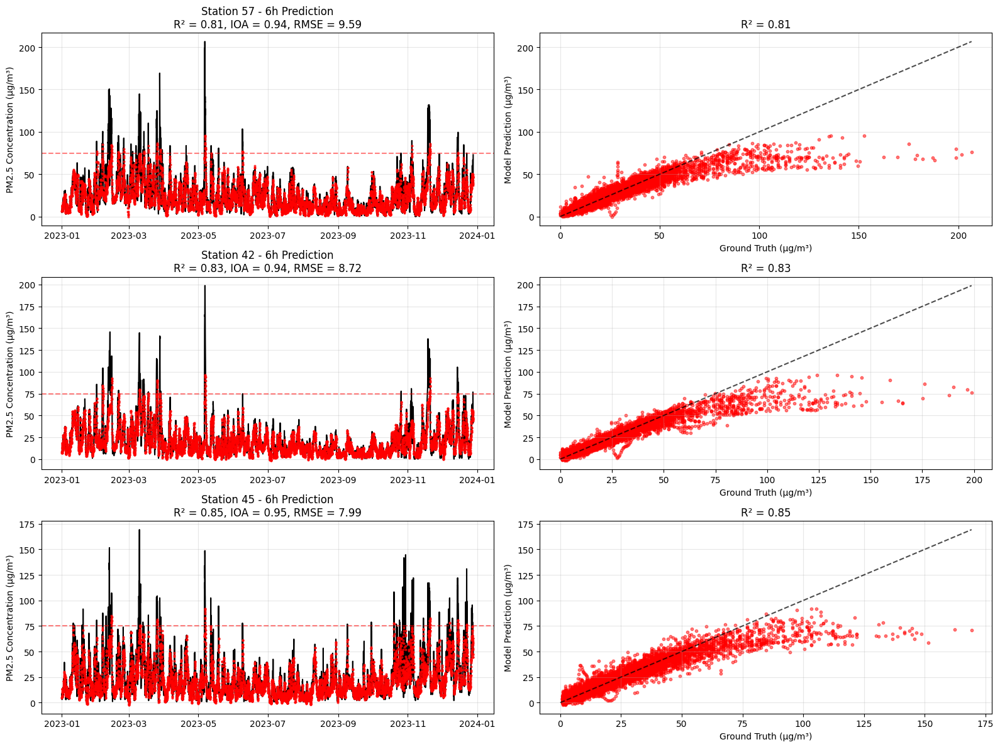

In [59]:
# Create similar plot for +6h prediction
plt.figure(figsize=(16, 12))

for i, station_idx in enumerate(top_stations):
    station_name = f"Station {station_idx}"
    
    # Plot for +6h prediction
    plt.subplot(3, 2, 2*i+1)
    plt.plot(date_range, actuals[:, 5, station_idx], 'k-', label='Ground Truth', linewidth=1.5)
    plt.plot(date_range, predictions[:, 5, station_idx], 'ro', label='Model Prediction', markersize=2, alpha=0.7)
    
    # Add metrics
    r2_6h = performance_metrics['+6h']['r2'][station_idx]
    ioa_6h = performance_metrics['+6h']['ioa'][station_idx]
    rmse_6h = performance_metrics['+6h']['rmse'][station_idx]
    
    plt.title(f"{station_name} - 6h Prediction\nR² = {r2_6h:.2f}, IOA = {ioa_6h:.2f}, RMSE = {rmse_6h:.2f}", fontsize=12)
    plt.ylabel("PM2.5 Concentration (μg/m³)")
    plt.grid(True, alpha=0.3)
    
    # Filter for extreme events
    extreme_mask = actuals[:, 5, station_idx] > extreme_threshold
    if np.any(extreme_mask):
        plt.axhline(y=extreme_threshold, color='r', linestyle='--', alpha=0.5)
    
    # Scatter plot for correlation
    plt.subplot(3, 2, 2*i+2)
    plt.scatter(actuals[:, 5, station_idx], predictions[:, 5, station_idx], c='r', alpha=0.5, s=10)
    
    # Add diagonal line
    max_val = max(np.max(actuals[:, 5, station_idx]), np.max(predictions[:, 5, station_idx]))
    plt.plot([0, max_val], [0, max_val], 'k--', alpha=0.7)
    
    plt.xlabel("Ground Truth (μg/m³)")
    plt.ylabel("Model Prediction (μg/m³)")
    plt.title(f"R² = {r2_6h:.2f}", fontsize=12)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

# plt.savefig('pm25_extreme_events_6h.png', dpi=300, bbox_inches='tight')

# To visualize a specific month for a single station
def plot_monthly_data(station_idx, year=2023, month=1):
    # Create date filter for the specific month
    start_date = dt.datetime(year, month, 1)
    if month == 12:
        end_date = dt.datetime(year + 1, 1, 1)
    else:
        end_date = dt.datetime(year, month + 1, 1)
    
    date_filter = [(d >= start_date and d < end_date) for d in date_range]
    date_filter = np.array(date_filter)
    
    # Filter data for the month
    month_dates = [d for d, include in zip(date_range, date_filter) if include]
    month_actuals_1h = actuals[date_filter, 0, station_idx]
    month_predictions_1h = predictions[date_filter, 0, station_idx]
    month_actuals_6h = actuals[date_filter, 5, station_idx]
    month_predictions_6h = predictions[date_filter, 5, station_idx]
    
    # Calculate metrics for this month
    mask_1h = ~(np.isnan(month_predictions_1h) | np.isnan(month_actuals_1h))
    r2_1h = r2_score(month_actuals_1h[mask_1h], month_predictions_1h[mask_1h])
    rmse_1h = np.sqrt(mean_squared_error(month_actuals_1h[mask_1h], month_predictions_1h[mask_1h]))
    
    numerator_1h = np.sum((month_predictions_1h[mask_1h] - month_actuals_1h[mask_1h]) ** 2)
    mean_actual_1h = np.mean(month_actuals_1h[mask_1h])
    denominator_1h = np.sum((np.abs(month_predictions_1h[mask_1h] - mean_actual_1h) + 
                             np.abs(month_actuals_1h[mask_1h] - mean_actual_1h)) ** 2)
    ioa_1h = 1 - (numerator_1h / denominator_1h)
    
    mask_6h = ~(np.isnan(month_predictions_6h) | np.isnan(month_actuals_6h))
    r2_6h = r2_score(month_actuals_6h[mask_6h], month_predictions_6h[mask_6h])
    rmse_6h = np.sqrt(mean_squared_error(month_actuals_6h[mask_6h], month_predictions_6h[mask_6h]))
    
    numerator_6h = np.sum((month_predictions_6h[mask_6h] - month_actuals_6h[mask_6h]) ** 2)
    mean_actual_6h = np.mean(month_actuals_6h[mask_6h])
    denominator_6h = np.sum((np.abs(month_predictions_6h[mask_6h] - mean_actual_6h) + 
                             np.abs(month_actuals_6h[mask_6h] - mean_actual_6h)) ** 2)
    ioa_6h = 1 - (numerator_6h / denominator_6h)
    
    # Create plots
    fig, axs = plt.subplots(2, 2, figsize=(16, 10))
    
    # +1h time series
    axs[0, 0].plot(month_dates, month_actuals_1h, 'k-', label='Ground Truth', linewidth=1.5)
    axs[0, 0].plot(month_dates, month_predictions_1h, 'ro', label='Model Prediction', markersize=2, alpha=0.7)
    axs[0, 0].set_title(f"Station {station_idx} - 1h Prediction ({start_date.strftime('%B %Y')})")
    axs[0, 0].set_ylabel("PM2.5 Concentration (μg/m³)")
    axs[0, 0].grid(True, alpha=0.3)
    axs[0, 0].legend()
    axs[0, 0].axhline(y=extreme_threshold, color='r', linestyle='--', alpha=0.5, label='Extreme Threshold')
    
    # +1h scatter
    axs[0, 1].scatter(month_actuals_1h, month_predictions_1h, c='r', alpha=0.5, s=10)
    max_val = max(np.max(month_actuals_1h), np.max(month_predictions_1h))
    axs[0, 1].plot([0, max_val], [0, max_val], 'k--', alpha=0.7)
    axs[0, 1].set_xlabel("Ground Truth (μg/m³)")
    axs[0, 1].set_ylabel("Model Prediction (μg/m³)")
    axs[0, 1].set_title(f"R² = {r2_1h:.2f}, IOA = {ioa_1h:.2f}, RMSE = {rmse_1h:.2f}")
    axs[0, 1].grid(True, alpha=0.3)
    
    # +6h time series
    axs[1, 0].plot(month_dates, month_actuals_6h, 'k-', label='Ground Truth', linewidth=1.5)
    axs[1, 0].plot(month_dates, month_predictions_6h, 'ro', label='Model Prediction', markersize=2, alpha=0.7)
    axs[1, 0].set_title(f"Station {station_idx} - 6h Prediction ({start_date.strftime('%B %Y')})")
    axs[1, 0].set_ylabel("PM2.5 Concentration (μg/m³)")
    axs[1, 0].set_xlabel("Date")
    axs[1, 0].grid(True, alpha=0.3)
    axs[1, 0].legend()
    axs[1, 0].axhline(y=extreme_threshold, color='r', linestyle='--', alpha=0.5, label='Extreme Threshold')
    
    # +6h scatter
    axs[1, 1].scatter(month_actuals_6h, month_predictions_6h, c='r', alpha=0.5, s=10)
    max_val = max(np.max(month_actuals_6h), np.max(month_predictions_6h))
    axs[1, 1].plot([0, max_val], [0, max_val], 'k--', alpha=0.7)
    axs[1, 1].set_xlabel("Ground Truth (μg/m³)")
    axs[1, 1].set_ylabel("Model Prediction (μg/m³)")
    axs[1, 1].set_title(f"R² = {r2_6h:.2f}, IOA = {ioa_6h:.2f}, RMSE = {rmse_6h:.2f}")
    axs[1, 1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    # plt.savefig(f'station_{station_idx}_month_{year}_{month}.png', dpi=300, bbox_inches='tight')
    # plt.close()
    plt.show()

# Plot monthly data for each top station
for station_idx in top_stations:
    # You can adjust year and month as needed
    plot_monthly_data(station_idx, year=2021, month=1)

In [14]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta
from sklearn.metrics import mean_squared_error

# Define functions for metrics
def rmse(y_true, y_pred):
    """Calculate Root Mean Squared Error"""
    return np.sqrt(mean_squared_error(y_true, y_pred))

def ioa(y_true, y_pred):
    """Calculate Index of Agreement (IOA)"""
    epsilon = 1e-6
    y_mean = np.mean(y_true)
    numerator = np.sum((y_pred - y_true) ** 2)
    denominator = np.sum((np.abs(y_pred - y_mean) + np.abs(y_true - y_mean)) ** 2) + epsilon
    return 1 - (numerator / denominator)

# Load data
# If data is already pre-loaded, you can comment these lines
predictions = predictions  # Use the global variable
actuals = actuals  # Use the global variable

# 1. Short-term forecasting metrics (simplified version)
def plot_simple_forecast_metrics():
    """Plot RMSE and IOA for 24-hour forecasting horizon"""
    # Calculate metrics for each hour
    hours = range(1, 25)  # 24-hour forecasting
    rmse_values = []
    ioa_values = []
    
    for hour in range(24):  # First 24 hours
        hour_pred = predictions[:, hour, :]
        hour_true = actuals[:, hour, :]
        
        # Flatten for metric calculation
        hour_pred_flat = hour_pred.flatten()
        hour_true_flat = hour_true.flatten()
        
        # Calculate metrics
        rmse_values.append(rmse(hour_true_flat, hour_pred_flat))
        ioa_values.append(ioa(hour_true_flat, hour_pred_flat))
    
    # Create figure with two subplots to avoid tick locator issues
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8), sharex=True)
    
    # Plot RMSE
    ax1.plot(hours, rmse_values, 'ro-', linewidth=2)
    ax1.set_ylabel('RMSE (μg/m³)')
    ax1.grid(True, linestyle='--', alpha=0.7)
    ax1.set_title('RMSE by Forecast Hour', fontsize=14)
    
    # Plot IOA
    ax2.plot(hours, ioa_values, 'bs-', linewidth=2)
    ax2.set_ylabel('Index of Agreement (IOA)')
    ax2.set_xlabel('Forecast Hour')
    ax2.set_ylim(0, 1)  # IOA ranges from 0 to 1
    ax2.grid(True, linestyle='--', alpha=0.7)
    ax2.set_title('IOA by Forecast Hour', fontsize=14)
    
    # Set x-ticks
    ax2.set_xticks(list(range(1, 25, 2)))
    
    # Add overall title
    fig.suptitle('ADR-GNN Forecasting Performance Metrics (24h)', fontsize=16, y=0.98)
    
    # Display avg values in text boxes
    rmse_24h_avg = np.mean(rmse_values)
    ioa_24h_avg = np.mean(ioa_values)
    
    textstr = f'24h Avg RMSE: {rmse_24h_avg:.2f} μg/m³'
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    ax1.text(0.05, 0.95, textstr, transform=ax1.transAxes, fontsize=10,
             verticalalignment='top', bbox=props)
    
    textstr = f'24h Avg IOA: {ioa_24h_avg:.3f}'
    ax2.text(0.05, 0.95, textstr, transform=ax2.transAxes, fontsize=10,
             verticalalignment='top', bbox=props)
    
    plt.tight_layout()
    plt.savefig('forecast_metrics_24h_simple.png', dpi=300, bbox_inches='tight')
    plt.close()

# 2. Simplified time series plots
def plot_simplified_timeseries():
    """Create simplified time series plots for +1 hour forecasting"""
    # Use first forecast hour for all samples
    pred_values = predictions[:, 0, :].mean(axis=1)  # Average across stations
    true_values = actuals[:, 0, :].mean(axis=1)      # Average across stations
    
    # Create time indices instead of dates to avoid potential issues
    time_indices = np.arange(len(pred_values))
    
    plt.figure(figsize=(14, 6))
    plt.plot(time_indices, true_values, 'b-', linewidth=2, label='Actual')
    plt.plot(time_indices, pred_values, 'r--', linewidth=2, label='Predicted')
    
    plt.xlabel('Time Step')
    plt.ylabel('PM2.5 Concentration (μg/m³)', fontsize=12)
    plt.title('ADR-GNN PM2.5 Forecast Performance (+1h)', fontsize=16)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend()
    
    # Add metrics as text
    rmse_val = rmse(true_values, pred_values)
    ioa_val = ioa(true_values, pred_values)
    
    textstr = f'RMSE: {rmse_val:.2f} μg/m³\nIOA: {ioa_val:.3f}'
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    plt.gca().text(0.02, 0.95, textstr, transform=plt.gca().transAxes, fontsize=10,
                   verticalalignment='top', bbox=props)
    
    plt.tight_layout()
    plt.savefig('timeseries_simple.png', dpi=300, bbox_inches='tight')
    plt.close()

# Run the simplified plots
plot_simple_forecast_metrics()
plot_simplified_timeseries()
print("Simplified plots created successfully.")

Simplified plots created successfully.


In [3]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Define clean metric calculation functions
def calculate_rmse(y_true, y_pred):
    """Calculate RMSE with proper handling of NaN values"""
    # Create mask for non-NaN values
    mask = ~np.isnan(y_true) & ~np.isnan(y_pred)
    
    # Apply mask
    y_true_valid = y_true[mask]
    y_pred_valid = y_pred[mask]
    
    # If no valid values, return NaN
    if len(y_true_valid) == 0:
        return np.nan
        
    return np.sqrt(mean_squared_error(y_true_valid, y_pred_valid))

def calculate_ioa(y_true, y_pred):
    """Calculate Index of Agreement with proper handling of NaN values"""
    # Create mask for non-NaN values
    mask = ~np.isnan(y_true) & ~np.isnan(y_pred)
    
    # Apply mask
    y_true_valid = y_true[mask]
    y_pred_valid = y_pred[mask]
    
    # If no valid values, return NaN
    if len(y_true_valid) == 0:
        return np.nan
    
    # Calculate IOA
    y_mean = np.mean(y_true_valid)
    numerator = np.sum((y_pred_valid - y_true_valid) ** 2)
    denominator = np.sum((np.abs(y_pred_valid - y_mean) + np.abs(y_true_valid - y_mean)) ** 2) + 1e-6
    return 1 - (numerator / denominator)

def plot_forecast_metrics(predictions, actuals):
    """Plot RMSE and IOA for 24-hour forecasting horizon"""
    # Calculate metrics for each hour
    hours = range(1, 25)  # 24-hour forecasting
    rmse_values = []
    ioa_values = []
    
    for hour in range(24):
        hour_pred = predictions[:, hour, :]
        hour_true = actuals[:, hour, :]
        
        # Flatten for metric calculation
        hour_pred_flat = hour_pred.flatten()
        hour_true_flat = hour_true.flatten()
        
        # Calculate metrics
        rmse_values.append(calculate_rmse(hour_true_flat, hour_pred_flat))
        ioa_values.append(calculate_ioa(hour_true_flat, hour_pred_flat))
        
        # Print for verification
        print(f"Hour {hour+1}: RMSE={rmse_values[-1]:.4f}, IOA={ioa_values[-1]:.4f}")
    
    # Create a simple figure with two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8))
    
    # Plot RMSE
    ax1.plot(hours, rmse_values, 'r-o')
    ax1.set_ylabel('RMSE (μg/m³)')
    ax1.set_title('Root Mean Square Error by Forecast Hour')
    ax1.grid(True)
    
    # Plot IOA
    ax2.plot(hours, ioa_values, 'b-o')
    ax2.set_ylabel('Index of Agreement (IOA)')
    ax2.set_xlabel('Forecast Hour')
    ax2.set_title('Index of Agreement by Forecast Hour')
    ax2.grid(True)
    
    # Set reasonable y-limit for IOA
    if not np.any(np.isnan(ioa_values)):
        min_ioa = max(0.8, min(ioa_values) - 0.05)
        ax2.set_ylim(min_ioa, 1.0)
    
    # Add averages in text boxes
    rmse_avg = np.nanmean(rmse_values)
    ioa_avg = np.nanmean(ioa_values)
    
    ax1.text(0.05, 0.9, f'Avg RMSE: {rmse_avg:.2f}', transform=ax1.transAxes, 
             bbox=dict(boxstyle="round,pad=0.3", facecolor='white', alpha=0.8))
    
    ax2.text(0.05, 0.9, f'Avg IOA: {ioa_avg:.4f}', transform=ax2.transAxes,
             bbox=dict(boxstyle="round,pad=0.3", facecolor='white', alpha=0.8))
    
    plt.tight_layout()
    plt.savefig('forecast_metrics.png', dpi=300)
    plt.close()

def plot_seasonal_series_hourly(predictions, actuals, year=2021):
    """
    Plot seasonal time series with proper hourly handling
    
    Args:
        predictions: Predictions array (samples, horizons, stations)
        actuals: Actual values array (samples, horizons, stations)
        year: The year of the data (default: 2021)
    """
    # Assuming predictions start at January 1, 2021, hour 00:00
    start_date = datetime(year, 1, 1, 0, 0)
    
    # Create hourly timestamps
    dates = [start_date + timedelta(hours=i) for i in range(predictions.shape[0])]
    
    # Calculate average PM2.5 across all stations for the first forecast hour
    pred_avg = predictions[:, 0, :].mean(axis=1)  # First forecast hour, avg across stations
    true_avg = actuals[:, 0, :].mean(axis=1)     # First forecast hour, avg across stations
    
    # Define winter and summer periods
    winter_indices = []
    summer_indices = []
    
    for i, date in enumerate(dates):
        # Winter: December, January, February
        if date.month in [12, 1, 2]:
            winter_indices.append(i)
        # Summer: June, July, August
        elif date.month in [6, 7, 8]:
            summer_indices.append(i)
    
    # Plot winter time series if we have winter data
    if winter_indices:
        plot_hourly_series(
            [dates[i] for i in winter_indices],
            pred_avg[winter_indices],
            true_avg[winter_indices],
            f'Winter {year}',
            'winter_timeseries.png'
        )
    else:
        print("No winter data available.")
    
    # Plot summer time series if we have summer data
    if summer_indices:
        plot_hourly_series(
            [dates[i] for i in summer_indices],
            pred_avg[summer_indices],
            true_avg[summer_indices],
            f'Summer {year}',
            'summer_timeseries.png'
        )
    else:
        print("No summer data available.")

def plot_hourly_series(dates, pred, true, title, filename):
    """
    Create time series plot for hourly data with proper formatting
    
    Args:
        dates: List of datetime objects
        pred: Predicted values
        true: Actual values
        title: Plot title
        filename: Output filename
    """
    # Remove NaN values
    mask = ~np.isnan(pred) & ~np.isnan(true)
    valid_dates = [dates[i] for i in range(len(dates)) if mask[i]]
    valid_pred = pred[mask]
    valid_true = true[mask]
    
    if len(valid_dates) == 0:
        print(f"No valid data for {title}")
        return
    
    # Create figure
    plt.figure(figsize=(14, 6))
    
    # Plot data
    plt.plot(valid_dates, valid_true, 'b-', linewidth=1.5, label='Actual')
    plt.plot(valid_dates, valid_pred, 'r--', linewidth=1.5, label='Predicted')
    
    # Format dates on x-axis based on the span of data
    span_days = (valid_dates[-1] - valid_dates[0]).days
    
    if span_days > 90:
        # For long periods (>3 months), show month markers
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b'))
        plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
        plt.gca().xaxis.set_minor_locator(mdates.WeekdayLocator(interval=2))
    elif span_days > 30:
        # For medium periods (1-3 months), show month/day
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))
        plt.gca().xaxis.set_major_locator(mdates.WeekdayLocator(interval=7))
        plt.gca().xaxis.set_minor_locator(mdates.DayLocator())
    else:
        # For shorter periods, show detailed date/time
        if span_days > 7:
            # For 1-4 weeks
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))
            plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
            plt.gca().xaxis.set_minor_locator(mdates.DayLocator())
        else:
            # For <= 1 week, show day and hour
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b %d %H:%M'))
            plt.gca().xaxis.set_major_locator(mdates.DayLocator())
            plt.gca().xaxis.set_minor_locator(mdates.HourLocator(interval=6))
    
    # Adjust date label angles
    plt.gcf().autofmt_xdate()
    
    # Add labels and grid
    plt.title(f'{title} - ADR-GNN PM2.5 Forecast (+1h)', fontsize=16)
    plt.ylabel('PM2.5 Concentration (μg/m³)', fontsize=12)
    plt.grid(True, alpha=0.3)
    plt.legend(loc='best')
    
    # Calculate metrics
    rmse_val = calculate_rmse(valid_true, valid_pred)
    ioa_val = calculate_ioa(valid_true, valid_pred)
    mae_val = mean_absolute_error(valid_true[~np.isnan(valid_true) & ~np.isnan(valid_pred)], 
                                  valid_pred[~np.isnan(valid_true) & ~np.isnan(valid_pred)])
    
    # Add metrics box
    plt.text(0.05, 0.95, f'RMSE: {rmse_val:.2f} μg/m³\nMAE: {mae_val:.2f} μg/m³\nIOA: {ioa_val:.3f}',
             transform=plt.gca().transAxes, 
             bbox=dict(boxstyle="round,pad=0.3", facecolor='wheat', alpha=0.8),
             verticalalignment='top', fontsize=10)
    
    # Adjust y-axis to show all data with some padding
    max_val = max(np.nanmax(valid_true), np.nanmax(valid_pred))
    min_val = min(np.nanmin(valid_true), np.nanmin(valid_pred))
    y_range = max_val - min_val
    plt.ylim(max(0, min_val - 0.05*y_range), max_val + 0.05*y_range)
    
    plt.tight_layout()
    plt.savefig(filename, dpi=300)
    plt.close()

# Function to select and plot specific time periods
def plot_specific_period(predictions, actuals, start_date, days, title="Selected Period"):
    """
    Plot a specific time period for detailed analysis
    
    Args:
        predictions: Predictions array
        actuals: Actual values array
        start_date: Datetime object for the start date
        days: Number of days to plot
        title: Plot title
    """
    # Assuming hourly data
    first_date = datetime(2020, 1, 1, 0, 0)  # Adjust if your data starts at a different date
    
    # Calculate start and end indices
    hours_from_start = int((start_date - first_date).total_seconds() / 3600)
    start_idx = hours_from_start
    end_idx = start_idx + (days * 24)
    
    # Ensure indices are within bounds
    if start_idx < 0 or start_idx >= predictions.shape[0]:
        print(f"Error: Start date {start_date} is outside the data range")
        return
    
    end_idx = min(end_idx, predictions.shape[0])
    
    # Create date range
    dates = [start_date + timedelta(hours=i) for i in range(end_idx - start_idx)]
    
    # Extract data for the period
    pred_avg = predictions[start_idx:end_idx, 0, :].mean(axis=1)
    true_avg = actuals[start_idx:end_idx, 0, :].mean(axis=1)
    
    # Plot the time period
    plot_hourly_series(dates, pred_avg, true_avg, title, f"{title.lower().replace(' ', '_')}.png")

# Main execution
def main():
    """Create plots from predictions and actuals"""
    print("Generating ADR-GNN evaluation plots with hourly resolution...")
    
    # No need to reload the data - use the global variables
    global predictions_2020, actuals_2020
    
    # Check if the data is available
    if 'predictions' not in globals() or 'actuals' not in globals():
        print("Error: predictions and actuals must be defined")
        return
    
    print(f"Data shapes: predictions {predictions.shape}, actuals {actuals.shape}")
    
    # Plot forecast metrics (RMSE and IOA)
    plot_forecast_metrics(predictions_2020, actuals_2020)
    
    # Plot seasonal time series with hourly resolution
    plot_seasonal_series_hourly(predictions_2020, actuals_2020)
    
    # Example of plotting specific time periods for detailed analysis
    # Uncomment and adjust dates as needed
    # winter_period_start = datetime(2021, 1, 15, 0, 0)  # January 15, 2021
    # plot_specific_period(predictions, actuals, winter_period_start, 14, "Mid-Winter 2021")
    
    # summer_period_start = datetime(2021, 7, 15, 0, 0)  # July 15, 2021
    # plot_specific_period(predictions, actuals, summer_period_start, 14, "Mid-Summer 2021")
    
    print("Hourly plots created successfully.")

if __name__ == "__main__":
    main()
else:
    # When imported as a module, this will execute
    main()

Generating ADR-GNN evaluation plots with hourly resolution...
Error: predictions and actuals must be defined


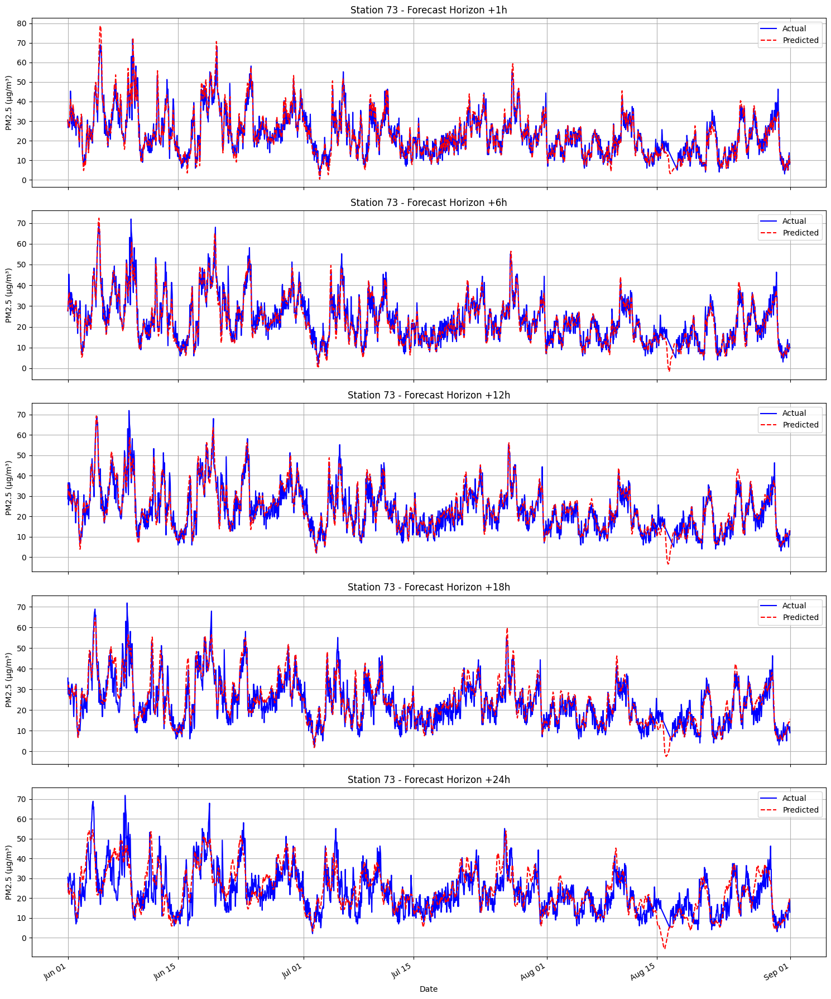

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta

# CONFIG
horizons = [0, 5, 11, 17, 23]  # +1h, +6h, +12h, +18h, +24h
horizon_labels = ['+1h', '+6h', '+12h', '+18h', '+24h']
year = 2021

# Generate timestamps
start_date = datetime(year, 1, 1, 0, 0)
timestamps = [start_date + timedelta(hours=i) for i in range(predictions.shape[0])]

# Filter summer
summer_mask = np.array([ts.month in [6, 7, 8] for ts in timestamps])
timestamps_summer = np.array(timestamps)[summer_mask]
actuals_summer = actuals[summer_mask, :, :]
preds_summer = predictions[summer_mask, :, :]

# Find the most polluted station (based on +1h forecast)
mean_pm25 = np.nanmean(actuals_summer[:, 0, :], axis=0)
station = np.argmax(mean_pm25)

# Create 5 subplots (one for each horizon)
fig, axes = plt.subplots(5, 1, figsize=(15, 18), sharex=True)

for i, (h, label) in enumerate(zip(horizons, horizon_labels)):
    ax = axes[i]
    true_series = actuals_summer[:, h, station]
    pred_series = preds_summer[:, h, station]

    mask = ~np.isnan(true_series) & ~np.isnan(pred_series)
    if np.sum(mask) == 0:
        print(f"No valid data for {label} at station {station}")
        continue

    times_valid = timestamps_summer[mask]
    true_valid = true_series[mask]
    pred_valid = pred_series[mask]

    ax.plot(times_valid, true_valid, 'b-', label='Actual')
    ax.plot(times_valid, pred_valid, 'r--', label='Predicted')
    ax.set_title(f'Station {station} - Forecast Horizon {label}')
    ax.set_ylabel('PM2.5 (μg/m³)')
    ax.grid(True)
    ax.legend()

    ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))

axes[-1].set_xlabel("Date")
plt.gcf().autofmt_xdate()
plt.tight_layout()
plt.show()


Top polluted station indices: [73, 62, 76]


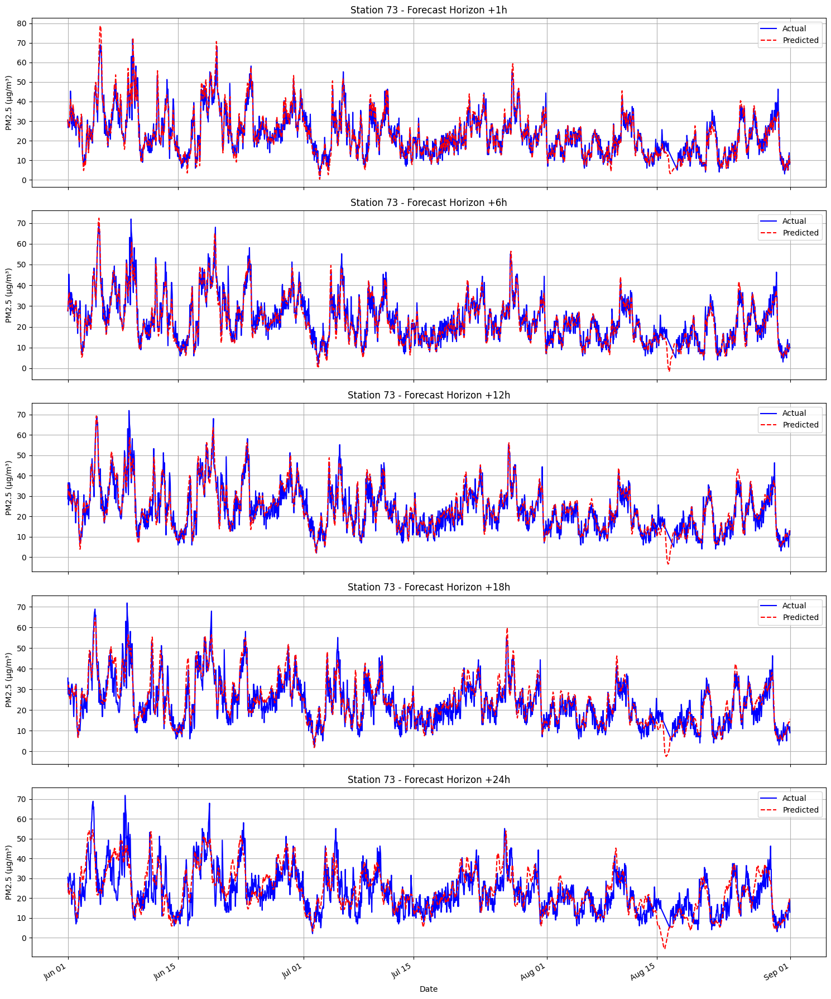

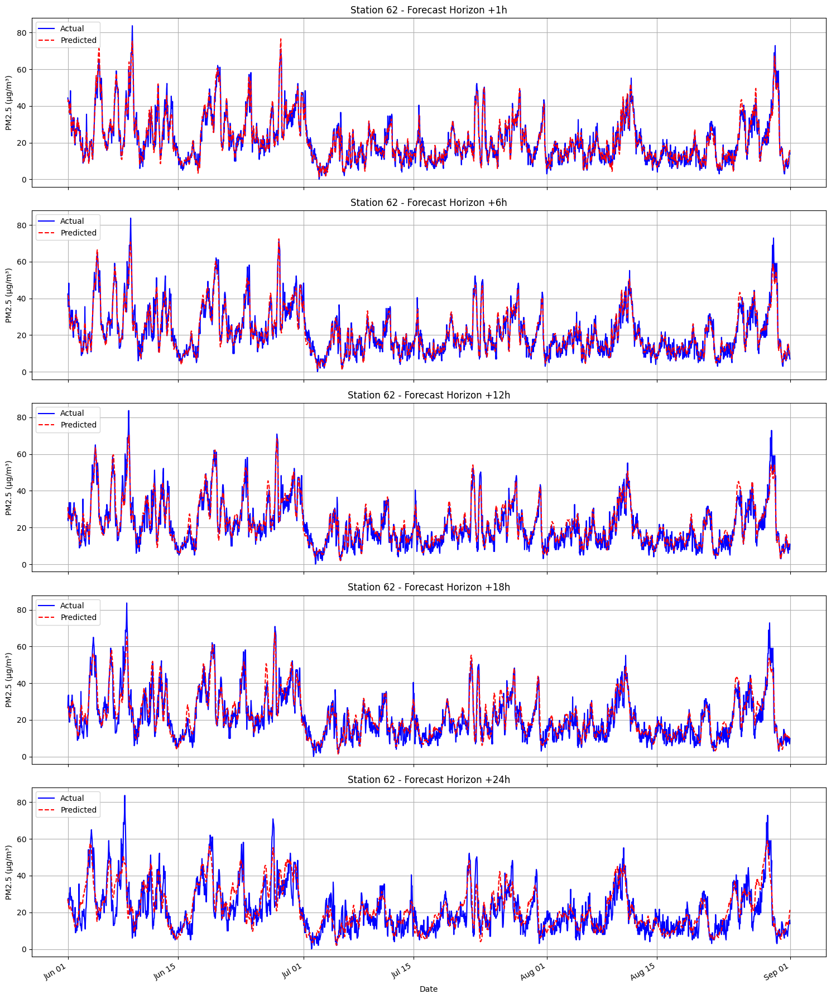

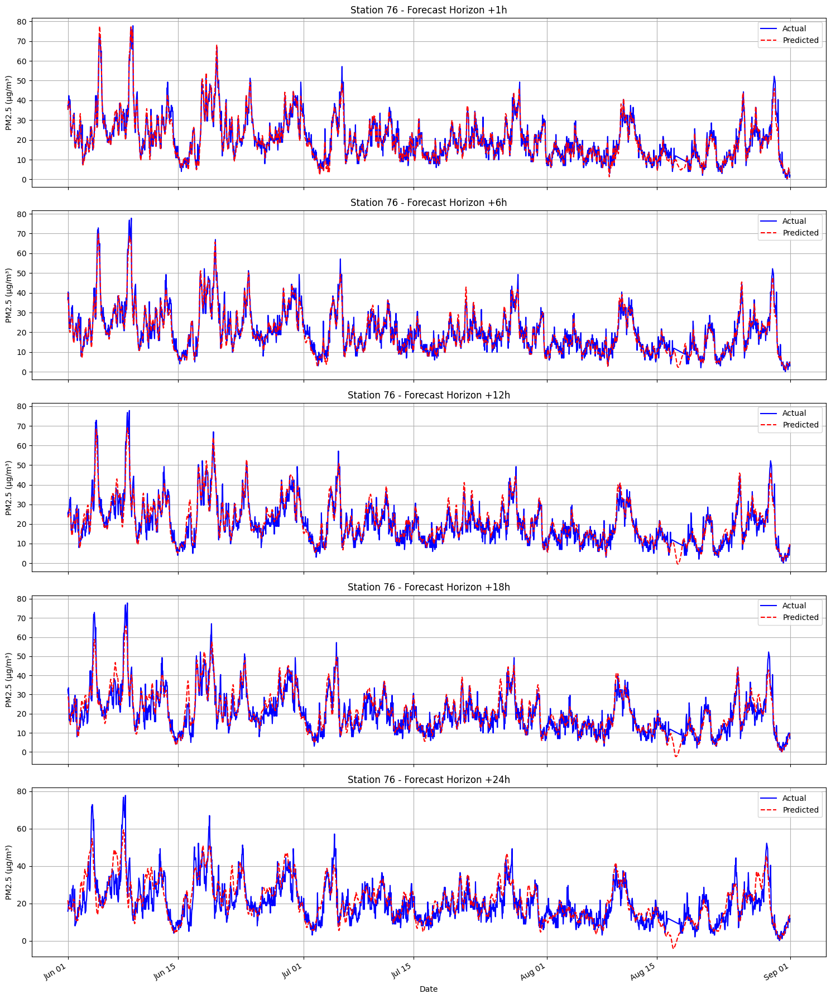

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta

# CONFIG
top_n_stations = 3
horizons = [0, 5, 11, 17, 23]  # +1h, +6h, +12h, +18h, +24h
horizon_labels = ['+1h', '+6h', '+12h', '+18h', '+24h']
year = 2021

# Generate hourly timestamps
start_date = datetime(year, 1, 1, 0, 0)
timestamps = [start_date + timedelta(hours=i) for i in range(predictions.shape[0])]

# Filter summer data (June, July, August)
summer_mask = np.array([ts.month in [6, 7, 8] for ts in timestamps])
timestamps_summer = np.array(timestamps)[summer_mask]
actuals_summer = actuals[summer_mask, :, :]
preds_summer = predictions[summer_mask, :, :]

# Get top N polluted stations based on mean +1h PM2.5
mean_pm25 = np.nanmean(actuals_summer[:, 0, :], axis=0)
top_station_indices = np.argsort(mean_pm25)[-top_n_stations:][::-1]

print("Top polluted station indices:", top_station_indices.tolist())

# Create 5 subplots for each of the top stations
for station in top_station_indices:
    fig, axes = plt.subplots(5, 1, figsize=(15, 18), sharex=True)

    for i, (h, label) in enumerate(zip(horizons, horizon_labels)):
        ax = axes[i]
        true_series = actuals_summer[:, h, station]
        pred_series = preds_summer[:, h, station]

        mask = ~np.isnan(true_series) & ~np.isnan(pred_series)
        if np.sum(mask) == 0:
            ax.set_title(f"Station {station} - No data for {label}")
            continue

        times_valid = timestamps_summer[mask]
        true_valid = true_series[mask]
        pred_valid = pred_series[mask]

        ax.plot(times_valid, true_valid, 'b-', label='Actual')
        ax.plot(times_valid, pred_valid, 'r--', label='Predicted')
        ax.set_title(f'Station {station} - Forecast Horizon {label}')
        ax.set_ylabel('PM2.5 (μg/m³)')
        ax.grid(True)
        ax.legend()

        ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))

    axes[-1].set_xlabel("Date")
    plt.gcf().autofmt_xdate()
    plt.tight_layout()
    plt.show()


Top 3 stations by AVG PM2.5: [57, 82, 134]
Top 3 stations by MAX PM2.5: [154, 147, 134]


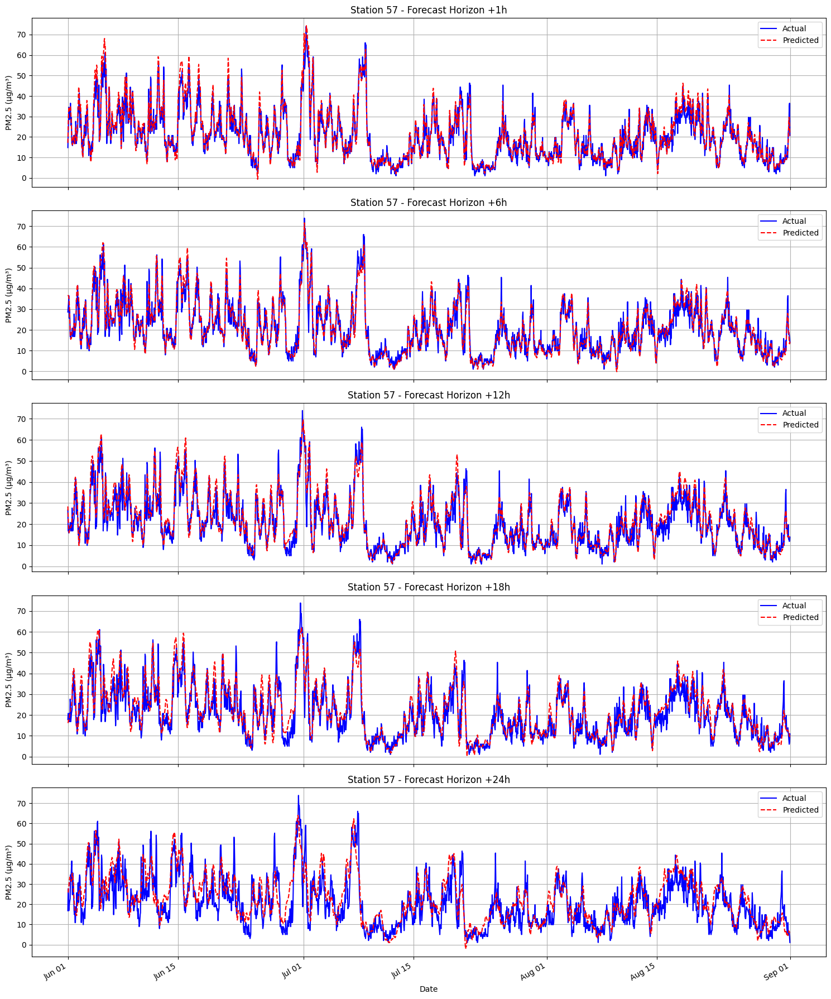

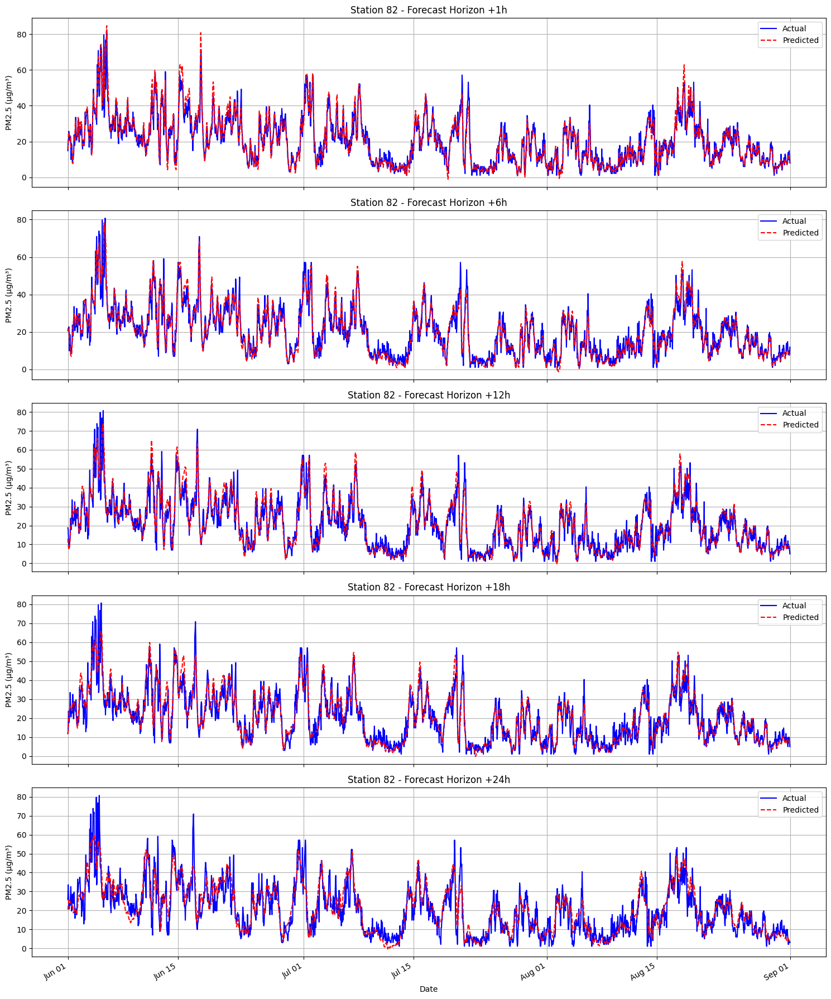

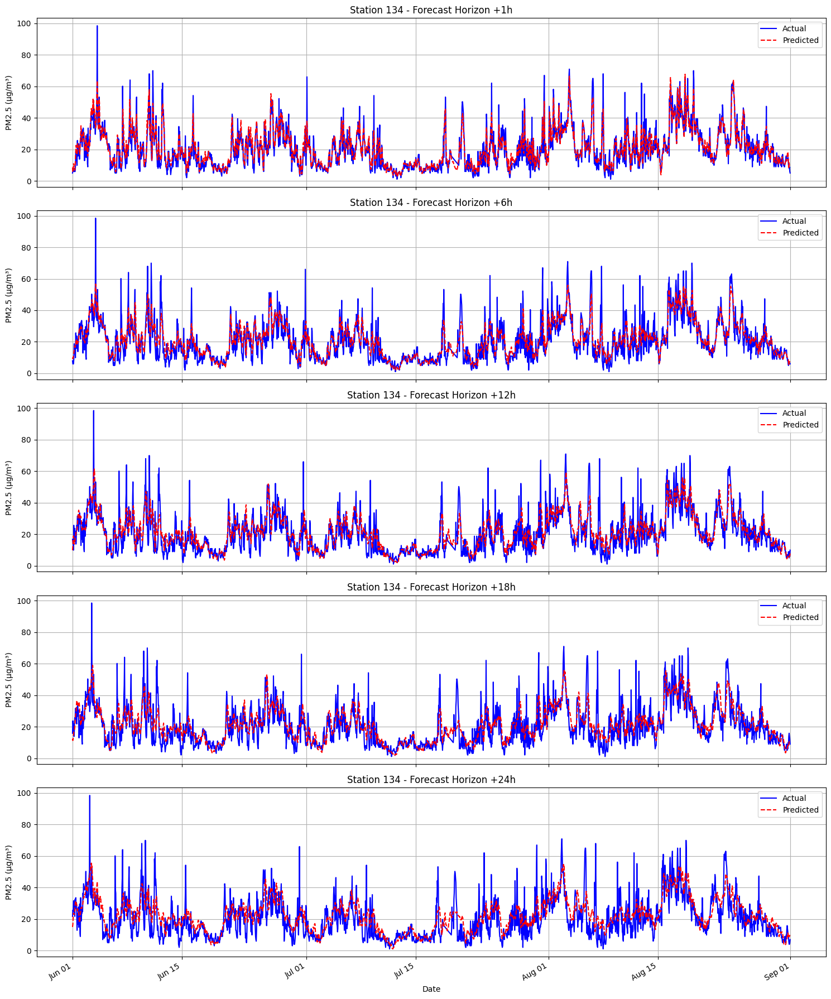

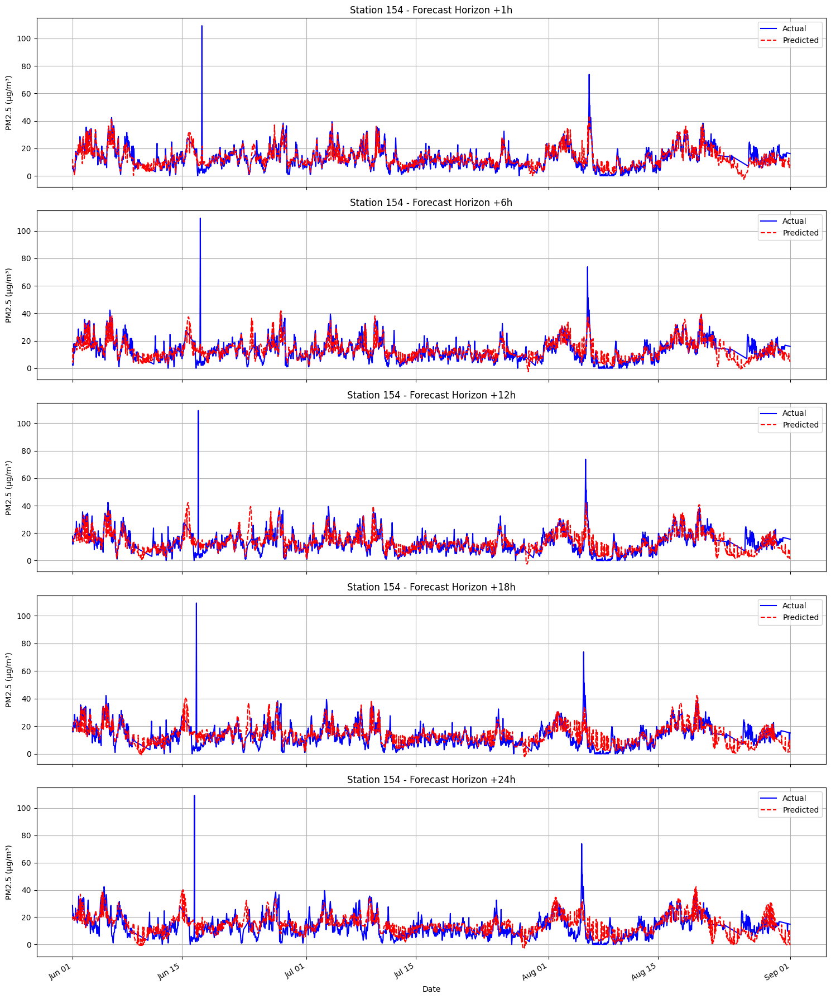

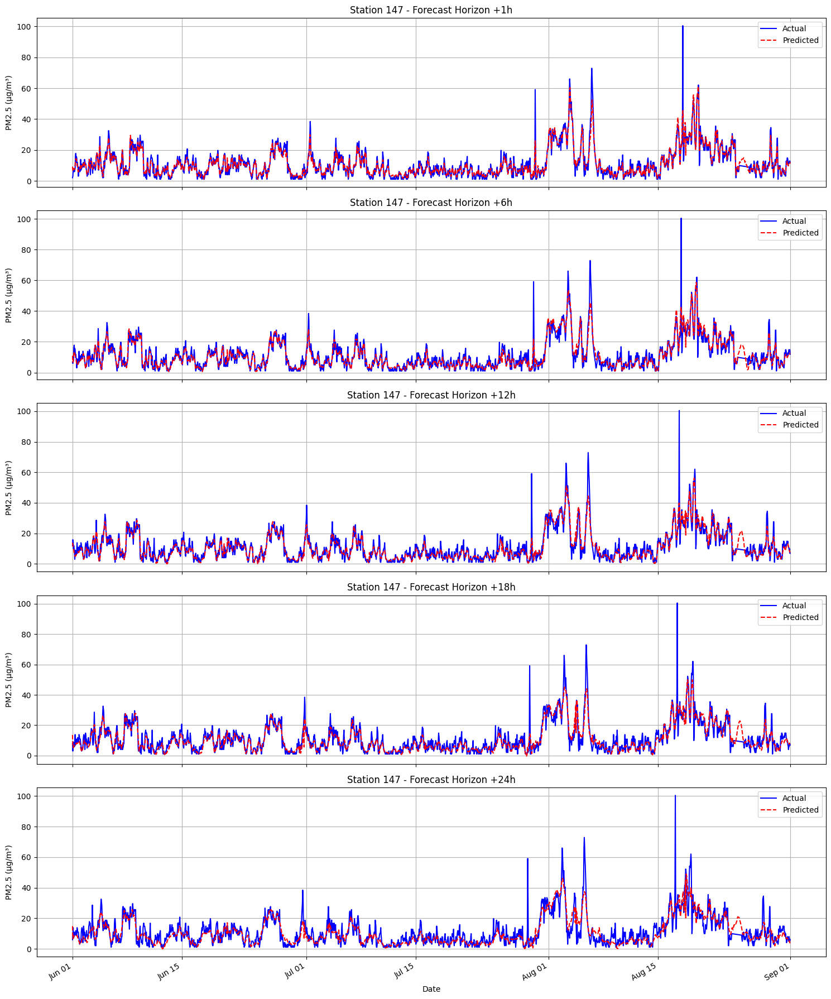

In [22]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta

# CONFIG
horizons = [0, 5, 11, 17, 23]  # +1h, +6h, +12h, +18h, +24h
horizon_labels = ['+1h', '+6h', '+12h', '+18h', '+24h']
year = 2021

# Timestamps
start_date = datetime(year, 1, 1, 0, 0)
timestamps = [start_date + timedelta(hours=i) for i in range(actuals.shape[0])]

# Filter summer (June, July, August)
summer_mask = np.array([ts.month in [6, 7, 8] for ts in timestamps])
timestamps_summer = np.array(timestamps)[summer_mask]
actuals_summer = actuals_2020[summer_mask, :, :]
preds_summer = predictions_2020[summer_mask, :, :]

# Compute average and max PM2.5 from actuals (horizon-agnostic)
avg_pm25 = np.nanmean(actuals_summer[:, 0, :], axis=0)  # avg over summer for +1h actuals
max_pm25 = np.nanmax(actuals_summer[:, 0, :], axis=0)   # max over summer for +1h actuals

top_avg_indices = np.argsort(avg_pm25)[-3:][::-1]  # Top 3 by avg
top_max_indices = np.argsort(max_pm25)[-3:][::-1]  # Top 3 by max

print("Top 3 stations by AVG PM2.5:", top_avg_indices.tolist())
print("Top 3 stations by MAX PM2.5:", top_max_indices.tolist())

# Combine unique stations (no duplicate plotting)
unique_stations = list(dict.fromkeys(list(top_avg_indices) + list(top_max_indices)))

# Plotting
for station in unique_stations:
    fig, axes = plt.subplots(5, 1, figsize=(15, 18), sharex=True)

    for i, (h, label) in enumerate(zip(horizons, horizon_labels)):
        ax = axes[i]
        true_series = actuals_summer[:, h, station]
        pred_series = preds_summer[:, h, station]

        mask = ~np.isnan(true_series) & ~np.isnan(pred_series)
        if np.sum(mask) == 0:
            ax.set_title(f"Station {station} - No data for {label}")
            continue

        time_valid = timestamps_summer[mask]
        ax.plot(time_valid, true_series[mask], 'b-', label='Actual')
        ax.plot(time_valid, pred_series[mask], 'r--', label='Predicted')

        ax.set_title(f"Station {station} - Forecast Horizon {label}")
        ax.set_ylabel("PM2.5 (μg/m³)")
        ax.grid(True)
        ax.legend()
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))

    axes[-1].set_xlabel("Date")
    plt.gcf().autofmt_xdate()
    plt.tight_layout()
    plt.show()


Top 3 stations with most PM2.5 > 75 μg/m³: [57, 144, 63]


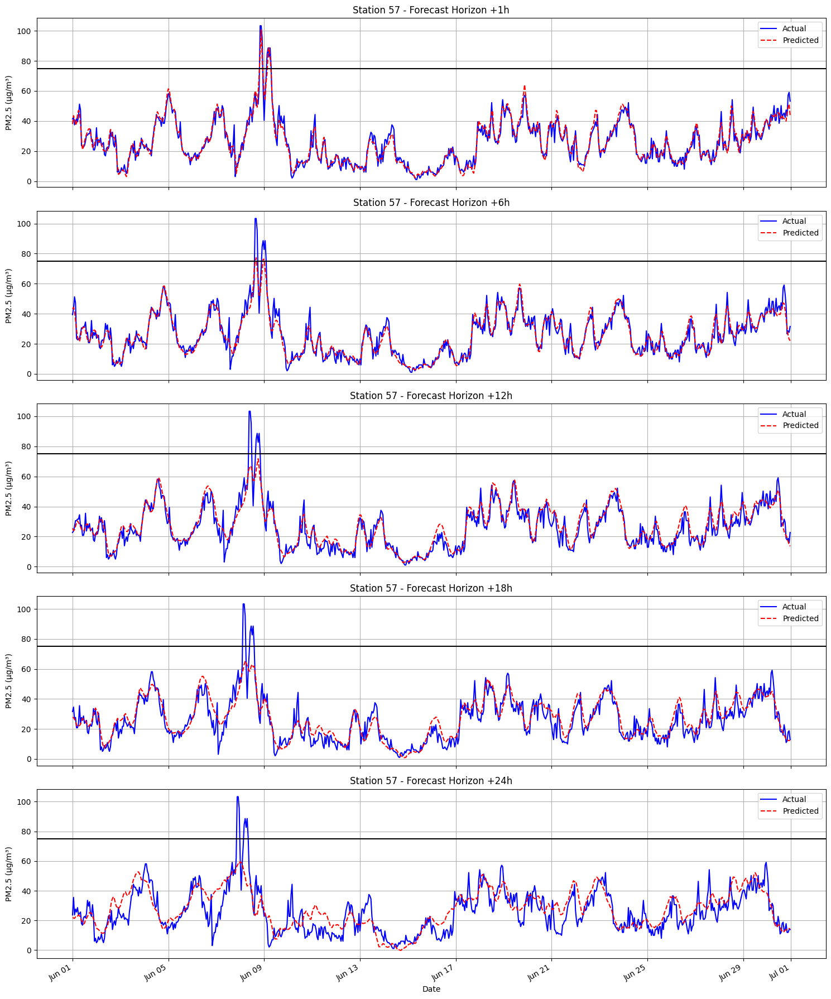

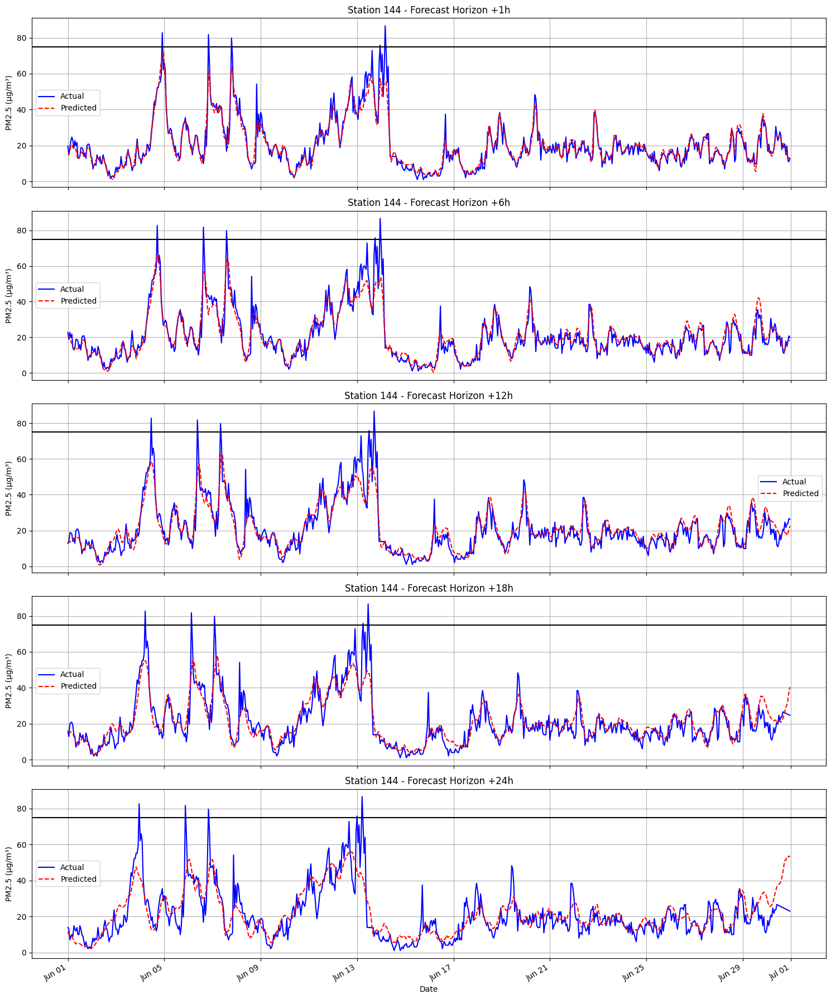

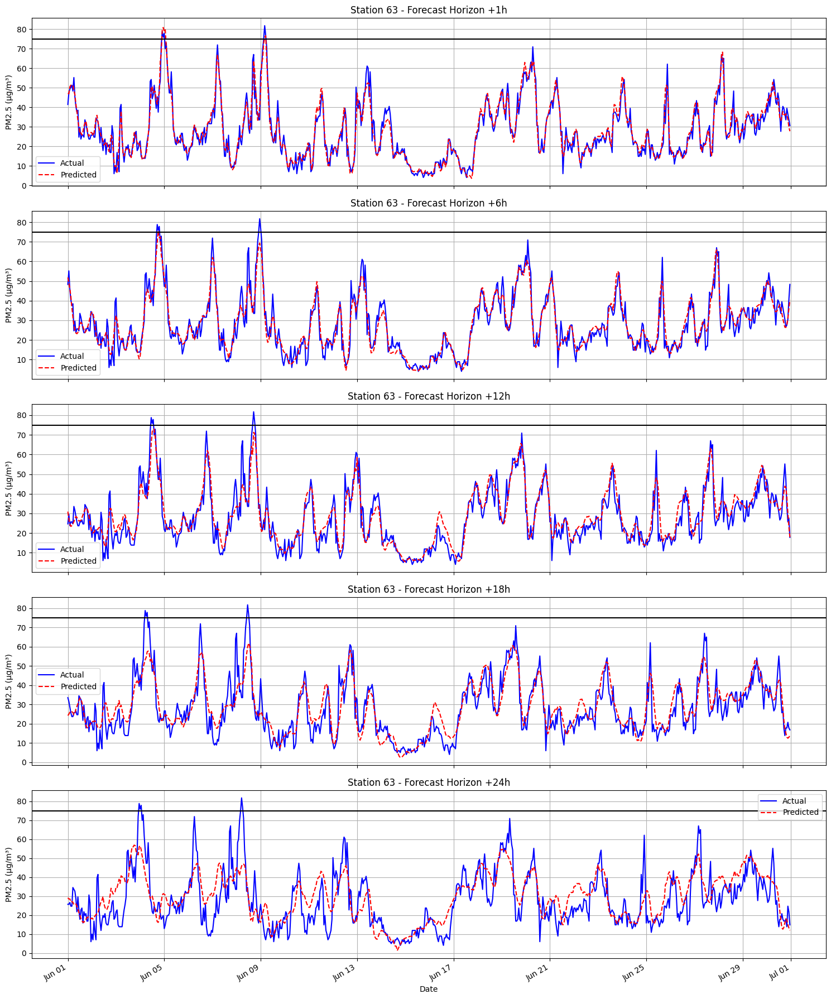

In [38]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta

# CONFIG
horizons = [0, 5, 11, 17, 23]  # +1h, +6h, +12h, +18h, +24h
horizon_labels = ['+1h', '+6h', '+12h', '+18h', '+24h']
threshold = 75  # Very Bad threshold in μg/m³
year = 2021

# Generate timestamps
start_date = datetime(year, 1, 1, 0, 0)
timestamps = [start_date + timedelta(hours=i) for i in range(actuals.shape[0])]

# Filter summer data, 7, 8
summer_mask = np.array([ts.month in [6] for ts in timestamps])
timestamps_summer = np.array(timestamps)[summer_mask]
actuals_summer = actuals[summer_mask, :, :]
preds_summer = predictions[summer_mask, :, :]

# Count exceedances (>75 μg/m³) per station at +1h
exceed_counts = np.sum(actuals_summer[:, 0, :] > threshold, axis=0)

# Get indices of top 3 stations with most exceedances
top_extreme_indices = np.argsort(exceed_counts)[-3:][::-1]
print("Top 3 stations with most PM2.5 > 75 μg/m³:", top_extreme_indices.tolist())

# Plotting
for station in top_extreme_indices:
    fig, axes = plt.subplots(5, 1, figsize=(15, 18), sharex=True)

    for i, (h, label) in enumerate(zip(horizons, horizon_labels)):
        ax = axes[i]
        true_series = actuals_summer[:, h, station]
        pred_series = preds_summer[:, h, station]

        mask = ~np.isnan(true_series) & ~np.isnan(pred_series)
        if np.sum(mask) == 0:
            ax.set_title(f"Station {station} - No data for {label}")
            continue

        time_valid = timestamps_summer[mask]
        ax.plot(time_valid, true_series[mask], 'b-', label='Actual')
        ax.plot(time_valid, pred_series[mask], 'r--', label='Predicted')

        # Highlight threshold
        ax.axhline(y=75, color='black', linestyle='-', linewidth=1.5)
        ax.set_title(f"Station {station} - Forecast Horizon {label}")
        ax.set_ylabel("PM2.5 (μg/m³)")
        ax.grid(True)
        ax.legend()
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))

    axes[-1].set_xlabel("Date")
    plt.gcf().autofmt_xdate()
    plt.tight_layout()
    plt.show()


Top 3 stations by IOA (+1h summer): [39, 12, 4]


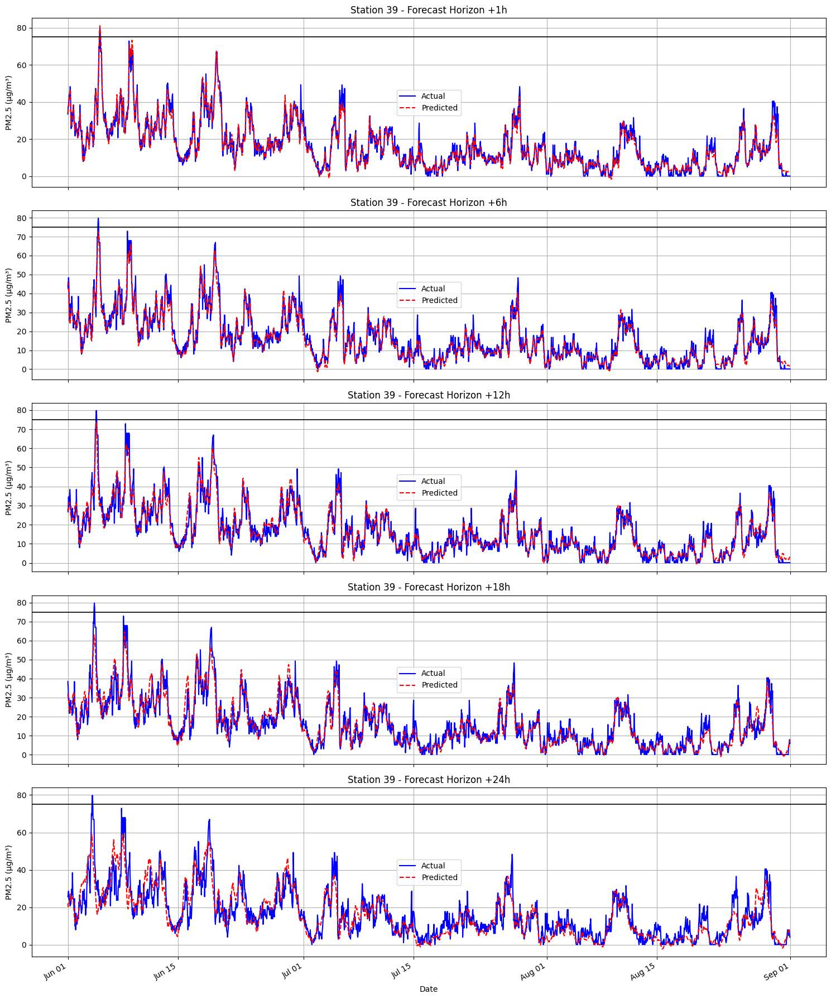

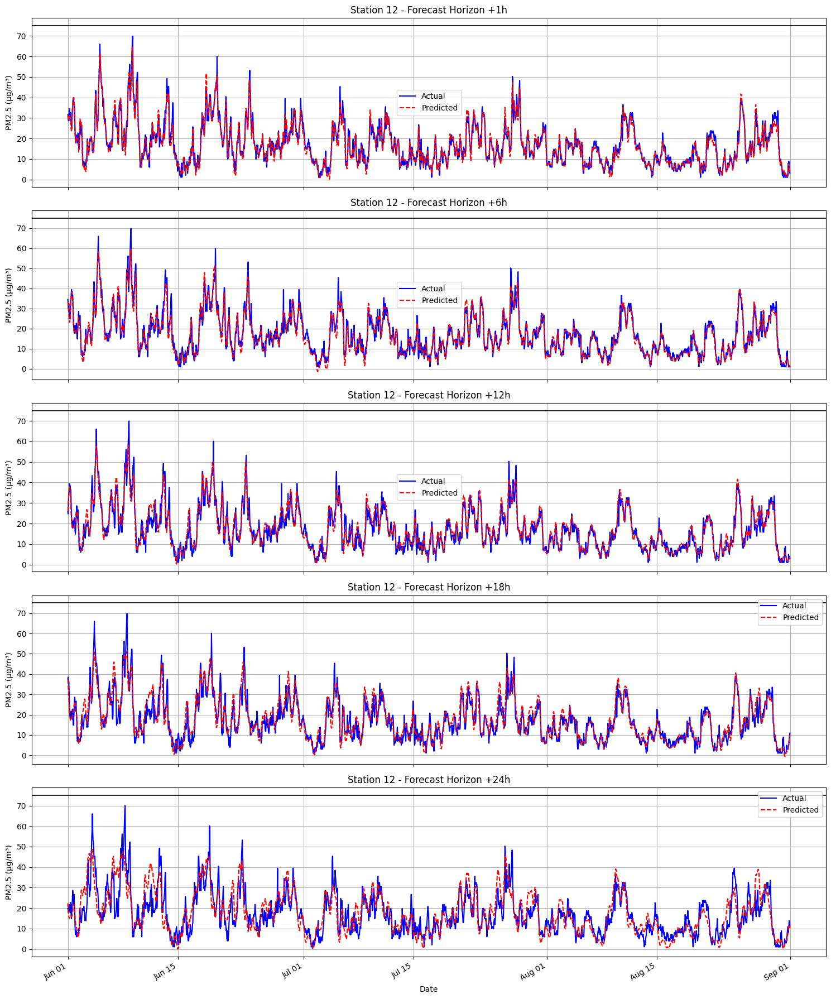

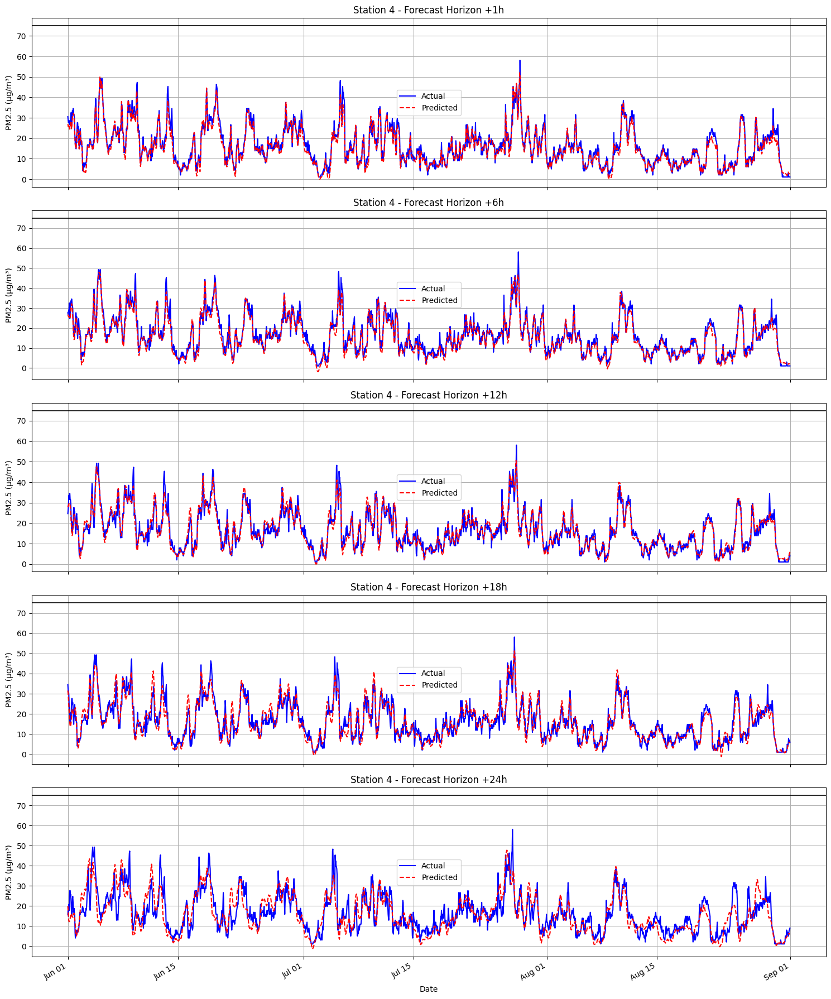

In [37]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta

# CONFIG
horizons = [0, 5, 11, 17, 23]  # +1h, +6h, +12h, +18h, +24h
horizon_labels = ['+1h', '+6h', '+12h', '+18h', '+24h']
year = 2021

# IOA calculation
def calculate_ioa(y_true, y_pred):
    mask = ~np.isnan(y_true) & ~np.isnan(y_pred)
    if np.sum(mask) == 0:
        return np.nan
    y_true = y_true[mask]
    y_pred = y_pred[mask]
    y_mean = np.mean(y_true)
    numerator = np.sum((y_pred - y_true) ** 2)
    denominator = np.sum((np.abs(y_pred - y_mean) + np.abs(y_true - y_mean)) ** 2) + 1e-6
    return 1 - (numerator / denominator)

# Generate timestamps
start_date = datetime(year, 1, 1, 0, 0)
timestamps = [start_date + timedelta(hours=i) for i in range(actuals.shape[0])]

# Filter summer data
summer_mask = np.array([ts.month in [6, 7, 8] for ts in timestamps])
timestamps_summer = np.array(timestamps)[summer_mask]
actuals_summer = actuals[summer_mask, :, :]
preds_summer = predictions[summer_mask, :, :]

# Compute IOA at +1h for each station
ioa_scores = []
for station in range(actuals.shape[2]):
    true_series = actuals_summer[:, 0, station]
    pred_series = preds_summer[:, 0, station]
    ioa = calculate_ioa(true_series, pred_series)
    ioa_scores.append(ioa)

ioa_scores = np.array(ioa_scores)
top_ioa_indices = np.argsort(ioa_scores)[-3:][::-1]
print("Top 3 stations by IOA (+1h summer):", top_ioa_indices.tolist())

# Plotting
for station in top_ioa_indices:
    fig, axes = plt.subplots(5, 1, figsize=(15, 18), sharex=True)

    for i, (h, label) in enumerate(zip(horizons, horizon_labels)):
        ax = axes[i]
        true_series = actuals_summer[:, h, station]
        pred_series = preds_summer[:, h, station]

        mask = ~np.isnan(true_series) & ~np.isnan(pred_series)
        if np.sum(mask) == 0:
            ax.set_title(f"Station {station} - No data for {label}")
            continue

        time_valid = timestamps_summer[mask]
        ax.plot(time_valid, true_series[mask], 'b-', label='Actual')
        ax.plot(time_valid, pred_series[mask], 'r--', label='Predicted')

        # Reference line at 75 μg/m³
        ax.axhline(y=75, color='black', linestyle='-', linewidth=1.2)

        ax.set_title(f"Station {station} - Forecast Horizon {label}")
        ax.set_ylabel("PM2.5 (μg/m³)")
        ax.grid(True)
        ax.legend()
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))

    axes[-1].set_xlabel("Date")
    plt.gcf().autofmt_xdate()
    plt.tight_layout()
    plt.show()


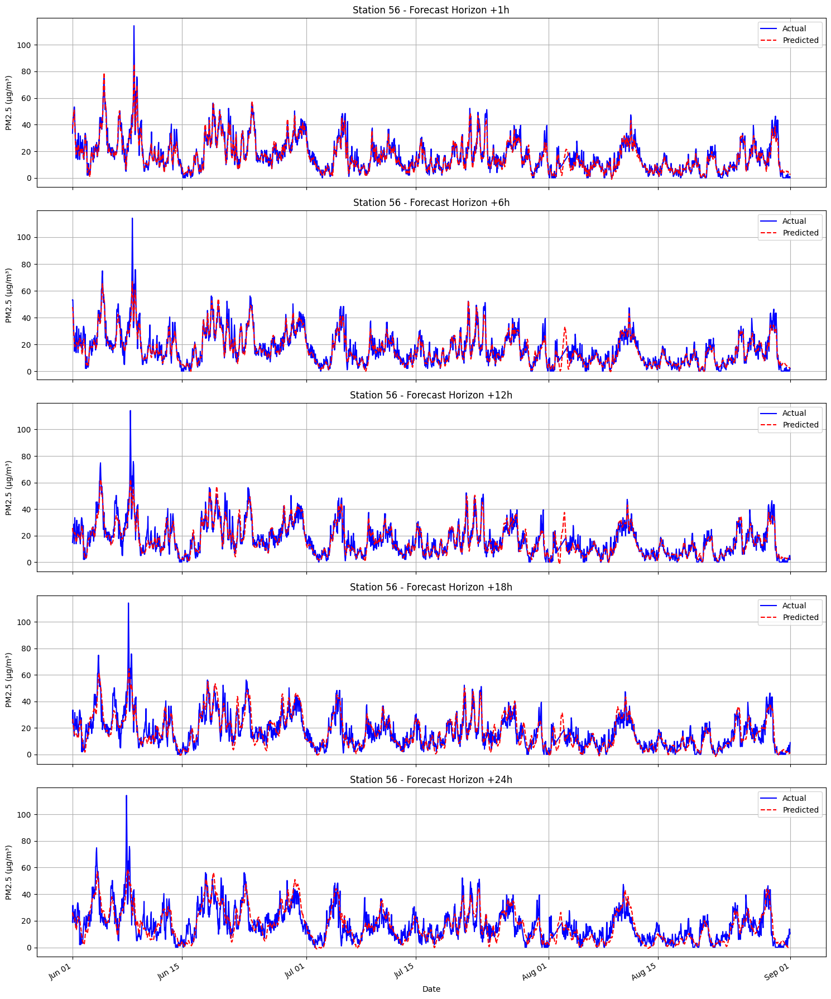

In [34]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta

# CONFIG
station = 56
horizons = [0, 5, 11, 17, 23]  # +1h, +6h, +12h, +18h, +24h
horizon_labels = ['+1h', '+6h', '+12h', '+18h', '+24h']
year = 2021

# Generate timestamps
start_date = datetime(year, 1, 1, 0, 0)
timestamps = [start_date + timedelta(hours=i) for i in range(actuals.shape[0])]

# Filter summer data
summer_mask = np.array([ts.month in [6, 7, 8] for ts in timestamps])
timestamps_summer = np.array(timestamps)[summer_mask]
actuals_summer = actuals[summer_mask, :, :]
preds_summer = predictions[summer_mask, :, :]

# Create 5 subplots in one figure
fig, axes = plt.subplots(5, 1, figsize=(15, 18), sharex=True)

for i, (h, label) in enumerate(zip(horizons, horizon_labels)):
    ax = axes[i]
    true_series = actuals_summer[:, h, station]
    pred_series = preds_summer[:, h, station]

    mask = ~np.isnan(true_series) & ~np.isnan(pred_series)
    if np.sum(mask) == 0:
        ax.set_title(f"Station {station} - No data for {label}")
        continue

    time_valid = timestamps_summer[mask]
    true_valid = true_series[mask]
    pred_valid = pred_series[mask]

    ax.plot(time_valid, true_valid, 'b-', label='Actual')
    ax.plot(time_valid, pred_valid, 'r--', label='Predicted')
    ax.set_title(f"Station {station} - Forecast Horizon {label}")
    ax.set_ylabel("PM2.5 (μg/m³)")
    ax.grid(True)
    ax.legend()
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))

axes[-1].set_xlabel("Date")
plt.gcf().autofmt_xdate()
plt.tight_layout()

# Save the figure
plt.savefig(f"/global/homes/r/rdimri/ADR_GNN/station_{station}_summer_forecasts.png", dpi=300)
plt.show()


In [24]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
from scipy.spatial import distance
import networkx as nx
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from adrgnn_train import ADR_GNN, DirectionalWeights
from graph import graph

# Set up the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

def load_checkpoint_and_model(checkpoint_path='checkpoints/best_model.pth'):
    """
    Load the saved model checkpoint and initialize the model
    """
    # Load coordinates data
    lats = np.load('data/lats.npy')
    lons = np.load('data/lons.npy')
    n_stations = len(lats)
    
    # Load model checkpoint
    checkpoint = torch.load(checkpoint_path, map_location=device)
    
    # Initialize model with same parameters as during training
    model = ADR_GNN(
        input_features=43,  # Based on the code, this is the number of features
        n_stations=n_stations,
        seq_length=24,
        pred_length=72,
        L=1,
        state_dim=64,
        hist_dim=64,
    )
    
    # Initialize graph processor
    model.initialize_graph_processor(lats, lons)
    
    # Load state dictionary
    model.load_state_dict(checkpoint['model_state_dict'])
    model.to(device)
    model.eval()
    
    print(f"Loaded model from epoch {checkpoint['epoch']}")
    print(f"Validation MAE: {checkpoint['val_mae']:.4f}, Validation IOA: {checkpoint['val_ioa']:.4f}")
    
    return model, lats, lons, checkpoint

def load_sample_data(batch_size=1):
    """
    Load a sample of input data for analysis
    """
    # Load scaled data
    scaled_data = np.load('/pscratch/sd/r/rdimri/BSL_PM25/scaled_data.npy')
    final_features = np.load('/pscratch/sd/r/rdimri/BSL_PM25/final_features.npy')
    data = np.concatenate([final_features, scaled_data[:-1, :, -1:]], axis=-1)
    
    # Create a sequence for the first time step
    sample_seq = data[0:24]  # First 24 hours
    sample_seq = np.expand_dims(sample_seq, axis=0)  # Add batch dimension
    sample_seq = np.tile(sample_seq, (batch_size, 1, 1, 1))  # Replicate if batch_size > 1
    
    return torch.FloatTensor(sample_seq).to(device)

def extract_advection_weights(model, sample_data):
    """
    Extract advection weights from the model using sample data
    """
    # Get wind data from sample
    wind_indices = [0, 1, 2, 3]
    wind = sample_data[..., wind_indices]
    
    # Recover wind speed and direction
    wind_speed, wind_direction = model.recover_wind_parameters(
        wind[..., 0], wind[..., 1], wind[..., 2], wind[..., 3]
    )
    wind_data = torch.stack([wind_speed, wind_direction], dim=1)
    
    # Get graph structure
    edge_index, edge_weights, _ = model.graph_processor.construct_graph(wind_data[:, :, -1, :])
    
    # Process input for directional weights
    batch_size = sample_data.size(0)
    
    # Extract features needed for hist_wind
    wind_hist = wind.permute(0, 2, 1, 3).reshape(batch_size, model.n_stations, -1)
    pos_indices = [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27]
    pos = sample_data[..., pos_indices]
    pos_hist = pos.permute(0, 2, 1, 3).reshape(batch_size, model.n_stations, -1)
    
    temporal_indices = [4, 5, 6, 7, 8, 9, 10, 11]
    temporal = sample_data[..., temporal_indices]
    g_time_input = temporal.permute(0, 2, 1, 3).reshape(batch_size, model.n_stations, -1)
    g_time_input = model.g_time(g_time_input)
    
    # Create hist_wind input
    g_hist_wind = torch.cat([
        wind_hist, pos_hist, g_time_input
    ], dim=-1)
    g_hist_wind = model.g_hist_wind(g_hist_wind)
    
    # Get advection weights using the directional weights module
    with torch.no_grad():
        Vij, Vji = model.directional_weights(g_hist_wind, edge_index.long(), model.n_stations)
    
    return Vij, Vji, edge_index, edge_weights

def extract_diffusion_weights(model):
    """
    Extract diffusion weights from the model
    """
    with torch.no_grad():
        # Get the diffusion coefficients K
        diffusion_params = model.diffusion_params
        K = model.get_K(diffusion_params)
    
    return K.cpu().numpy()

def visualize_advection_weights(Vij, Vji, edge_index, lats, lons):
    """
    Visualize advection weights on a map
    """
    # Convert to numpy
    Vij_np = Vij.cpu().numpy()
    Vji_np = Vji.cpu().numpy()
    edge_index_np = edge_index[0].cpu().numpy()  # Just use the first batch
    
    # Create a dataframe for edge visualization
    edges_df = pd.DataFrame({
        'source': edge_index_np[0],
        'target': edge_index_np[1],
        'Vij': Vij_np[0],  # First batch
        'Vji': Vji_np[0]   # First batch
    })
    
    # Create a directed graph
    G = nx.DiGraph()
    
    # Add nodes with positions
    for i in range(len(lats)):
        G.add_node(i, pos=(lons[i], lats[i]))
    
    # Filter to include only significant edges (weight > threshold)
    threshold = np.percentile(edges_df['Vij'], 95)  # Top 5% of edges
    significant_edges = edges_df[edges_df['Vij'] > threshold]
    
    # Add edges with weights
    for _, edge in significant_edges.iterrows():
        G.add_edge(edge['source'], edge['target'], weight=edge['Vij'])
    
    # Get node positions
    pos = nx.get_node_attributes(G, 'pos')
    
    # Create a map visualization using cartopy
    plt.figure(figsize=(12, 10))
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.STATES)
    
    # Add background map
    ax.stock_img()
    
    # Draw nodes
    nx.draw_networkx_nodes(G, pos, node_size=20, node_color='red', alpha=0.7, ax=ax)
    
    # Draw edges with colors based on weight
    edges = G.edges(data=True)
    weights = [d['weight'] for _, _, d in edges]
    
    # Normalize weights for coloring
    if weights:
        norm_weights = [(w - min(weights)) / (max(weights) - min(weights) + 1e-6) for w in weights]
        cmap = plt.cm.Blues
        nx.draw_networkx_edges(G, pos, width=2, edge_color=norm_weights, edge_cmap=cmap, 
                             arrows=True, arrowsize=10, arrowstyle='->', ax=ax)
    
    # Set map extent to focus on region of interest
    margin = 1  # degrees
    ax.set_extent([min(lons) - margin, max(lons) + margin, 
                  min(lats) - margin, max(lats) + margin])
    
    plt.title('Significant Advection Pathways (Vij)')
    plt.savefig('advection_map.png', dpi=300, bbox_inches='tight')
    plt.close()
    
    # Create a heatmap of all advection weights
    plt.figure(figsize=(12, 10))
    
    # Create an adjacency matrix
    n_stations = len(lats)
    adj_matrix = np.zeros((n_stations, n_stations))
    
    for _, edge in edges_df.iterrows():
        adj_matrix[int(edge['source']), int(edge['target'])] = edge['Vij']
    
    # Mask zeros for better visualization
    masked_adj = np.ma.masked_where(adj_matrix == 0, adj_matrix)
    
    # Plot heatmap
    sns.heatmap(masked_adj, cmap='viridis', xticklabels=False, yticklabels=False)
    plt.title('Advection Weights Matrix (Vij)')
    plt.xlabel('Target Nodes')
    plt.ylabel('Source Nodes')
    plt.savefig('advection_heatmap.png', dpi=300, bbox_inches='tight')
    plt.close()

def visualize_diffusion_weights(K):
    """
    Visualize diffusion weights across channels
    """
    plt.figure(figsize=(10, 6))
    plt.bar(range(len(K)), K)
    plt.xlabel('Channel Index')
    plt.ylabel('Diffusion Coefficient (K)')
    plt.title('Learned Diffusion Coefficients Across Channels')
    plt.grid(alpha=0.3)
    plt.savefig('diffusion_weights.png', dpi=300, bbox_inches='tight')
    plt.close()
    
    # Additional visualization as a heatmap for better visibility
    K_reshaped = K.reshape(1, -1)
    plt.figure(figsize=(12, 3))
    sns.heatmap(K_reshaped, cmap='coolwarm', annot=False, cbar=True)
    plt.title('Diffusion Coefficients Heatmap')
    plt.xlabel('Channel Index')
    plt.yticks([])
    plt.savefig('diffusion_heatmap.png', dpi=300, bbox_inches='tight')
    plt.close()

def run_analysis():
    """
    Main function to run the analysis and visualization
    """
    print("Loading model checkpoint...")
    model, lats, lons, checkpoint = load_checkpoint_and_model()
    
    print("Loading sample data...")
    sample_data = load_sample_data()
    
    print("Extracting advection weights...")
    Vij, Vji, edge_index, edge_weights = extract_advection_weights(model, sample_data)
    
    print("Extracting diffusion weights...")
    K = extract_diffusion_weights(model)
    
    print("Creating visualizations...")
    visualize_advection_weights(Vij, Vji, edge_index, lats, lons)
    visualize_diffusion_weights(K)
    
    print("Analysis complete. Visualization files saved.")

if __name__ == "__main__":
    run_analysis()

ModuleNotFoundError: No module named 'torch_geometric'

In [18]:
predictions = np.load('/pscratch/sd/r/rdimri/ADR_GNN/evaluation_results/adr_gnn_addt/predictions.npy')
actuals = np.load('/pscratch/sd/r/rdimri/ADR_GNN/evaluation_results/adr_gnn_addt/targets.npy')
print(f'Prediction shape is {predictions.shape} and Traget shape is {actuals.shape}')

Prediction shape is (8676, 72, 170) and Traget shape is (8676, 72, 170)


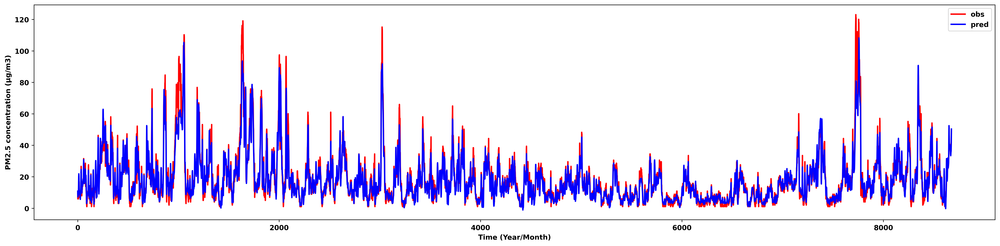

In [55]:
import matplotlib.pyplot as plt
from matplotlib.font_manager import FontProperties
import numpy as np
import matplotlib as mpl

mpl.rcParams['font.weight'] = 'bold'
mpl.rcParams['axes.labelweight'] = 'bold'
mpl.rcParams['axes.titleweight'] = 'bold'
mpl.rcParams['xtick.labelsize'] = 10
mpl.rcParams['ytick.labelsize'] = 10
plt.figure(figsize=(20, 5), dpi=400)

plt.plot(actuals[:, 0, 11], label='obs', linewidth=2, color='r')
# plt.plot(y_test[:, 0, 91], label='unscaled_obs', linewidth=2, color='g')
plt.plot(predictions[:, 0, 11], label='pred', linewidth=2, color='b')
# plt.plot(date, np.mean(pred_gnn[:, 20, :24], axis = 1), label='PM2.5GNN-GRU', linewidth=2, color=colors[1])
# plt.plot(date, np.mean(labe_agat[:, 20, :24], axis = 1), label='Observations', linewidth=2, linestyle='--', color=colors[2])

plt.xlabel('Time (Year/Month)', fontweight='bold')
plt.ylabel('PM2.5 concentration (μg/m3)', fontweight='bold')
# plt.title('Day 1: Model Predictions vs Actual Data', fontweight='bold')
plt.legend()

plt.tick_params(axis='both', which='major', labelsize=10)

plt.tight_layout()

# plt.savefig('/tng4/users/rdimri/time_series_day1.jpg', format='jpg', dpi=400, bbox_inches='tight')

plt.show()
# plt.plot()

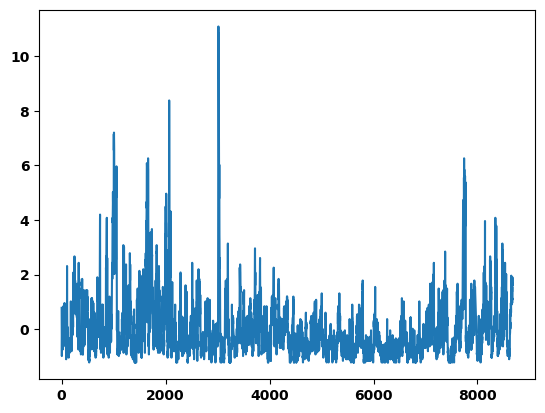

In [46]:
plt.plot(actuals[:, 0, 80])

In [5]:
filtered = np.load('/global/homes/r/rdimri/filtered_data.npy')
test_data = filtered[3*8760:-1]
test_data.shape

(8772, 170, 39)

In [15]:
filtered = np.load('/global/homes/r/rdimri/filtered_data.npy')
test_data = filtered[2*8760:3*8760]
test_data.shape

(8760, 170, 39)

In [3]:
import joblib

# Load PM2.5 scaler
pm25_scaler = joblib.load("/global/homes/r/rdimri/pm25_scaler.pkl")

# Flatten for inverse_transform
def unscale_pm25(pred_scaled, scaler):
    samples, horizons, stations = pred_scaled.shape
    pred_flat = pred_scaled.reshape(-1, 1)  # Shape: (samples * horizons * stations, 1)
    pred_unscaled_flat = scaler.inverse_transform(pred_flat)
    return pred_unscaled_flat.reshape(samples, horizons, stations)

predictions = unscale_pm25(predictions, pm25_scaler)
actuals = unscale_pm25(actuals, pm25_scaler)
print(f'Prediction shape is {predictions.shape} and Traget shape is {actuals.shape}')


/pscratch/sd/r/rdimri/conda_envs/gnn_env/lib/python3.11/site-packages/sklearn/base.py:380: InconsistentVersionWarning: Trying to unpickle estimator StandardScaler from version 1.5.2 when using version 1.6.0. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Prediction shape is (8676, 72, 170) and Traget shape is (8676, 72, 170)


In [6]:
def create_sequences(data, seq_length = 24, target_horizons = 72):
    """
    Create sequences for training with specific forecast horizon
    
    Args:
        data: Shape (samples, nodes, features)
        original_pm25: Shape (samples, nodes) - contains original PM2.5 values
        seq_length: Input sequence length
        target_horizons: List of specific forecast horizons
        
    Returns:
        sequences: Shape (num_sequences, seq_length, nodes, features)
        targets: Shape (num_sequences, len(target_horizons), nodes)
    """
    sequences = []
    targets = []
    
    # max_horizon = max(target_horizons)
    
    for i in range(len(data) - seq_length - target_horizons):
        # Input sequence
        seq = data[i:(i + seq_length)]
        
        # Target sequence (PM2.5 values only) , original_pm25
        target = [
         data[(i + seq_length) : (i + seq_length + target_horizons), :, -1] # 
        ]
                
        sequences.append(seq)
        targets.append(target)
        
    return np.array(sequences), np.array(np.squeeze(targets))

X_test, y_test = create_sequences(test_data, seq_length=24, target_horizons=72)

In [7]:
X_test.shape, y_test.shape

((8676, 24, 170, 39), (8676, 72, 170))

In [39]:
np.mean(ioa_all)

0.4378131200285519

In [87]:
var = np.array(ioa_all)
var[90:100]

array([0.96949816, 0.99020605, 0.96170232, 0.96092122, 0.97250972,
       0.96238489, 0.94718063, 0.9697248 , 0.96246648, 0.94239873])

In [46]:
np.mean(np.array(ioa_all)[:24])

0.9219622578627119

In [49]:
actuals_agatnet.shape

(8664, 170, 72)

In [39]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta
from sklearn.metrics import mean_squared_error, mean_absolute_error
import joblib

# Function to ensure we're working with unscaled values
def ensure_unscaled_values(data, scaler=None):
    """
    Ensure the PM2.5 values are properly unscaled
    
    Args:
        data: The data array to check and possibly unscale
        scaler: The scaler object used to inverse transform (optional)
    
    Returns:
        Unscaled data array
    """
    # If data appears to be already unscaled (values > 100), return as is
    if np.nanmax(data) > 100:
        return data
        
    # If scaler is provided, use it to unscale
    if scaler is not None:
        samples, horizons, stations = data.shape
        data_flat = data.reshape(-1, 1)
        data_unscaled_flat = scaler.inverse_transform(data_flat)
        return data_unscaled_flat.reshape(samples, horizons, stations)
        
    # If no scaler, provide warning and return original data
    print("Warning: No scaler provided, and data appears to be scaled. Results may not show actual PM2.5 levels.")
    return data

# Find extreme pollution stations in summer and plot their time series
def analyze_extreme_pollution_stations(predictions, actuals, year=2021, top_n=5, scaler=None):
    """
    Identify stations with extreme pollution during summer and plot their time series
    
    Args:
        predictions: Predictions array (samples, horizons, stations)
        actuals: Actual values array (samples, horizons, stations)
        year: Year of analysis (default: 2021)
        top_n: Number of top polluted stations to analyze (default: 5)
        scaler: PM2.5 scaler object for unscaling (optional)
    """
    # Ensure values are properly unscaled
    predictions_unscaled = ensure_unscaled_values(predictions, scaler)
    actuals_unscaled = ensure_unscaled_values(actuals, scaler)
    
    # Create timestamps for the dataset
    start_date = datetime(year, 1, 1, 0, 0)
    dates = [start_date + timedelta(hours=i) for i in range(predictions_unscaled.shape[0])]
    
    # Extract summer indices (June, July, August)
    summer_indices = [i for i, date in enumerate(dates) if date.month in [6, 7, 8]]
    
    if not summer_indices:
        print("No summer data available")
        return
    
    # Extract summer data
    summer_dates = [dates[i] for i in summer_indices]
    summer_actuals = actuals_unscaled[summer_indices, 0, :]  # First forecast hour
    
    # Calculate average PM2.5 for each station during summer
    station_avg_pm25 = np.nanmean(summer_actuals, axis=0)
    
    # Calculate max PM2.5 for each station during summer
    station_max_pm25 = np.nanmax(summer_actuals, axis=0)
    
    # Get stations with highest average pollution
    avg_rank_indices = np.argsort(station_avg_pm25)[::-1]  # Sort in descending order
    
    # Get stations with highest maximum pollution
    max_rank_indices = np.argsort(station_max_pm25)[::-1]  # Sort in descending order
    
    # Print information about top polluted stations
    print(f"\n{'='*60}")
    print(f"TOP {top_n} STATIONS WITH HIGHEST AVERAGE PM2.5 IN SUMMER {year}")
    print(f"{'='*60}")
    for i in range(min(top_n, len(avg_rank_indices))):
        station_idx = avg_rank_indices[i]
        if not np.isnan(station_avg_pm25[station_idx]):
            print(f"Station {station_idx}: Avg PM2.5 = {station_avg_pm25[station_idx]:.2f} μg/m³, Max PM2.5 = {station_max_pm25[station_idx]:.2f} μg/m³")
    
    print(f"\n{'='*60}")
    print(f"TOP {top_n} STATIONS WITH HIGHEST MAXIMUM PM2.5 IN SUMMER {year}")
    print(f"{'='*60}")
    for i in range(min(top_n, len(max_rank_indices))):
        station_idx = max_rank_indices[i]
        if not np.isnan(station_max_pm25[station_idx]):
            print(f"Station {station_idx}: Max PM2.5 = {station_max_pm25[station_idx]:.2f} μg/m³, Avg PM2.5 = {station_avg_pm25[station_idx]:.2f} μg/m³")
    
    # Plot time series for top polluted stations
    plot_stations = []
    
    # Add top stations by average if not NaN
    for idx in avg_rank_indices:
        if not np.isnan(station_avg_pm25[idx]) and len(plot_stations) < top_n:
            if idx not in plot_stations:
                plot_stations.append(idx)
    
    # Add top stations by maximum if not already included
    for idx in max_rank_indices:
        if not np.isnan(station_max_pm25[idx]) and len(plot_stations) < top_n*2:
            if idx not in plot_stations:
                plot_stations.append(idx)
    
    # Plot time series for each selected station
    for station_idx in plot_stations:
        plot_station_timeseries(
            summer_dates,
            summer_actuals[:, station_idx],  # Actual values
            predictions_unscaled[summer_indices, 0, station_idx],  # Predicted values
            station_idx,
            f"Summer {year} Station {station_idx} PM2.5 Forecast (+1h)"
        )

def plot_station_timeseries(dates, true_values, pred_values, station_id, title):
    """Plot time series for a specific station"""
    # Remove NaN values
    mask = ~np.isnan(true_values) & ~np.isnan(pred_values)
    valid_dates = [dates[i] for i in range(len(dates)) if mask[i]]
    valid_true = true_values[mask]
    valid_pred = pred_values[mask]
    
    if len(valid_dates) == 0:
        print(f"No valid data for Station {station_id}")
        return
    
    # Create figure
    plt.figure(figsize=(14, 7))
    
    # Plot data
    plt.plot(valid_dates, valid_true, 'b-', linewidth=1.5, label='Actual')
    plt.plot(valid_dates, valid_pred, 'r--', linewidth=1.5, label='Predicted')
    
    # Format x-axis
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))
    plt.gca().xaxis.set_major_locator(mdates.WeekdayLocator(interval=2))
    plt.gcf().autofmt_xdate(rotation=45)
    
    # Add grid, labels, and title
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.ylabel('PM2.5 Concentration (μg/m³)', fontsize=14)
    plt.title(title, fontsize=16)
    plt.legend(loc='best')
    
    # Calculate metrics
    rmse_val = np.sqrt(mean_squared_error(valid_true, valid_pred))
    mae_val = mean_absolute_error(valid_true, valid_pred)
    
    # Calculate IOA
    true_mean = np.mean(valid_true)
    numerator = np.sum((valid_pred - valid_true) ** 2)
    denominator = np.sum((np.abs(valid_pred - true_mean) + np.abs(valid_true - true_mean)) ** 2) + 1e-6
    ioa_val = 1 - (numerator / denominator)
    
    # Add metrics box
    textstr = f'Station {station_id}\nRMSE: {rmse_val:.2f} μg/m³\nMAE: {mae_val:.2f} μg/m³\nIOA: {ioa_val:.3f}'
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.7)
    plt.text(0.02, 0.95, textstr, transform=plt.gca().transAxes, fontsize=12,
             verticalalignment='top', bbox=props)
    
    # Set y-axis limits with some padding
    max_val = max(np.nanmax(valid_true), np.nanmax(valid_pred))
    plt.ylim(0, max_val * 1.1)
    
    plt.tight_layout()
    plt.savefig(f'station_{station_id}_summer_pm25.png', dpi=300)
    plt.close()


predictions = np.load('/pscratch/sd/r/rdimri/ADR_GNN/evaluation_results/predictions.npy')
actuals = np.load('/pscratch/sd/r/rdimri/ADR_GNN/evaluation_results/targets.npy')
print(f'Prediction shape is {predictions.shape} and Traget shape is {actuals.shape}')
# Load the PM2.5 scaler if needed (uncomment if you need to load the scaler)
pm25_scaler = joblib.load("/global/homes/r/rdimri/pm25_scaler.pkl")

# Run the analysis on the top 5 extreme pollution stations
# If predictions and actuals are already unscaled, you can omit the scaler parameter
# analyze_extreme_pollution_stations(predictions, actuals, top_n=5)

# If they need to be unscaled, use:
analyze_extreme_pollution_stations(predictions, actuals, top_n=5, scaler=pm25_scaler)

Prediction shape is (8676, 72, 170) and Traget shape is (8676, 72, 170)

TOP 5 STATIONS WITH HIGHEST AVERAGE PM2.5 IN SUMMER 2021
Station 73: Avg PM2.5 = 23.34 μg/m³, Max PM2.5 = 71.90 μg/m³
Station 62: Avg PM2.5 = 21.67 μg/m³, Max PM2.5 = 83.71 μg/m³
Station 76: Avg PM2.5 = 20.54 μg/m³, Max PM2.5 = 77.81 μg/m³
Station 74: Avg PM2.5 = 20.47 μg/m³, Max PM2.5 = 82.72 μg/m³
Station 63: Avg PM2.5 = 20.02 μg/m³, Max PM2.5 = 81.74 μg/m³

TOP 5 STATIONS WITH HIGHEST MAXIMUM PM2.5 IN SUMMER 2021
Station 28: Max PM2.5 = 122.08 μg/m³, Avg PM2.5 = 19.91 μg/m³
Station 131: Max PM2.5 = 117.16 μg/m³, Avg PM2.5 = 11.93 μg/m³
Station 56: Max PM2.5 = 114.21 μg/m³, Avg PM2.5 = 17.31 μg/m³
Station 57: Max PM2.5 = 103.38 μg/m³, Avg PM2.5 = 18.96 μg/m³
Station 49: Max PM2.5 = 95.51 μg/m³, Avg PM2.5 = 16.64 μg/m³


In [19]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

ioa_all = []
for t in range(72):
    # Extract time step data
    actual = actuals_2020[:, t, :]
    pred = predictions_2020[:, t, :]
    target = y_test[:, t, :]

    # Create mask for non-NaN values in all three arrays
    mask = ~np.isnan(actual) & ~np.isnan(pred) & ~np.isnan(target)

    # Apply mask
    actual_valid = actual[mask]
    pred_valid = pred[mask]
    target_valid = target[mask]

    # If no valid values, skip or append np.nan
    if actual_valid.size == 0:
        ioa_all.append(np.nan)
        print(f'For t {t + 1}, IOA is NaN (no valid entries)')
        continue

    # Compute metrics
    rmse = np.sqrt(mean_squared_error(actual_valid, pred_valid))
    mae = mean_absolute_error(actual_valid, pred_valid)
    r2 = r2_score(actual_valid, pred_valid)

    target_mean = np.mean(target_valid)
    numerator = np.sum((pred_valid - target_valid) ** 2)
    denominator = np.sum((np.abs(pred_valid - target_mean) + np.abs(target_valid - target_mean)) ** 2) + 1e-6
    ioa = 1 - (numerator / denominator)
    ioa_all.append(ioa)

    print(f'For t {t + 1}, IOA is {ioa:.4f}')


For t 1, IOA is 0.9817
For t 2, IOA is 0.9813
For t 3, IOA is 0.9788
For t 4, IOA is 0.9774
For t 5, IOA is 0.9745
For t 6, IOA is 0.9720
For t 7, IOA is 0.9696
For t 8, IOA is 0.9657
For t 9, IOA is 0.9623
For t 10, IOA is 0.9603
For t 11, IOA is 0.9588
For t 12, IOA is 0.9567
For t 13, IOA is 0.9541
For t 14, IOA is 0.9514
For t 15, IOA is 0.9493
For t 16, IOA is 0.9467
For t 17, IOA is 0.9441
For t 18, IOA is 0.9404
For t 19, IOA is 0.9360
For t 20, IOA is 0.9312
For t 21, IOA is 0.9258
For t 22, IOA is 0.9215
For t 23, IOA is 0.9170
For t 24, IOA is 0.9125
For t 25, IOA is 0.9083
For t 26, IOA is 0.9042
For t 27, IOA is 0.8998
For t 28, IOA is 0.9001
For t 29, IOA is 0.8936
For t 30, IOA is 0.8918
For t 31, IOA is 0.8903
For t 32, IOA is 0.8893
For t 33, IOA is 0.8913
For t 34, IOA is 0.8906
For t 35, IOA is 0.8872
For t 36, IOA is 0.8861
For t 37, IOA is 0.8846
For t 38, IOA is 0.8842
For t 39, IOA is 0.8816
For t 40, IOA is 0.8774
For t 41, IOA is 0.8746
For t 42, IOA is 0.8712
F

In [77]:
scaled_data = np.load('/pscratch/sd/r/rdimri/BSL_PM25/scaled_data.npy')

In [52]:
scaled_data.shape

(35052, 170, 39)

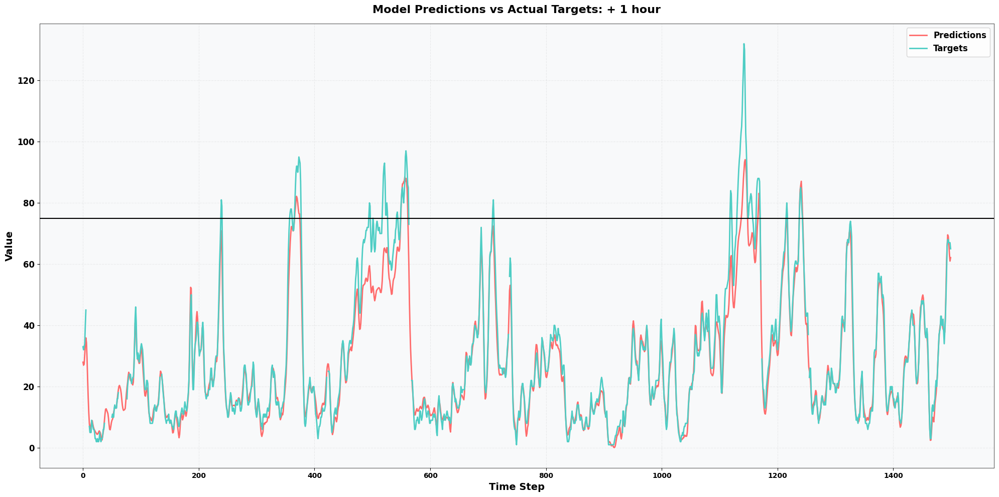

In [73]:
import matplotlib.pyplot as plt
import numpy as np


x = np.arange(500)
# Set the style
# plt.style.use('seaborn')
fig, ax = plt.subplots(figsize=(20, 10))

# Plot the data
plt.plot(predictions[500:2000, 0, 50], color='#FF6B6B', label='Predictions', linewidth=2)
plt.plot(y_test[500:2000, 0, 50], color='#4ECDC4', label='Targets', linewidth=2)
ax.axhline(y=75, color='black', linestyle='-', linewidth=1.5)
# Customize the plot with bold and larger text
plt.title('Model Predictions vs Actual Targets: + 1 hour', 
         fontsize=16, fontweight='bold', pad=15)
plt.xlabel('Time Step', fontsize=14, fontweight='bold')
plt.ylabel('Value', fontsize=14, fontweight='bold')

# Enhance the grid
plt.grid(True, linestyle='--', alpha=0.2)

# Customize the legend with bold text using prop parameter
plt.legend(prop={'size': 12, 'weight': 'bold'}, loc='upper right')

# Make tick labels bold and larger
# plt.xticks(np.arange(4320, 4320+2160, 1), fontsize=12, fontweight='bold')
plt.yticks(fontsize=12, fontweight='bold')

# Add a subtle background color
ax.set_facecolor('#f8f9fa')
fig.patch.set_facecolor('white')

# Customize the spines
for spine in ax.spines.values():
    spine.set_linewidth(0.5)

# Adjust layout to prevent label clipping
plt.tight_layout()

# Show the plot
plt.show()